### Indice

- [Grafo](#Grafo)
- [Motif](#Motif)
- [Rinomina](#Rinomina)
- [Identify](#Identify)
- [Zippa](#Zippa)
- [Pipeline gerarchica multicompressione](#Pipeline-gerarchica-multicompressione)
- [Procedura frattale](#Procedura-frattale)
- [Memorizza merge](#Memorizza-merge)
- [Indici](#Indici)

In [1]:
import collections
import networkx as nx
import matplotlib.pyplot as plt
from grandiso import find_motifs
from operator import itemgetter
from collections import defaultdict
from pathlib import Path
import time

In [2]:
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"})

In [3]:
G1 = Path(r'C:\Users\feder\Documents\GitHub\2020_Trevisan\datasets\in\bio-celegans-dir.edges')

G2 = Path(r'C:\Users\feder\Documents\GitHub\2020_Trevisan\datasets\in\bio-CE-LC.edges')

G3 = Path(r'C:\Users\feder\Documents\GitHub\2020_Trevisan\datasets\in\bio-CE-GT.edges') 

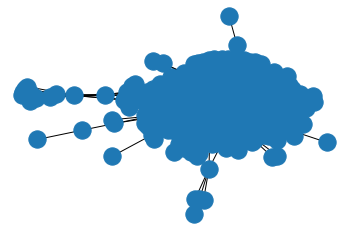

In [4]:
G1 = nx.read_weighted_edgelist(G1)
nx.draw_networkx(G1, with_labels=False)
plt.axis('off')
plt.show()

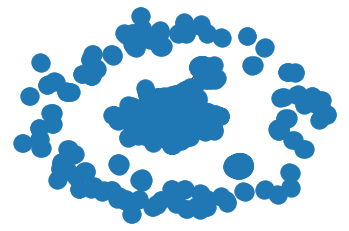

In [5]:
G2 = nx.read_weighted_edgelist(G2)
nx.draw_networkx(G2, with_labels=False)
plt.axis('off')
plt.show()

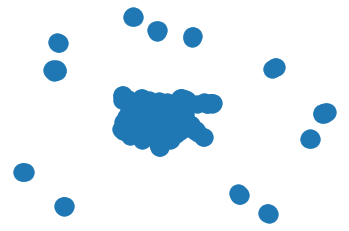

In [6]:
G3 = nx.read_weighted_edgelist(G3)
nx.draw_networkx(G3, with_labels=False)
plt.axis('off')
plt.show()

In [ ]:
%load_ext pycodestyle_magic
# %%pycodestyle

### Grafo 
[torna su](#Indice)

Grafo test di base `G`

### Motif 
[torna su](#Indice)

Sottografo `motif`

In [7]:
# Sottografo motif da trovare nel grafo G: TRIANGOLO

motif = nx.Graph()
motif.add_edges_from([(1, 2), (2, 3), (3, 1)])
# nx.draw(motif)

### Rinomina 
[torna su](#Indice)

Rinomina nodi del grafo `G` in tuple `(livello, nodo)`

In [8]:
def rinomina(G):
    livello = 0
    nodi = list(G.nodes())
    lun = len(nodi)
    liv_list = [livello for x in range(lun)]
    lista_tuple = list(zip(liv_list, nodi))
    mapping = dict(zip(nodi, lista_tuple))
    G = nx.relabel_nodes(G, mapping)

    return G

### Identify
[torna su](#Indice)

Identify `motif` in `G`

In [9]:
def identify(motif, G):
    lista1 = find_motifs(motif, G)
    if lista1 == []:
        return lista1
    else:
        lista2 = [list(d.values()) for d in lista1]
        lista3 = list(set(tuple(sorted(s)) for s in lista2))
        lista4 = sorted(lista3)
        risultato = [list(el) for el in lista4]

        return risultato

### Zippa
[torna su](#Indice)

Restituisce il mapping per la compressione

In [10]:
def zippa(results, nodes):
    # max_liv = max(results[0], key=lambda item:item[0])[0]
    max_liv = max(results[0], key=itemgetter(0))[0]
    lista_temp = []
    tri = []
    for x in nodes:
        if x in results[0]:
            # sostituisci il livello del primo nodo
            # (per comodità scelgo il primo) con il MAX+1
            x = list(x)
            x[0] = max_liv+1
            x = tuple(x)
            tri.append(x)
    if len(tri) == len(results[0]):
        for x in nodes:
            if x in results[0]:
                lista_temp.append(tri[0])
            else:
                lista_temp.append(x)
        mapping = dict(zip(nodes, lista_temp))

        return mapping

---

### Pipeline gerarchica multicompressione
[torna su](#Indice)

_versione livelli misti, non frattale_

Funzione `multicoll`:
- Output: Liste di nodi e archi da cui si ricava il grafo risultate
- Nelle compressioni multiple il livello è gestito implicitamente

In [11]:
G1 = rinomina(G1)

In [12]:
G2 = rinomina(G2)

In [13]:
G3 = rinomina(G3)

In [15]:
def multicoll(G, motif):
    liv = 1
    n, a = [], []
    # nodi G
    nodi = list(G.nodes())
    nodi.sort(key=lambda x:x[1])
    archi = list(G.edges())
    n.append(nodi)
    a.append(archi)
    while liv < 100:
        ris = identify(motif, G)
        if ris == []:
            break
        else:
            mapping = zippa(ris, nodi)
            print(mapping)
            G = nx.relabel_nodes(G, mapping)
            # togli triangolo usato
            # la lista ris diminuisce
            ris = ris[1:]
            # i nodi cambiano, sono il risultato della compressione
            nodi = list(G.nodes())
            nodi.sort(key=lambda x:x[1])
            archi = list(G.edges())
            n.append(nodi)
            a.append(archi)
            liv += 1

    tot = list(zip(n, a))
    tup = ()
    lista = []
    for x in tot:
        max_liv = max(x[0], key=itemgetter(0))[0]
        l = len(x[0])
        tup = (max_liv, l, x[0], x[1])
        lista.append(tup)

    d = defaultdict(list)
    for name, num, nod, arc in lista:
        d[name].append((num, nod, arc))

    res = list(zip(d, map(min, d.values())))
    

    return res


In [17]:
def nodes_decrease(num_nodi):
    decrease = num_nodi[0] - num_nodi[-1]
    # % decrease = decrease ÷ grafo_0 × 100
    decrease_perc = decrease / num_nodi[0] * 100
    # remain = grafo_fin
    remain = num_nodi[-1]
    # remain_perc inverso di decrease_perc
    remain_perc = 100 - decrease_perc
    #remain_perc2 = len(grafo_fin) / len(grafo_0) * 100

    return (decrease, decrease_perc, remain, remain_perc)


# Rete 1

In [16]:
start_time = time.time()
res = multicoll(G1, motif)
print("--- %s seconds ---" % (time.time() - start_time))

{(0, '1'): (1, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '101'): (0, '101'), (0, '102'): (0, '102'), (0, '103'): (0, '103'), (0, '104'): (0, '104'), (0, '105'): (0, '105'), (0, '106'): (0, '106'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '11'): (0, '11'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0,

{(1, '1'): (1, '1'), (0, '10'): (1, '10'), (0, '100'): (0, '100'), (0, '101'): (0, '101'), (0, '102'): (0, '102'), (0, '103'): (0, '103'), (0, '104'): (0, '104'), (0, '105'): (0, '105'), (0, '106'): (0, '106'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '11'): (1, '10'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (0, '100'): (1, '100'), (0, '101'): (1, '100'), (0, '102'): (0, '102'), (0, '103'): (0, '103'), (0, '104'): (0, '104'), (0, '105'): (0, '105'), (0, '106'): (0, '106'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (0, '102'): (0, '102'), (0, '103'): (1, '103'), (0, '104'): (1, '103'), (0, '105'): (0, '105'), (0, '106'): (0, '106'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (0, '105'): (1, '105'), (0, '106'): (1, '105'), (0, '107'): (1, '105'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (0, '108'): (1, '108'), (0, '109'): (1, '108'), (0, '110'): (1, '108'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (0, '111'): (1, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (0, '112'): (1, '112'), (0, '113'): (1, '112'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (0, '114'): (1, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (1, '114'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (1, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (0, '115'): (2, '100'), (0, '116'): (2, '100'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (0, '118'): (1, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (0, '119'): (1, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (0, '12'): (1, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (1, '12'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (1, '12'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0,

{(1, '1'): (1, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (0, '120'): (1, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '130'): (0, '130'), (0, '131'): (1, '120'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'),

{(1, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (0, '121'): (2, '1'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '130'): (0, '130'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (0, '122'): (1, '122'), (0, '123'): (1, '122'), (0, '124'): (1, '122'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '130'): (0, '130'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (0, '125'): (1, '125'), (0, '126'): (1, '125'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '130'): (0, '130'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (1, '125'): (2, '125'), (0, '127'): (2, '125'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '130'): (0, '130'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (1, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (0, '128'): (1, '128'), (0, '129'): (1, '128'), (0, '130'): (0, '130'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '103'): (2, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (1, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (0, '130'): (2, '103'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (2, '103'): (2, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (1, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (0, '132'): (2, '112'), (0, '133'): (2, '112'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (2, '103'): (2, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (0, '134'): (1, '134'), (0, '135'): (1, '134'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (2, '103'): (2, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (0, '136'): (1, '136'), (0, '137'): (0, '137'), (0, '138'): (1, '136'), (0, '139'): (0, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'),

{(2, '1'): (2, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (2, '103'): (2, '103'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (0, '139'): (1, '139'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (

{(2, '1'): (3, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (2, '103'): (3, '1'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (0, '140'): (3, '1'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '

{(3, '1'): (3, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (0, '141'): (1, '141'), (0, '142'): (1, '141'), (0, '143'): (0, '143'), (0, '144'): (0, '144'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (

{(3, '1'): (3, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '143'): (1, '143'), (0, '144'): (1, '143'), (0, '145'): (1, '143'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (

{(3, '1'): (3, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (0, '146'): (1, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (

{(3, '1'): (3, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (0, '147'): (1, '147'), (0, '148'): (1, '147'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (

{(3, '1'): (3, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (1, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (0, '149'): (1, '149'), (0, '150'): (1, '149'), (0, '151'): (1, '149'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (

{(3, '1'): (3, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (1, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (1, '149'): (2, '134'), (0, '152'): (2, '134'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (

{(3, '1'): (4, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (0, '153'): (4, '1'), (0, '154'): (4, '1'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '

{(4, '1'): (4, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (0, '155'): (1, '155'), (0, '156'): (1, '155'), (0, '157'): (1, '155'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '17'): (0, '17'), (0, '170'): (0, '170'), (0,

{(4, '1'): (4, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (1, '155'): (2, '155'), (0, '158'): (2, '155'), (0, '159'): (2, '155'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '17'): (0, '17'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0,

{(4, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (0, '16'): (5, '1'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '17'): (5, '1'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (0, '160'): (1, '160'), (0, '161'): (1, '160'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '176'): (0, '176'),

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (1, '160'): (1, '160'), (0, '162'): (1, '162'), (0, '163'): (1, '162'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '176'): (0, '176'), (0, '177'): (0, '177'),

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (1, '160'): (1, '160'), (1, '162'): (1, '162'), (0, '164'): (1, '164'), (0, '165'): (1, '164'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '176'): (0, '176'), (0, '177'): (0, '177'), (0, '178'): (0, '178'),

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (1, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (0, '166'): (2, '160'), (0, '167'): (2, '160'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '176'): (0, '176'), (0, '177'): (0, '177'), (0, '178'): (0, '178'), (0, '179'): (0, '179'),

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (1, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (0, '168'): (1, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '176'): (0, '176'), (0, '177'): (0, '177'), (0, '178'): (0, '178'), (0, '179'): (0, '179'), (0, '18'): (0, '18'), (0, '180'): (0, '180'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (1, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (2, '114'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (0, '169'): (2, '114'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '176'): (0, '176'), (0, '177'): (0, '177'), (0, '178'): (0, '178'), (0, '179'): (0, '179'), (0, '18'): (0, '18'), (0, '180'): (0, '180'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (1, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (0, '170'): (1, '170'), (0, '171'): (1, '170'), (0, '172'): (1, '170'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '176'): (0, '176'), (0, '177'): (0, '177'), (0, '178'): (0, '178'), (0, '179'): (0, '179'), (0, '18'): (0, '18'), (0, '180'): (0, '180'), (0, '181'): (0, '181'), (0, '182'): (0, '182'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (1, '128'): (2, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (0, '173'): (2, '128'), (0, '174'): (2, '128'), (0, '175'): (0, '175'), (0, '176'): (0, '176'), (0, '177'): (0, '177'), (0, '178'): (0, '178'), (0, '179'): (0, '179'), (0, '18'): (0, '18'), (0, '180'): (0, '180'), (0, '181'): (0, '181'), (0, '182'): (0, '182'), (0, '183'): (0, '183'), (0, '184'): (0, '184'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (0, '175'): (1, '175'), (0, '176'): (1, '175'), (0, '177'): (0, '177'), (0, '178'): (0, '178'), (0, '179'): (1, '175'), (0, '18'): (0, '18'), (0, '180'): (0, '180'), (0, '181'): (0, '181'), (0, '182'): (0, '182'), (0, '183'): (0, '183'), (0, '184'): (0, '184'), (0, '185'): (0, '185'), (0, '186'): (0, '186'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (1, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (1, '175'): (1, '175'), (0, '177'): (1, '177'), (0, '178'): (1, '177'), (0, '18'): (0, '18'), (0, '180'): (1, '177'), (0, '181'): (0, '181'), (0, '182'): (0, '182'), (0, '183'): (0, '183'), (0, '184'): (0, '184'), (0, '185'): (0, '185'), (0, '186'): (0, '186'), (0, '187'): (0, '187'), (0, '188'): (0, '188'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (1, '12'): (2, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (1, '175'): (1, '175'), (1, '177'): (1, '177'), (0, '18'): (2, '12'), (0, '181'): (0, '181'), (0, '182'): (0, '182'), (0, '183'): (0, '183'), (0, '184'): (0, '184'), (0, '185'): (0, '185'), (0, '186'): (0, '186'), (0, '187'): (0, '187'), (0, '188'): (0, '188'), (0, '189'): (0, '189'), (0, '19'): (0, '19'), (0,

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (2, '12'): (2, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (2, '134'): (2, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (1, '175'): (2, '175'), (1, '177'): (2, '175'), (0, '181'): (2, '175'), (0, '182'): (0, '182'), (0, '183'): (0, '183'), (0, '184'): (0, '184'), (0, '185'): (0, '185'), (0, '186'): (0, '186'), (0, '187'): (0, '187'), (0, '188'): (0, '188'), (0, '189'): (0, '189'), (0, '19'): (0, '19'), (0, '190'): (0, '190'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (2, '12'): (2, '12'), (1, '120'): (1, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (2, '134'): (3, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (0, '182'): (3, '134'), (0, '183'): (0, '183'), (0, '184'): (0, '184'), (0, '185'): (0, '185'), (0, '186'): (0, '186'), (0, '187'): (0, '187'), (0, '188'): (0, '188'), (0, '189'): (0, '189'), (0, '19'): (0, '19'), (0, '190'): (0, '190'), (0, '191'): (0, '191'), (0, '192'): (3, '134'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (2, '12'): (2, '12'), (1, '120'): (2, '120'), (1, '122'): (1, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (3, '134'): (3, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (0, '183'): (2, '120'), (0, '184'): (2, '120'), (0, '185'): (0, '185'), (0, '186'): (0, '186'), (0, '187'): (0, '187'), (0, '188'): (0, '188'), (0, '189'): (0, '189'), (0, '19'): (0, '19'), (0, '190'): (0, '190'), (0, '191'): (0, '191'), (0, '193'): (0, '193'), (0, '194'): (0, '194'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (1, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (1, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (3, '134'): (3, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (0, '185'): (2, '122'), (0, '186'): (0, '186'), (0, '187'): (0, '187'), (0, '188'): (0, '188'), (0, '189'): (0, '189'), (0, '19'): (0, '19'), (0, '190'): (0, '190'), (0, '191'): (0, '191'), (0, '193'): (0, '193'), (0, '194'): (0, '194'), (0, '195'): (0, '195'), (0, '196'): (0, '196'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (1, '119'): (2, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (3, '134'): (3, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (0, '186'): (2, '119'), (0, '187'): (2, '119'), (0, '188'): (0, '188'), (0, '189'): (0, '189'), (0, '19'): (0, '19'), (0, '190'): (0, '190'), (0, '191'): (0, '191'), (0, '193'): (0, '193'), (0, '194'): (0, '194'), (0, '195'): (0, '195'), (0, '196'): (0, '196'), (0, '197'): (0, '197'), (

{(5, '1'): (5, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (2, '119'): (3, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (3, '134'): (3, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (0, '188'): (3, '119'), (0, '189'): (3, '119'), (0, '19'): (0, '19'), (0, '190'): (0, '190'), (0, '191'): (0, '191'), (0, '193'): (0, '193'), (0, '194'): (0, '194'), (0, '195'): (0, '195'), (0, '196'): (0, '196'), (0, '197'): (0, '197'), (0, '198'): (0, '198'), (0, '199'): (0, '199'), (

{(5, '1'): (6, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (3, '119'): (3, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (3, '134'): (3, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (0, '19'): (6, '1'), (0, '190'): (0, '190'), (0, '191'): (0, '191'), (0, '193'): (0, '193'), (0, '194'): (0, '194'), (0, '195'): (0, '195'), (0, '196'): (0, '196'), (0, '197'): (0, '197'), (0, '198'): (0, '198'), (0, '199'): (0, '199'), (0, '20'): (6, '1'), (0, '200'): (0, '200'), (0, '

{(6, '1'): (6, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (3, '119'): (3, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (3, '134'): (3, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (0, '190'): (1, '190'), (0, '191'): (1, '190'), (0, '193'): (0, '193'), (0, '194'): (0, '194'), (0, '195'): (0, '195'), (0, '196'): (0, '196'), (0, '197'): (0, '197'), (0, '198'): (0, '198'), (0, '199'): (0, '199'), (0, '200'): (0, '200'), (0, '201'): (0, '201'), (0, '203'): (0, '203'),

{(6, '1'): (6, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (3, '119'): (3, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (4, '134'): (5, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '194'): (5, '134'), (0, '195'): (5, '134'), (0, '196'): (0, '196'), (0, '197'): (0, '197'), (0, '198'): (0, '198'), (0, '199'): (0, '199'), (0, '200'): (0, '200'), (0, '201'): (0, '201'), (0, '203'): (0, '203'), (0, '204'): (0, '204'), (0, '205'): (0, '205'),

{(6, '1'): (6, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (4, '119'): (4, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (5, '134'): (6, '134'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '198'): (6, '134'), (0, '199'): (6, '134'), (0, '200'): (0, '200'), (0, '201'): (0, '201'), (0, '203'): (0, '203'), (0, '204'): (0, '204'), (0, '205'): (0, '205'), (0, '206'): (0, '206'), (0, '207'): (0, '207'), (0, '208'): (0, '208'), (0, '209'): (0, '209'),

{(7, '1'): (7, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (4, '119'): (5, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (5, '119'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '201'): (5, '119'), (0, '203'): (0, '203'), (0, '204'): (0, '204'), (0, '205'): (0, '205'), (0, '206'): (0, '206'), (0, '207'): (0, '207'), (0, '208'): (0, '208'), (0, '209'): (0, '209'), (0, '21'): (0, '21'), (0, '211'): (0, '211'), (0, '212'): (0, '212'), (0, '213'): (0, '213'), (

{(7, '1'): (8, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (1, '111'): (1, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (2, '12'): (2, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '205'): (8, '1'), (0, '206'): (8, '1'), (0, '207'): (0, '207'), (0, '208'): (0, '208'), (0, '209'): (0, '209'), (0, '21'): (0, '21'), (0, '211'): (0, '211'), (0, '212'): (0, '212'), (0, '213'): (0, '213'), (0, '215'): (0, '215'), (0, '216'): (0, '216'), (0, '217'): (0, '217'), (0, '218'): (0, '218'), (0, '

{(8, '1'): (8, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (2, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (0, '21'): (3, '12'), (0, '211'): (0, '211'), (0, '212'): (0, '212'), (0, '213'): (0, '213'), (0, '215'): (0, '215'), (0, '216'): (0, '216'), (0, '217'): (0, '217'), (0, '218'): (0, '218'), (0, '219'): (0, '219'), (0, '22'): (0, '22'), (0, '220'): (0, '220'), (0, '221'): (0, '221'), (0,

{(8, '1'): (8, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (3, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (0, '215'): (1, '215'), (0, '216'): (0, '216'), (0, '217'): (0, '217'), (0, '218'): (0, '218'), (0, '219'): (0, '219'), (0, '22'): (0, '22'), (0, '220'): (0, '220'), (0, '221'): (0, '221'), (0, '222'): (0, '222'), (0, '223'): (0, '223'), (0, '224'): (0, '224'), (

{(8, '1'): (8, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (3, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (1, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (1, '216'): (1, '216'), (0, '219'): (1, '219'), (0, '22'): (0, '22'), (0, '220'): (1, '219'), (0, '221'): (1, '219'), (0, '222'): (0, '222'), (0, '223'): (0, '223'), (0, '224'): (0, '224'), (0, '225'): (0, '225'), (0, '226'): (0, '226'), (

{(9, '1'): (9, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (3, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (1, '147'): (2, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (1, '216'): (1, '216'), (1, '219'): (1, '219'), (0, '222'): (2, '147'), (0, '223'): (2, '147'), (0, '224'): (0, '224'), (0, '225'): (0, '225'), (0, '226'): (0, '226'), (0, '227'): (0, '227'), (0, '228'): (0, '228'), (0, '229'): (0, '229'),

{(9, '1'): (9, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (3, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (2, '147'): (2, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (1, '216'): (1, '216'), (2, '219'): (2, '219'), (0, '226'): (1, '226'), (0, '227'): (1, '226'), (0, '228'): (1, '226'), (0, '229'): (0, '229'), (0, '230'): (0, '230'), (0, '231'): (0, '231'), (0, '235'): (0, '235'), (0, '236'): (0, '236'),

{(9, '1'): (9, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (3, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (2, '147'): (2, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (1, '216'): (1, '216'), (2, '219'): (2, '219'), (1, '226'): (2, '226'), (1, '229'): (2, '226'), (0, '231'): (2, '226'), (0, '235'): (0, '235'), (0, '236'): (0, '236'), (0, '237'): (0, '237'), (0, '238'): (0, '238'), (0, '239'): (0, '239'),

{(9, '1'): (9, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (3, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (2, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (1, '216'): (3, '147'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '235'): (1, '235'), (0, '236'): (3, '147'), (0, '237'): (0, '237'), (0, '238'): (0, '238'), (0, '239'): (0, '239'), (0, '24'): (0, '24'), (0, '240'): (0, '240'), (

{(10, '1'): (11, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (3, '12'): (3, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (2, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '235'): (1, '235'), (0, '239'): (11, '1'), (0, '24'): (0, '24'), (0, '240'): (11, '1'), (0, '241'): (0, '241'), (0, '242'): (0, '242'), (0, '243'): (0, '243'), (0, '246'): (0, '246'), (

{(11, '1'): (11, '1'), (1, '10'): (1, '10'), (2, '100'): (2, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (2, '111'): (2, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (2, '125'): (3, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '235'): (1, '235'), (0, '241'): (3, '125'), (0, '242'): (3, '125'), (0, '243'): (0, '243'), (0, '246'): (0, '246'), (0, '247'): (0, '247'), (0, '248'): (0, '248'), (0, '249'): (0, '249'

{(11, '1'): (11, '1'), (1, '10'): (1, '10'), (2, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '235'): (3, '100'), (0, '246'): (3, '100'), (0, '247'): (0, '247'), (0, '248'): (0, '248'), (0, '249'): (0, '249'), (0, '25'): (0, '25'), (0, '250'): (0, '250'), (0, '251'): (0, '251'),

{(12, '1'): (13, '1'), (1, '10'): (1, '10'), (3, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (0, '249'): (13, '1'), (0, '25'): (0, '25'), (0, '250'): (0, '250'), (0, '251'): (0, '251'), (0, '252'): (0, '252'), (0, '253'): (13, '1'), (0, '254'): (0, '254'), (0, '255'): (0, '255'), (

{(13, '1'): (13, '1'), (1, '10'): (1, '10'), (3, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (2, '112'): (2, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '25'): (1, '25'), (0, '250'): (1, '250'), (0, '251'): (1, '250'), (0, '252'): (1, '250'), (0, '254'): (0, '254'), (0, '255'): (0, '255'), (0, '256'): (0, '256'), (0, '257'): (0, '257'),

{(13, '1'): (13, '1'), (1, '10'): (1, '10'), (3, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (3, '112'): (3, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (1, '168'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '25'): (1, '25'), (0, '255'): (1, '255'), (0, '256'): (1, '255'), (0, '257'): (1, '255'), (0, '258'): (0, '258'), (0, '259'): (0, '259'), (0, '260'): (0, '260'), (0, '261'): (0, '261'),

{(13, '1'): (13, '1'), (1, '10'): (2, '10'), (3, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (3, '112'): (3, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '168'): (2, '10'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '25'): (1, '25'), (1, '255'): (1, '255'), (1, '258'): (1, '258'), (0, '261'): (2, '10'), (0, '262'): (0, '262'), (0, '263'): (0, '263'), (0, '264'): (0, '264'), (0, '265'): (0, '265'), (

{(13, '1'): (13, '1'), (3, '10'): (3, '10'), (3, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (3, '112'): (3, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (1, '162'): (1, '162'), (1, '164'): (1, '164'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '25'): (1, '25'), (1, '255'): (1, '255'), (1, '258'): (1, '258'), (0, '263'): (1, '263'), (0, '264'): (1, '263'), (0, '265'): (1, '263'), (0, '266'): (0, '266'), (0, '267'): (0, '267'), (0, '268'): (0, '268'), (0, '269'): (0, '269'),

{(13, '1'): (14, '1'), (3, '10'): (3, '10'), (3, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (3, '112'): (3, '112'), (2, '114'): (2, '114'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (2, '162'): (2, '162'), (1, '164'): (1, '164'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '25'): (1, '25'), (1, '255'): (1, '255'), (1, '258'): (1, '258'), (1, '263'): (1, '263'), (0, '267'): (14, '1'), (0, '268'): (0, '268'), (0, '269'): (0, '269'), (0, '270'): (0, '270'), (0, '271'): (0, '271'), (0, '272'): (0, '272'), 

{(14, '1'): (14, '1'), (3, '10'): (3, '10'), (3, '100'): (3, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (3, '112'): (4, '112'), (3, '114'): (4, '112'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (2, '162'): (2, '162'), (1, '164'): (1, '164'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '25'): (1, '25'), (1, '255'): (1, '255'), (1, '258'): (1, '258'), (1, '263'): (1, '263'), (0, '270'): (4, '112'), (0, '271'): (0, '271'), (0, '272'): (0, '272'), (0, '273'): (0, '273'), (0, '274'): (0, '274'), (0, '275'): (0, '275'),

{(14, '1'): (14, '1'), (4, '10'): (4, '10'), (3, '100'): (4, '100'), (0, '102'): (0, '102'), (1, '105'): (1, '105'), (1, '108'): (1, '108'), (3, '111'): (3, '111'), (4, '112'): (4, '112'), (1, '118'): (1, '118'), (6, '119'): (6, '119'), (4, '12'): (4, '12'), (2, '120'): (2, '120'), (2, '122'): (2, '122'), (3, '125'): (3, '125'), (2, '128'): (2, '128'), (0, '137'): (0, '137'), (1, '143'): (1, '143'), (1, '146'): (1, '146'), (3, '147'): (3, '147'), (2, '155'): (2, '155'), (2, '160'): (2, '160'), (2, '162'): (2, '162'), (1, '164'): (1, '164'), (1, '170'): (1, '170'), (2, '175'): (2, '175'), (1, '190'): (1, '190'), (0, '207'): (0, '207'), (1, '211'): (1, '211'), (1, '215'): (1, '215'), (2, '219'): (2, '219'), (2, '226'): (2, '226'), (1, '25'): (1, '25'), (1, '255'): (1, '255'), (1, '258'): (1, '258'), (1, '263'): (1, '263'), (0, '272'): (0, '272'), (0, '274'): (4, '100'), (0, '275'): (4, '100'), (0, '276'): (0, '276'), (0, '279'): (0, '279'), (0, '28'): (0, '28'), (0, '280'): (0, '280'), (

--- 46.13754081726074 seconds ---


In [18]:
res

[(0,
  (453,
   [(0, '1'),
    (0, '10'),
    (0, '100'),
    (0, '101'),
    (0, '102'),
    (0, '103'),
    (0, '104'),
    (0, '105'),
    (0, '106'),
    (0, '107'),
    (0, '108'),
    (0, '109'),
    (0, '11'),
    (0, '110'),
    (0, '111'),
    (0, '112'),
    (0, '113'),
    (0, '114'),
    (0, '115'),
    (0, '116'),
    (0, '117'),
    (0, '118'),
    (0, '119'),
    (0, '12'),
    (0, '120'),
    (0, '121'),
    (0, '122'),
    (0, '123'),
    (0, '124'),
    (0, '125'),
    (0, '126'),
    (0, '127'),
    (0, '128'),
    (0, '129'),
    (0, '13'),
    (0, '130'),
    (0, '131'),
    (0, '132'),
    (0, '133'),
    (0, '134'),
    (0, '135'),
    (0, '136'),
    (0, '137'),
    (0, '138'),
    (0, '139'),
    (0, '14'),
    (0, '140'),
    (0, '141'),
    (0, '142'),
    (0, '143'),
    (0, '144'),
    (0, '145'),
    (0, '146'),
    (0, '147'),
    (0, '148'),
    (0, '149'),
    (0, '15'),
    (0, '150'),
    (0, '151'),
    (0, '152'),
    (0, '153'),
    (0, '154'),
   

In [19]:
# res = multicoll(G0, motif)
livello, num_nodi, nodi, archi = [], [], [], []
for i in res:
    livello.append(i[0])
    num_nodi.append(i[1][0])
    nodi.append(i[1][1])
    archi.append(i[1][2])

print("Livello: ", livello, "\n# nodi: ", num_nodi,
      "\nNodi: ", nodi, "\nArchi: ", archi, "\n\n")

Livello:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] 
# nodi:  [453, 435, 405, 391, 385, 349, 337, 331, 317, 301, 299, 289, 287, 267, 255] 
Nodi:  [[(0, '1'), (0, '10'), (0, '100'), (0, '101'), (0, '102'), (0, '103'), (0, '104'), (0, '105'), (0, '106'), (0, '107'), (0, '108'), (0, '109'), (0, '11'), (0, '110'), (0, '111'), (0, '112'), (0, '113'), (0, '114'), (0, '115'), (0, '116'), (0, '117'), (0, '118'), (0, '119'), (0, '12'), (0, '120'), (0, '121'), (0, '122'), (0, '123'), (0, '124'), (0, '125'), (0, '126'), (0, '127'), (0, '128'), (0, '129'), (0, '13'), (0, '130'), (0, '131'), (0, '132'), (0, '133'), (0, '134'), (0, '135'), (0, '136'), (0, '137'), (0, '138'), (0, '139'), (0, '14'), (0, '140'), (0, '141'), (0, '142'), (0, '143'), (0, '144'), (0, '145'), (0, '146'), (0, '147'), (0, '148'), (0, '149'), (0, '15'), (0, '150'), (0, '151'), (0, '152'), (0, '153'), (0, '154'), (0, '155'), (0, '156'), (0, '157'), (0, '158'), (0, '159'), (0, '16'), (0, '160'), (0, '161'), (0, '162'), 

In [20]:
for i in res:
    print("Livello: ", i[0], "\n# nodi: ", i[1][0], "\nNodi: ",
          i[1][1], "\n\n")

Livello:  0 
# nodi:  453 
Nodi:  [(0, '1'), (0, '10'), (0, '100'), (0, '101'), (0, '102'), (0, '103'), (0, '104'), (0, '105'), (0, '106'), (0, '107'), (0, '108'), (0, '109'), (0, '11'), (0, '110'), (0, '111'), (0, '112'), (0, '113'), (0, '114'), (0, '115'), (0, '116'), (0, '117'), (0, '118'), (0, '119'), (0, '12'), (0, '120'), (0, '121'), (0, '122'), (0, '123'), (0, '124'), (0, '125'), (0, '126'), (0, '127'), (0, '128'), (0, '129'), (0, '13'), (0, '130'), (0, '131'), (0, '132'), (0, '133'), (0, '134'), (0, '135'), (0, '136'), (0, '137'), (0, '138'), (0, '139'), (0, '14'), (0, '140'), (0, '141'), (0, '142'), (0, '143'), (0, '144'), (0, '145'), (0, '146'), (0, '147'), (0, '148'), (0, '149'), (0, '15'), (0, '150'), (0, '151'), (0, '152'), (0, '153'), (0, '154'), (0, '155'), (0, '156'), (0, '157'), (0, '158'), (0, '159'), (0, '16'), (0, '160'), (0, '161'), (0, '162'), (0, '163'), (0, '164'), (0, '165'), (0, '166'), (0, '167'), (0, '168'), (0, '169'), (0, '17'), (0, '170'), (0, '171'), (0,

[((0, '1'), (0, '2')), ((0, '1'), (0, '3')), ((0, '1'), (0, '4')), ((0, '1'), (0, '5')), ((0, '2'), (0, '3')), ((0, '2'), (0, '4')), ((0, '2'), (0, '5')), ((0, '2'), (0, '12')), ((0, '2'), (0, '37')), ((0, '2'), (0, '26')), ((0, '2'), (0, '38')), ((0, '2'), (0, '82')), ((0, '2'), (0, '13')), ((0, '2'), (0, '95')), ((0, '2'), (0, '96')), ((0, '2'), (0, '97')), ((0, '2'), (0, '98')), ((0, '2'), (0, '56')), ((0, '2'), (0, '99')), ((0, '2'), (0, '108')), ((0, '2'), (0, '2')), ((0, '2'), (0, '51')), ((0, '2'), (0, '112')), ((0, '2'), (0, '113')), ((0, '2'), (0, '114')), ((0, '2'), (0, '117')), ((0, '2'), (0, '118')), ((0, '2'), (0, '115')), ((0, '2'), (0, '87')), ((0, '2'), (0, '86')), ((0, '2'), (0, '15')), ((0, '2'), (0, '121')), ((0, '2'), (0, '131')), ((0, '2'), (0, '57')), ((0, '2'), (0, '130')), ((0, '2'), (0, '132')), ((0, '2'), (0, '134')), ((0, '2'), (0, '135')), ((0, '2'), (0, '140')), ((0, '2'), (0, '147')), ((0, '2'), (0, '148')), ((0, '2'), (0, '150')), ((0, '2'), (0, '152')), 

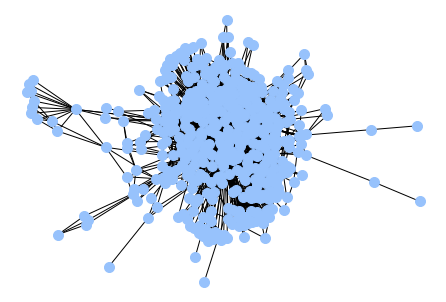

[((1, '1'), (1, '1')), ((1, '1'), (0, '4')), ((1, '1'), (1, '112')), ((1, '1'), (0, '12')), ((1, '1'), (0, '37')), ((1, '1'), (0, '26')), ((1, '1'), (1, '100')), ((1, '1'), (0, '82')), ((1, '1'), (0, '13')), ((1, '1'), (0, '95')), ((1, '1'), (0, '96')), ((1, '1'), (0, '97')), ((1, '1'), (0, '98')), ((1, '1'), (0, '56')), ((1, '1'), (0, '99')), ((1, '1'), (1, '108')), ((1, '1'), (1, '114')), ((1, '1'), (0, '118')), ((1, '1'), (0, '115')), ((1, '1'), (0, '87')), ((1, '1'), (0, '86')), ((1, '1'), (1, '103')), ((1, '1'), (0, '121')), ((1, '1'), (0, '131')), ((1, '1'), (0, '57')), ((1, '1'), (0, '130')), ((1, '1'), (0, '132')), ((1, '1'), (0, '134')), ((1, '1'), (0, '135')), ((1, '1'), (0, '140')), ((1, '1'), (0, '147')), ((1, '1'), (0, '148')), ((1, '1'), (0, '150')), ((1, '1'), (0, '152')), ((1, '1'), (0, '182')), ((1, '1'), (0, '58')), ((1, '1'), (0, '183')), ((1, '1'), (0, '184')), ((1, '1'), (0, '185')), ((1, '1'), (0, '192')), ((1, '1'), (0, '194')), ((1, '1'), (0, '195')), ((1, '1'),

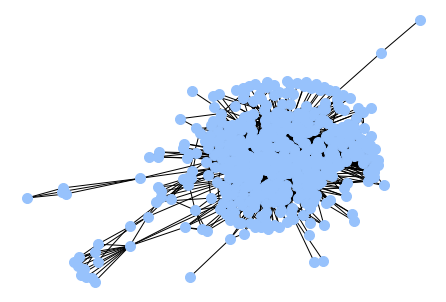

[((2, '1'), (2, '1')), ((2, '1'), (2, '112')), ((2, '1'), (1, '12')), ((2, '1'), (0, '37')), ((2, '1'), (0, '26')), ((2, '1'), (2, '100')), ((2, '1'), (1, '119')), ((2, '1'), (0, '95')), ((2, '1'), (0, '96')), ((2, '1'), (1, '134')), ((2, '1'), (0, '98')), ((2, '1'), (0, '56')), ((2, '1'), (0, '99')), ((2, '1'), (1, '108')), ((2, '1'), (1, '114')), ((2, '1'), (1, '118')), ((2, '1'), (0, '87')), ((2, '1'), (0, '86')), ((2, '1'), (2, '103')), ((2, '1'), (1, '120')), ((2, '1'), (0, '140')), ((2, '1'), (0, '147')), ((2, '1'), (0, '148')), ((2, '1'), (0, '150')), ((2, '1'), (0, '152')), ((2, '1'), (0, '182')), ((2, '1'), (0, '183')), ((2, '1'), (0, '184')), ((2, '1'), (0, '185')), ((2, '1'), (0, '192')), ((2, '1'), (0, '194')), ((2, '1'), (0, '195')), ((2, '1'), (0, '198')), ((2, '1'), (0, '199')), ((2, '1'), (0, '200')), ((2, '1'), (0, '201')), ((2, '1'), (0, '203')), ((2, '1'), (1, '139')), ((2, '1'), (0, '205')), ((2, '1'), (0, '206')), ((2, '1'), (0, '207')), ((2, '1'), (0, '237')), ((2

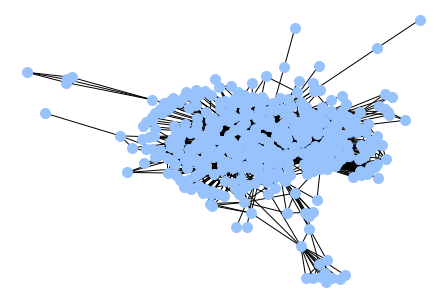

[((3, '1'), (3, '1')), ((3, '1'), (2, '112')), ((3, '1'), (1, '12')), ((3, '1'), (0, '37')), ((3, '1'), (0, '26')), ((3, '1'), (2, '100')), ((3, '1'), (1, '119')), ((3, '1'), (0, '95')), ((3, '1'), (0, '96')), ((3, '1'), (2, '134')), ((3, '1'), (0, '98')), ((3, '1'), (0, '56')), ((3, '1'), (0, '99')), ((3, '1'), (1, '108')), ((3, '1'), (1, '114')), ((3, '1'), (1, '118')), ((3, '1'), (0, '87')), ((3, '1'), (0, '86')), ((3, '1'), (1, '120')), ((3, '1'), (1, '147')), ((3, '1'), (0, '182')), ((3, '1'), (0, '183')), ((3, '1'), (0, '184')), ((3, '1'), (0, '185')), ((3, '1'), (0, '192')), ((3, '1'), (0, '194')), ((3, '1'), (0, '195')), ((3, '1'), (0, '198')), ((3, '1'), (0, '199')), ((3, '1'), (0, '200')), ((3, '1'), (0, '201')), ((3, '1'), (0, '203')), ((3, '1'), (1, '139')), ((3, '1'), (0, '205')), ((3, '1'), (0, '206')), ((3, '1'), (0, '207')), ((3, '1'), (0, '237')), ((3, '1'), (0, '238')), ((3, '1'), (0, '243')), ((3, '1'), (0, '245')), ((3, '1'), (0, '246')), ((3, '1'), (0, '249')), ((3

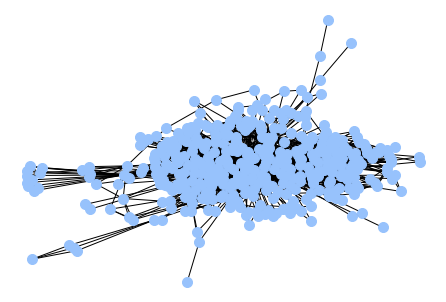

[((4, '1'), (4, '1')), ((4, '1'), (2, '112')), ((4, '1'), (1, '12')), ((4, '1'), (0, '37')), ((4, '1'), (0, '26')), ((4, '1'), (2, '100')), ((4, '1'), (1, '119')), ((4, '1'), (0, '95')), ((4, '1'), (0, '96')), ((4, '1'), (2, '134')), ((4, '1'), (0, '98')), ((4, '1'), (0, '56')), ((4, '1'), (0, '99')), ((4, '1'), (1, '108')), ((4, '1'), (1, '114')), ((4, '1'), (1, '118')), ((4, '1'), (0, '87')), ((4, '1'), (0, '86')), ((4, '1'), (1, '120')), ((4, '1'), (1, '147')), ((4, '1'), (0, '182')), ((4, '1'), (0, '183')), ((4, '1'), (0, '184')), ((4, '1'), (0, '185')), ((4, '1'), (0, '192')), ((4, '1'), (0, '194')), ((4, '1'), (0, '195')), ((4, '1'), (0, '198')), ((4, '1'), (0, '199')), ((4, '1'), (0, '200')), ((4, '1'), (0, '201')), ((4, '1'), (0, '203')), ((4, '1'), (1, '139')), ((4, '1'), (0, '205')), ((4, '1'), (0, '206')), ((4, '1'), (0, '207')), ((4, '1'), (0, '237')), ((4, '1'), (0, '238')), ((4, '1'), (0, '243')), ((4, '1'), (0, '245')), ((4, '1'), (0, '246')), ((4, '1'), (0, '249')), ((4

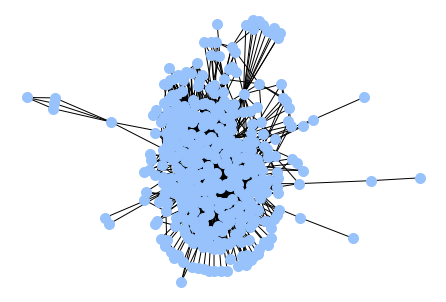

[((5, '1'), (5, '1')), ((5, '1'), (2, '112')), ((5, '1'), (2, '12')), ((5, '1'), (0, '37')), ((5, '1'), (0, '26')), ((5, '1'), (2, '100')), ((5, '1'), (3, '119')), ((5, '1'), (0, '95')), ((5, '1'), (0, '96')), ((5, '1'), (3, '134')), ((5, '1'), (0, '98')), ((5, '1'), (1, '162')), ((5, '1'), (0, '99')), ((5, '1'), (1, '108')), ((5, '1'), (2, '114')), ((5, '1'), (1, '118')), ((5, '1'), (0, '87')), ((5, '1'), (0, '86')), ((5, '1'), (2, '120')), ((5, '1'), (1, '147')), ((5, '1'), (2, '122')), ((5, '1'), (0, '194')), ((5, '1'), (0, '195')), ((5, '1'), (0, '198')), ((5, '1'), (0, '199')), ((5, '1'), (0, '200')), ((5, '1'), (0, '201')), ((5, '1'), (0, '203')), ((5, '1'), (1, '139')), ((5, '1'), (0, '205')), ((5, '1'), (0, '206')), ((5, '1'), (0, '207')), ((5, '1'), (0, '237')), ((5, '1'), (0, '238')), ((5, '1'), (0, '243')), ((5, '1'), (0, '245')), ((5, '1'), (0, '246')), ((5, '1'), (0, '249')), ((5, '1'), (0, '253')), ((5, '1'), (0, '264')), ((5, '1'), (2, '160')), ((5, '1'), (0, '268')), ((

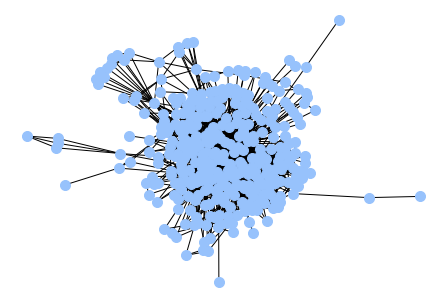

[((6, '1'), (6, '1')), ((6, '1'), (2, '112')), ((6, '1'), (2, '12')), ((6, '1'), (0, '37')), ((6, '1'), (0, '26')), ((6, '1'), (2, '100')), ((6, '1'), (4, '119')), ((6, '1'), (0, '95')), ((6, '1'), (0, '96')), ((6, '1'), (6, '134')), ((6, '1'), (0, '98')), ((6, '1'), (1, '162')), ((6, '1'), (0, '99')), ((6, '1'), (1, '108')), ((6, '1'), (2, '114')), ((6, '1'), (1, '118')), ((6, '1'), (0, '87')), ((6, '1'), (0, '86')), ((6, '1'), (2, '120')), ((6, '1'), (1, '147')), ((6, '1'), (2, '122')), ((6, '1'), (0, '200')), ((6, '1'), (0, '201')), ((6, '1'), (0, '203')), ((6, '1'), (1, '139')), ((6, '1'), (0, '205')), ((6, '1'), (0, '206')), ((6, '1'), (0, '207')), ((6, '1'), (0, '237')), ((6, '1'), (0, '238')), ((6, '1'), (0, '243')), ((6, '1'), (0, '245')), ((6, '1'), (0, '246')), ((6, '1'), (0, '249')), ((6, '1'), (0, '253')), ((6, '1'), (0, '264')), ((6, '1'), (2, '160')), ((6, '1'), (0, '268')), ((6, '1'), (0, '269')), ((6, '1'), (0, '270')), ((6, '1'), (0, '287')), ((6, '1'), (0, '288')), ((

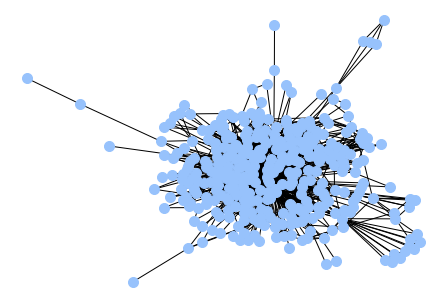

[((7, '1'), (7, '1')), ((7, '1'), (2, '112')), ((7, '1'), (2, '12')), ((7, '1'), (0, '37')), ((7, '1'), (0, '26')), ((7, '1'), (2, '100')), ((7, '1'), (6, '119')), ((7, '1'), (0, '95')), ((7, '1'), (0, '96')), ((7, '1'), (0, '98')), ((7, '1'), (1, '162')), ((7, '1'), (0, '99')), ((7, '1'), (1, '108')), ((7, '1'), (2, '114')), ((7, '1'), (1, '118')), ((7, '1'), (0, '87')), ((7, '1'), (0, '86')), ((7, '1'), (2, '120')), ((7, '1'), (1, '147')), ((7, '1'), (2, '122')), ((7, '1'), (0, '205')), ((7, '1'), (0, '206')), ((7, '1'), (0, '207')), ((7, '1'), (0, '237')), ((7, '1'), (0, '238')), ((7, '1'), (0, '243')), ((7, '1'), (0, '245')), ((7, '1'), (0, '246')), ((7, '1'), (0, '249')), ((7, '1'), (0, '253')), ((7, '1'), (0, '264')), ((7, '1'), (2, '160')), ((7, '1'), (0, '268')), ((7, '1'), (0, '269')), ((7, '1'), (0, '270')), ((7, '1'), (0, '287')), ((7, '1'), (0, '288')), ((7, '1'), (0, '267')), ((7, '1'), (0, '298')), ((7, '1'), (0, '251')), ((7, '1'), (0, '302')), ((7, '1'), (0, '278')), ((

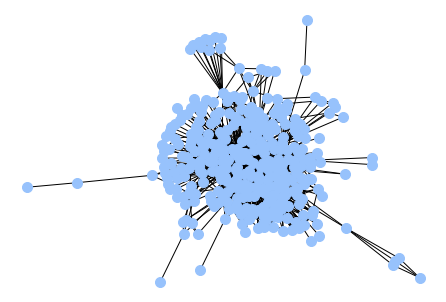

[((8, '1'), (8, '1')), ((8, '1'), (2, '112')), ((8, '1'), (3, '12')), ((8, '1'), (0, '37')), ((8, '1'), (0, '26')), ((8, '1'), (2, '100')), ((8, '1'), (6, '119')), ((8, '1'), (0, '95')), ((8, '1'), (0, '96')), ((8, '1'), (0, '98')), ((8, '1'), (1, '162')), ((8, '1'), (0, '99')), ((8, '1'), (1, '108')), ((8, '1'), (2, '114')), ((8, '1'), (1, '118')), ((8, '1'), (0, '87')), ((8, '1'), (0, '86')), ((8, '1'), (2, '120')), ((8, '1'), (1, '147')), ((8, '1'), (2, '122')), ((8, '1'), (0, '207')), ((8, '1'), (0, '237')), ((8, '1'), (0, '238')), ((8, '1'), (0, '243')), ((8, '1'), (0, '245')), ((8, '1'), (0, '246')), ((8, '1'), (0, '249')), ((8, '1'), (0, '253')), ((8, '1'), (0, '264')), ((8, '1'), (2, '160')), ((8, '1'), (0, '268')), ((8, '1'), (0, '269')), ((8, '1'), (0, '270')), ((8, '1'), (0, '287')), ((8, '1'), (0, '288')), ((8, '1'), (0, '267')), ((8, '1'), (0, '298')), ((8, '1'), (0, '251')), ((8, '1'), (0, '302')), ((8, '1'), (0, '278')), ((8, '1'), (0, '301')), ((8, '1'), (0, '62')), ((8

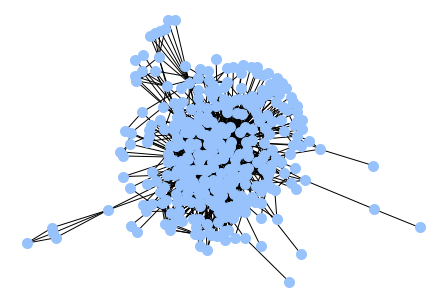

[((9, '1'), (9, '1')), ((9, '1'), (2, '112')), ((9, '1'), (3, '12')), ((9, '1'), (0, '37')), ((9, '1'), (0, '26')), ((9, '1'), (2, '100')), ((9, '1'), (6, '119')), ((9, '1'), (0, '95')), ((9, '1'), (0, '96')), ((9, '1'), (0, '98')), ((9, '1'), (1, '162')), ((9, '1'), (0, '99')), ((9, '1'), (1, '108')), ((9, '1'), (2, '114')), ((9, '1'), (1, '118')), ((9, '1'), (0, '87')), ((9, '1'), (2, '226')), ((9, '1'), (2, '120')), ((9, '1'), (3, '147')), ((9, '1'), (2, '122')), ((9, '1'), (0, '207')), ((9, '1'), (0, '237')), ((9, '1'), (0, '238')), ((9, '1'), (0, '243')), ((9, '1'), (1, '235')), ((9, '1'), (0, '246')), ((9, '1'), (0, '249')), ((9, '1'), (0, '253')), ((9, '1'), (0, '264')), ((9, '1'), (2, '160')), ((9, '1'), (0, '268')), ((9, '1'), (0, '269')), ((9, '1'), (0, '270')), ((9, '1'), (0, '287')), ((9, '1'), (0, '288')), ((9, '1'), (0, '267')), ((9, '1'), (0, '298')), ((9, '1'), (0, '251')), ((9, '1'), (0, '302')), ((9, '1'), (0, '278')), ((9, '1'), (0, '301')), ((9, '1'), (0, '62')), ((

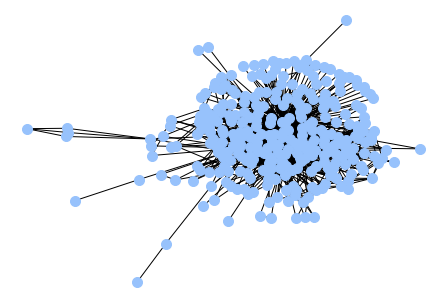

[((10, '1'), (10, '1')), ((10, '1'), (2, '112')), ((10, '1'), (3, '12')), ((10, '1'), (0, '37')), ((10, '1'), (0, '26')), ((10, '1'), (2, '100')), ((10, '1'), (6, '119')), ((10, '1'), (0, '95')), ((10, '1'), (0, '96')), ((10, '1'), (0, '98')), ((10, '1'), (1, '162')), ((10, '1'), (0, '99')), ((10, '1'), (1, '108')), ((10, '1'), (2, '114')), ((10, '1'), (1, '118')), ((10, '1'), (0, '87')), ((10, '1'), (2, '226')), ((10, '1'), (2, '120')), ((10, '1'), (3, '147')), ((10, '1'), (2, '122')), ((10, '1'), (0, '207')), ((10, '1'), (0, '243')), ((10, '1'), (1, '235')), ((10, '1'), (0, '246')), ((10, '1'), (0, '249')), ((10, '1'), (0, '253')), ((10, '1'), (0, '264')), ((10, '1'), (2, '160')), ((10, '1'), (0, '268')), ((10, '1'), (0, '269')), ((10, '1'), (0, '270')), ((10, '1'), (0, '287')), ((10, '1'), (0, '288')), ((10, '1'), (0, '267')), ((10, '1'), (0, '298')), ((10, '1'), (0, '251')), ((10, '1'), (0, '302')), ((10, '1'), (0, '278')), ((10, '1'), (0, '301')), ((10, '1'), (0, '62')), ((10, '1'

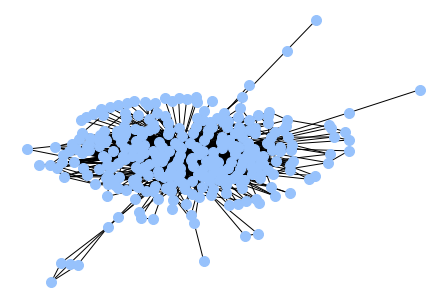

[((11, '1'), (11, '1')), ((11, '1'), (2, '112')), ((11, '1'), (4, '12')), ((11, '1'), (0, '37')), ((11, '1'), (0, '26')), ((11, '1'), (3, '100')), ((11, '1'), (6, '119')), ((11, '1'), (0, '95')), ((11, '1'), (0, '96')), ((11, '1'), (0, '98')), ((11, '1'), (1, '162')), ((11, '1'), (0, '99')), ((11, '1'), (1, '108')), ((11, '1'), (2, '114')), ((11, '1'), (1, '118')), ((11, '1'), (0, '87')), ((11, '1'), (2, '226')), ((11, '1'), (2, '120')), ((11, '1'), (3, '147')), ((11, '1'), (2, '122')), ((11, '1'), (0, '207')), ((11, '1'), (3, '111')), ((11, '1'), (0, '249')), ((11, '1'), (0, '253')), ((11, '1'), (0, '264')), ((11, '1'), (2, '160')), ((11, '1'), (0, '268')), ((11, '1'), (0, '269')), ((11, '1'), (0, '270')), ((11, '1'), (0, '287')), ((11, '1'), (0, '288')), ((11, '1'), (0, '267')), ((11, '1'), (0, '298')), ((11, '1'), (0, '251')), ((11, '1'), (0, '302')), ((11, '1'), (0, '278')), ((11, '1'), (0, '301')), ((11, '1'), (0, '62')), ((11, '1'), (1, '146')), ((11, '1'), (1, '143')), ((11, '1'

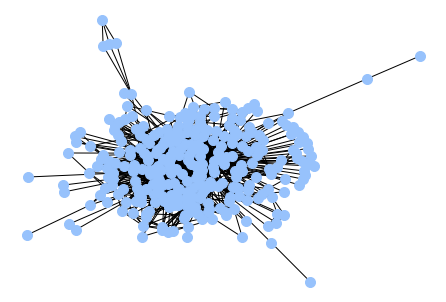

[((12, '1'), (12, '1')), ((12, '1'), (2, '112')), ((12, '1'), (4, '12')), ((12, '1'), (0, '37')), ((12, '1'), (0, '26')), ((12, '1'), (3, '100')), ((12, '1'), (6, '119')), ((12, '1'), (0, '95')), ((12, '1'), (0, '96')), ((12, '1'), (0, '98')), ((12, '1'), (1, '162')), ((12, '1'), (0, '99')), ((12, '1'), (1, '108')), ((12, '1'), (2, '114')), ((12, '1'), (1, '118')), ((12, '1'), (0, '87')), ((12, '1'), (2, '226')), ((12, '1'), (2, '120')), ((12, '1'), (3, '147')), ((12, '1'), (2, '122')), ((12, '1'), (0, '207')), ((12, '1'), (3, '111')), ((12, '1'), (0, '249')), ((12, '1'), (0, '253')), ((12, '1'), (0, '264')), ((12, '1'), (2, '160')), ((12, '1'), (0, '268')), ((12, '1'), (0, '269')), ((12, '1'), (0, '270')), ((12, '1'), (0, '287')), ((12, '1'), (0, '288')), ((12, '1'), (0, '267')), ((12, '1'), (0, '298')), ((12, '1'), (0, '251')), ((12, '1'), (0, '302')), ((12, '1'), (0, '278')), ((12, '1'), (0, '301')), ((12, '1'), (0, '62')), ((12, '1'), (1, '146')), ((12, '1'), (1, '143')), ((12, '1'

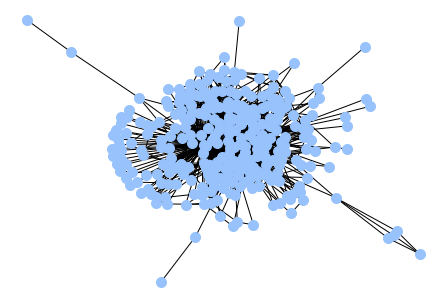

[((13, '1'), (13, '1')), ((13, '1'), (3, '112')), ((13, '1'), (4, '12')), ((13, '1'), (0, '37')), ((13, '1'), (1, '25')), ((13, '1'), (3, '100')), ((13, '1'), (6, '119')), ((13, '1'), (0, '95')), ((13, '1'), (0, '96')), ((13, '1'), (0, '98')), ((13, '1'), (2, '162')), ((13, '1'), (0, '99')), ((13, '1'), (1, '108')), ((13, '1'), (2, '114')), ((13, '1'), (1, '118')), ((13, '1'), (0, '87')), ((13, '1'), (2, '226')), ((13, '1'), (2, '120')), ((13, '1'), (3, '147')), ((13, '1'), (2, '122')), ((13, '1'), (0, '207')), ((13, '1'), (3, '111')), ((13, '1'), (1, '263')), ((13, '1'), (2, '160')), ((13, '1'), (0, '268')), ((13, '1'), (0, '269')), ((13, '1'), (0, '270')), ((13, '1'), (0, '287')), ((13, '1'), (0, '288')), ((13, '1'), (0, '267')), ((13, '1'), (0, '298')), ((13, '1'), (0, '302')), ((13, '1'), (0, '278')), ((13, '1'), (0, '301')), ((13, '1'), (0, '62')), ((13, '1'), (1, '146')), ((13, '1'), (1, '143')), ((13, '1'), (1, '190')), ((13, '1'), (0, '311')), ((13, '1'), (3, '10')), ((13, '1')

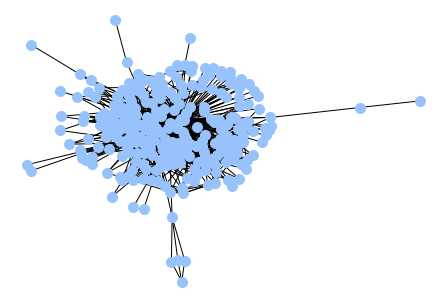

[((14, '1'), (14, '1')), ((14, '1'), (4, '112')), ((14, '1'), (4, '12')), ((14, '1'), (0, '37')), ((14, '1'), (1, '25')), ((14, '1'), (4, '100')), ((14, '1'), (6, '119')), ((14, '1'), (0, '95')), ((14, '1'), (0, '96')), ((14, '1'), (0, '98')), ((14, '1'), (4, '125')), ((14, '1'), (0, '99')), ((14, '1'), (1, '108')), ((14, '1'), (1, '118')), ((14, '1'), (0, '87')), ((14, '1'), (2, '226')), ((14, '1'), (2, '120')), ((14, '1'), (3, '147')), ((14, '1'), (2, '122')), ((14, '1'), (0, '207')), ((14, '1'), (3, '111')), ((14, '1'), (1, '263')), ((14, '1'), (2, '160')), ((14, '1'), (0, '287')), ((14, '1'), (0, '288')), ((14, '1'), (0, '298')), ((14, '1'), (0, '302')), ((14, '1'), (0, '301')), ((14, '1'), (0, '62')), ((14, '1'), (1, '146')), ((14, '1'), (1, '143')), ((14, '1'), (1, '190')), ((14, '1'), (0, '311')), ((14, '1'), (4, '10')), ((14, '1'), (0, '312')), ((14, '1'), (0, '315')), ((14, '1'), (0, '328')), ((14, '1'), (0, '327')), ((14, '1'), (0, '344')), ((14, '1'), (0, '341')), ((14, '1')

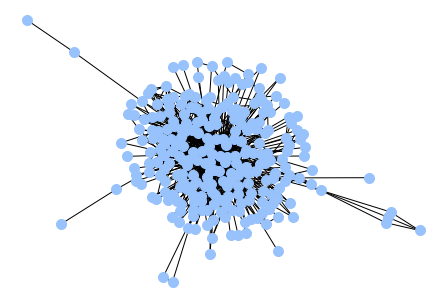

In [21]:
for i in archi:
    print(i)
    GG = nx.Graph()
    GG.add_edges_from(i)
    plt.clf()
    #nx.draw(GG)
    nx.draw(GG, node_color='#97C2FC', node_size=100, edge_color='black', node_shape='o')
    plt.pause(1)
    plt.show()

In [22]:
print("Rete 1: ", nodes_decrease(num_nodi))

Rete 1:  (198, 43.70860927152318, 255, 56.29139072847682)


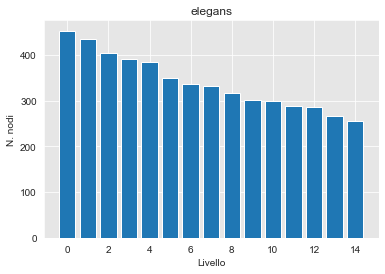

In [4]:
livelli = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] 
nnodi = [453, 435, 405, 391, 385, 349, 337, 331, 317, 301, 299, 289, 287, 267, 255]


plt.bar(livelli, nnodi)
plt.xlabel("Livello")
plt.ylabel("N. nodi")

plt.title("elegans")
plt.savefig("livelliC4G1.png")

In [5]:
prova = [((14, '1'), (14, '1')), ((14, '1'), (4, '112')), ((14, '1'), (4, '12')), ((14, '1'), (0, '37')), ((14, '1'), (1, '25')), ((14, '1'), (4, '100')), ((14, '1'), (6, '119')), ((14, '1'), (0, '95')), ((14, '1'), (0, '96')), ((14, '1'), (0, '98')), ((14, '1'), (4, '125')), ((14, '1'), (0, '99')), ((14, '1'), (1, '108')), ((14, '1'), (1, '118')), ((14, '1'), (0, '87')), ((14, '1'), (2, '226')), ((14, '1'), (2, '120')), ((14, '1'), (3, '147')), ((14, '1'), (2, '122')), ((14, '1'), (0, '207')), ((14, '1'), (3, '111')), ((14, '1'), (1, '263')), ((14, '1'), (2, '160')), ((14, '1'), (0, '287')), ((14, '1'), (0, '288')), ((14, '1'), (0, '298')), ((14, '1'), (0, '302')), ((14, '1'), (0, '301')), ((14, '1'), (0, '62')), ((14, '1'), (1, '146')), ((14, '1'), (1, '143')), ((14, '1'), (1, '190')), ((14, '1'), (0, '311')), ((14, '1'), (4, '10')), ((14, '1'), (0, '312')), ((14, '1'), (0, '315')), ((14, '1'), (0, '328')), ((14, '1'), (0, '327')), ((14, '1'), (0, '344')), ((14, '1'), (0, '341')), ((14, '1'), (0, '349')), ((14, '1'), (0, '356')), ((14, '1'), (2, '175')), ((14, '1'), (0, '369')), ((14, '1'), (0, '370')), ((14, '1'), (0, '393')), ((14, '1'), (1, '258')), ((14, '1'), (0, '398')), ((14, '1'), (0, '399')), ((14, '1'), (0, '400')), ((14, '1'), (0, '397')), ((14, '1'), (0, '402')), ((14, '1'), (0, '401')), ((14, '1'), (0, '404')), ((14, '1'), (0, '89')), ((14, '1'), (0, '411')), ((14, '1'), (0, '412')), ((14, '1'), (2, '155')), ((14, '1'), (0, '416')), ((14, '1'), (0, '386')), ((14, '1'), (0, '279')), ((14, '1'), (0, '428')), ((14, '1'), (0, '429')), ((14, '1'), (0, '435')), ((14, '1'), (0, '306')), ((14, '1'), (0, '8')), ((14, '1'), (0, '31')), ((14, '1'), (0, '39')), ((14, '1'), (0, '28')), ((14, '1'), (0, '43')), ((14, '1'), (0, '30')), ((14, '1'), (0, '36')), ((14, '1'), (0, '41')), ((14, '1'), (0, '48')), ((14, '1'), (0, '50')), ((14, '1'), (0, '59')), ((14, '1'), (1, '164')), ((14, '1'), (0, '64')), ((14, '1'), (0, '65')), ((14, '1'), (0, '69')), ((14, '1'), (0, '71')), ((14, '1'), (0, '73')), ((14, '1'), (0, '74')), ((14, '1'), (0, '76')), ((14, '1'), (0, '77')), ((14, '1'), (0, '79')), ((14, '1'), (0, '80')), ((14, '1'), (0, '88')), ((14, '1'), (0, '90')), ((14, '1'), (0, '91')), ((14, '1'), (0, '92')), ((14, '1'), (0, '42')), ((14, '1'), (0, '94')), ((14, '1'), (1, '105')), ((14, '1'), (2, '128')), ((14, '1'), (0, '283')), ((14, '1'), (0, '284')), ((14, '1'), (0, '285')), ((14, '1'), (0, '286')), ((14, '1'), (0, '293')), ((14, '1'), (0, '300')), ((14, '1'), (0, '309')), ((14, '1'), (0, '310')), ((14, '1'), (0, '318')), ((14, '1'), (0, '319')), ((14, '1'), (0, '320')), ((14, '1'), (0, '323')), ((14, '1'), (0, '324')), ((14, '1'), (0, '330')), ((14, '1'), (0, '54')), ((14, '1'), (0, '331')), ((14, '1'), (0, '332')), ((14, '1'), (0, '333')), ((14, '1'), (0, '334')), ((14, '1'), (0, '335')), ((14, '1'), (0, '338')), ((14, '1'), (0, '339')), ((14, '1'), (0, '346')), ((14, '1'), (0, '347')), ((14, '1'), (0, '78')), ((14, '1'), (0, '350')), ((14, '1'), (0, '359')), ((14, '1'), (1, '211')), ((14, '1'), (0, '360')), ((14, '1'), (0, '361')), ((14, '1'), (0, '362')), ((14, '1'), (0, '363')), ((14, '1'), (0, '364')), ((14, '1'), (0, '365')), ((14, '1'), (0, '366')), ((14, '1'), (0, '367')), ((14, '1'), (0, '368')), ((14, '1'), (0, '371')), ((14, '1'), (0, '372')), ((14, '1'), (0, '373')), ((14, '1'), (0, '378')), ((14, '1'), (0, '380')), ((14, '1'), (0, '379')), ((14, '1'), (0, '389')), ((14, '1'), (0, '390')), ((14, '1'), (0, '290')), ((14, '1'), (0, '391')), ((14, '1'), (0, '392')), ((14, '1'), (0, '394')), ((14, '1'), (0, '403')), ((14, '1'), (0, '409')), ((14, '1'), (0, '414')), ((14, '1'), (0, '415')), ((14, '1'), (0, '423')), ((14, '1'), (0, '424')), ((14, '1'), (0, '425')), ((14, '1'), (0, '430')), ((14, '1'), (0, '431')), ((14, '1'), (0, '432')), ((14, '1'), (0, '433')), ((14, '1'), (0, '436')), ((14, '1'), (0, '437')), ((14, '1'), (0, '438')), ((14, '1'), (0, '439')), ((14, '1'), (0, '440')), ((14, '1'), (0, '441')), ((14, '1'), (0, '442')), ((14, '1'), (0, '443')), ((14, '1'), (0, '444')), ((14, '1'), (0, '448')), ((14, '1'), (0, '449')), ((14, '1'), (0, '447')), ((14, '1'), (0, '452')), ((14, '1'), (0, '453')), ((14, '1'), (0, '422')), ((14, '1'), (0, '451')), ((14, '1'), (0, '32')), ((14, '1'), (0, '388')), ((14, '1'), (0, '352')), ((14, '1'), (1, '215')), ((14, '1'), (0, '307')), ((4, '112'), (0, '59')), ((4, '112'), (1, '164')), ((4, '112'), (0, '79')), ((4, '112'), (0, '80')), ((4, '112'), (2, '226')), ((4, '112'), (0, '85')), ((4, '112'), (4, '12')), ((4, '112'), (0, '87')), ((4, '112'), (0, '65')), ((4, '112'), (0, '98')), ((4, '112'), (4, '125')), ((4, '112'), (0, '99')), ((4, '112'), (1, '105')), ((4, '112'), (1, '108')), ((4, '112'), (3, '111')), ((4, '112'), (4, '112')), ((4, '112'), (4, '10')), ((4, '112'), (6, '119')), ((4, '112'), (2, '120')), ((4, '112'), (2, '122')), ((4, '112'), (2, '160')), ((4, '112'), (0, '283')), ((4, '112'), (0, '284')), ((4, '112'), (0, '285')), ((4, '112'), (0, '286')), ((4, '112'), (0, '301')), ((4, '112'), (0, '304')), ((4, '112'), (0, '305')), ((4, '112'), (0, '309')), ((4, '112'), (1, '190')), ((4, '112'), (0, '311')), ((4, '112'), (0, '312')), ((4, '112'), (0, '315')), ((4, '112'), (0, '324')), ((4, '112'), (1, '118')), ((4, '112'), (0, '328')), ((4, '112'), (0, '327')), ((4, '112'), (0, '344')), ((4, '112'), (0, '341')), ((4, '112'), (0, '356')), ((4, '112'), (2, '175')), ((4, '112'), (4, '100')), ((4, '112'), (0, '390')), ((4, '112'), (0, '290')), ((4, '112'), (0, '391')), ((4, '112'), (0, '392')), ((4, '112'), (0, '398')), ((4, '112'), (0, '399')), ((4, '112'), (0, '400')), ((4, '112'), (0, '397')), ((4, '112'), (0, '402')), ((4, '112'), (0, '401')), ((4, '112'), (0, '404')), ((4, '112'), (0, '89')), ((4, '112'), (3, '147')), ((4, '112'), (1, '263')), ((4, '112'), (0, '300')), ((4, '112'), (0, '50')), ((4, '112'), (0, '53')), ((4, '112'), (0, '61')), ((4, '112'), (0, '63')), ((4, '112'), (0, '64')), ((4, '112'), (0, '74')), ((4, '112'), (0, '75')), ((4, '112'), (0, '313')), ((4, '112'), (0, '314')), ((4, '112'), (0, '318')), ((4, '112'), (0, '323')), ((4, '112'), (0, '349')), ((4, '112'), (0, '375')), ((4, '112'), (0, '376')), ((4, '112'), (0, '371')), ((4, '112'), (0, '410')), ((4, '112'), (0, '439')), ((4, '112'), (0, '440')), ((4, '112'), (0, '316')), ((4, '112'), (0, '317')), ((4, '112'), (0, '396')), ((4, '112'), (0, '403')), ((4, '112'), (0, '413')), ((4, '112'), (0, '331')), ((4, '112'), (0, '93')), ((4, '112'), (0, '83')), ((4, '112'), (0, '92')), ((4, '112'), (1, '255')), ((4, '112'), (0, '78')), ((4, '112'), (0, '444')), ((4, '112'), (0, '342')), ((4, '112'), (0, '297')), ((0, '6'), (4, '10')), ((0, '6'), (0, '8')), ((4, '10'), (0, '8')), ((4, '10'), (4, '10')), ((4, '10'), (4, '12')), ((4, '10'), (0, '37')), ((4, '10'), (0, '39')), ((4, '10'), (0, '40')), ((4, '10'), (0, '41')), ((4, '10'), (0, '42')), ((4, '10'), (0, '43')), ((4, '10'), (0, '44')), ((4, '10'), (0, '46')), ((4, '10'), (0, '48')), ((4, '10'), (6, '119')), ((4, '10'), (0, '62')), ((4, '10'), (0, '61')), ((4, '10'), (0, '64')), ((4, '10'), (0, '65')), ((4, '10'), (0, '73')), ((4, '10'), (0, '74')), ((4, '10'), (0, '88')), ((4, '10'), (0, '89')), ((4, '10'), (0, '92')), ((4, '10'), (4, '125')), ((4, '10'), (1, '255')), ((4, '10'), (0, '290')), ((4, '10'), (0, '78')), ((4, '10'), (0, '279')), ((4, '10'), (0, '297')), ((4, '10'), (1, '164')), ((4, '10'), (0, '301')), ((4, '10'), (1, '143')), ((4, '10'), (0, '299')), ((4, '10'), (0, '310')), ((4, '10'), (0, '308')), ((4, '10'), (0, '339')), ((4, '10'), (0, '345')), ((4, '10'), (2, '120')), ((4, '10'), (0, '349')), ((4, '10'), (0, '373')), ((4, '10'), (0, '374')), ((4, '10'), (0, '379')), ((4, '10'), (0, '377')), ((4, '10'), (0, '408')), ((4, '10'), (0, '409')), ((4, '10'), (0, '449')), ((4, '10'), (0, '450')), ((4, '10'), (0, '344')), ((4, '10'), (0, '30')), ((4, '10'), (2, '160')), ((4, '10'), (2, '128')), ((4, '10'), (0, '67')), ((4, '10'), (0, '54')), ((4, '10'), (0, '137')), ((4, '10'), (0, '311')), ((4, '10'), (0, '312')), ((4, '10'), (0, '401')), ((4, '10'), (0, '404')), ((4, '10'), (0, '414')), ((4, '10'), (1, '258')), ((4, '10'), (0, '415')), ((4, '10'), (4, '100')), ((4, '10'), (0, '272')), ((4, '10'), (0, '280')), ((4, '10'), (0, '281')), ((4, '10'), (0, '285')), ((4, '10'), (0, '288')), ((4, '10'), (0, '289')), ((0, '8'), (0, '37')), ((4, '12'), (4, '12')), ((4, '12'), (0, '37')), ((4, '12'), (1, '25')), ((4, '12'), (4, '100')), ((4, '12'), (0, '42')), ((4, '12'), (0, '44')), ((4, '12'), (0, '29')), ((4, '12'), (0, '40')), ((4, '12'), (0, '32')), ((4, '12'), (6, '119')), ((4, '12'), (0, '83')), ((4, '12'), (0, '84')), ((4, '12'), (0, '85')), ((4, '12'), (2, '226')), ((4, '12'), (0, '87')), ((4, '12'), (0, '65')), ((4, '12'), (0, '89')), ((4, '12'), (0, '90')), ((4, '12'), (0, '94')), ((4, '12'), (0, '78')), ((4, '12'), (0, '88')), ((4, '12'), (0, '328')), ((4, '12'), (0, '327')), ((4, '12'), (0, '343')), ((4, '12'), (0, '337')), ((4, '12'), (0, '345')), ((4, '12'), (0, '344')), ((4, '12'), (0, '371')), ((4, '12'), (0, '372')), ((4, '12'), (0, '378')), ((4, '12'), (0, '407')), ((4, '12'), (1, '164')), ((4, '12'), (1, '190')), ((4, '12'), (0, '419')), ((4, '12'), (0, '420')), ((4, '12'), (0, '421')), ((4, '12'), (4, '125')), ((4, '12'), (0, '448')), ((4, '12'), (0, '449')), ((4, '12'), (0, '450')), ((4, '12'), (0, '445')), ((4, '12'), (0, '446')), ((4, '12'), (0, '31')), ((4, '12'), (0, '36')), ((1, '25'), (1, '25')), ((1, '25'), (0, '28')), ((1, '25'), (0, '29')), ((1, '25'), (0, '30')), ((1, '25'), (0, '31')), ((1, '25'), (0, '32')), ((1, '25'), (0, '36')), ((1, '25'), (0, '76')), ((1, '25'), (0, '77')), ((1, '25'), (0, '65')), ((1, '25'), (2, '122')), ((1, '25'), (1, '143')), ((1, '25'), (0, '299')), ((1, '25'), (0, '327')), ((1, '25'), (4, '125')), ((1, '25'), (0, '337')), ((1, '25'), (0, '338')), ((1, '25'), (0, '412')), ((1, '25'), (4, '100')), ((1, '25'), (0, '418')), ((1, '25'), (0, '419')), ((1, '25'), (0, '446')), ((1, '25'), (0, '447')), ((1, '25'), (0, '37')), ((1, '25'), (0, '420')), ((1, '25'), (1, '164')), ((1, '25'), (0, '421')), ((0, '28'), (0, '43')), ((0, '29'), (0, '30')), ((0, '29'), (0, '44')), ((0, '31'), (0, '39')), ((0, '32'), (0, '40')), ((0, '36'), (0, '41')), ((0, '36'), (0, '327')), ((0, '36'), (4, '125')), ((0, '37'), (4, '100')), ((4, '100'), (6, '119')), ((4, '100'), (4, '100')), ((4, '100'), (0, '99')), ((4, '100'), (0, '102')), ((4, '100'), (2, '120')), ((4, '100'), (2, '160')), ((4, '100'), (1, '170')), ((4, '100'), (2, '122')), ((4, '100'), (1, '164')), ((4, '100'), (3, '147')), ((4, '100'), (1, '143')), ((4, '100'), (0, '296')), ((4, '100'), (0, '308')), ((4, '100'), (0, '307')), ((4, '100'), (0, '323')), ((4, '100'), (0, '324')), ((4, '100'), (0, '349')), ((4, '100'), (0, '351')), ((4, '100'), (0, '352')), ((4, '100'), (0, '356')), ((4, '100'), (2, '175')), ((4, '100'), (0, '394')), ((4, '100'), (2, '226')), ((4, '100'), (1, '108')), ((4, '100'), (0, '395')), ((4, '100'), (0, '396')), ((4, '100'), (0, '401')), ((4, '100'), (3, '111')), ((4, '100'), (0, '412')), ((4, '100'), (2, '155')), ((4, '100'), (0, '416')), ((4, '100'), (2, '128')), ((4, '100'), (0, '439')), ((4, '100'), (1, '118')), ((4, '100'), (1, '190')), ((4, '100'), (1, '215')), ((4, '100'), (0, '280')), ((4, '100'), (0, '281')), ((4, '100'), (0, '279')), ((4, '100'), (0, '285')), ((4, '100'), (0, '441')), ((4, '100'), (0, '442')), ((4, '100'), (0, '386')), ((4, '100'), (0, '388')), ((4, '100'), (0, '389')), ((0, '39'), (0, '40')), ((0, '41'), (0, '42')), ((0, '42'), (0, '94')), ((0, '43'), (0, '44')), ((0, '45'), (0, '46')), ((0, '45'), (0, '54')), ((0, '45'), (2, '160')), ((0, '45'), (4, '125')), ((0, '46'), (4, '125')), ((0, '46'), (0, '48')), ((4, '125'), (0, '48')), ((4, '125'), (4, '125')), ((4, '125'), (6, '119')), ((4, '125'), (0, '62')), ((4, '125'), (0, '61')), ((4, '125'), (0, '64')), ((4, '125'), (0, '65')), ((4, '125'), (0, '94')), ((4, '125'), (0, '95')), ((4, '125'), (2, '128')), ((4, '125'), (2, '175')), ((4, '125'), (0, '291')), ((4, '125'), (0, '292')), ((4, '125'), (1, '143')), ((4, '125'), (0, '299')), ((4, '125'), (0, '315')), ((4, '125'), (2, '120')), ((4, '125'), (0, '319')), ((4, '125'), (0, '321')), ((4, '125'), (0, '322')), ((4, '125'), (0, '92')), ((4, '125'), (0, '408')), ((4, '125'), (0, '409')), ((4, '125'), (0, '421')), ((4, '125'), (0, '418')), ((4, '125'), (3, '111')), ((4, '125'), (0, '438')), ((4, '125'), (0, '443')), ((4, '125'), (2, '122')), ((4, '125'), (0, '355')), ((4, '125'), (0, '54')), ((4, '125'), (2, '160')), ((4, '125'), (0, '67')), ((4, '125'), (0, '93')), ((4, '125'), (0, '83')), ((4, '125'), (0, '98')), ((4, '125'), (0, '99')), ((4, '125'), (1, '170')), ((4, '125'), (0, '307')), ((4, '125'), (0, '63')), ((4, '125'), (0, '327')), ((4, '125'), (0, '342')), ((4, '125'), (0, '343')), ((4, '125'), (0, '374')), ((4, '125'), (0, '375')), ((4, '125'), (0, '377')), ((4, '125'), (0, '381')), ((4, '125'), (0, '397')), ((4, '125'), (0, '398')), ((4, '125'), (0, '405')), ((4, '125'), (0, '406')), ((4, '125'), (0, '407')), ((4, '125'), (1, '164')), ((4, '125'), (0, '436')), ((4, '125'), (0, '437')), ((4, '125'), (0, '444')), ((4, '125'), (0, '371')), ((4, '125'), (0, '445')), ((4, '125'), (0, '450')), ((4, '125'), (0, '344')), ((4, '125'), (1, '263')), ((0, '48'), (0, '50')), ((0, '50'), (0, '53')), ((0, '53'), (2, '160')), ((0, '53'), (0, '342')), ((0, '54'), (2, '160')), ((0, '54'), (6, '119')), ((0, '54'), (0, '332')), ((0, '54'), (1, '190')), ((2, '160'), (0, '75')), ((2, '160'), (0, '78')), ((2, '160'), (2, '160')), ((2, '160'), (6, '119')), ((2, '160'), (1, '170')), ((2, '160'), (1, '190')), ((2, '160'), (1, '211')), ((2, '160'), (1, '164')), ((2, '160'), (0, '342')), ((2, '160'), (0, '353')), ((2, '160'), (0, '93')), ((2, '160'), (0, '407')), ((2, '160'), (0, '89')), ((2, '160'), (0, '408')), ((2, '160'), (0, '297')), ((2, '160'), (0, '410')), ((2, '160'), (0, '371')), ((2, '160'), (1, '108')), ((2, '160'), (3, '111')), ((2, '160'), (1, '263')), ((2, '160'), (0, '308')), ((2, '160'), (0, '307')), ((2, '160'), (0, '395')), ((2, '160'), (0, '396')), ((2, '160'), (0, '401')), ((6, '119'), (1, '108')), ((6, '119'), (1, '105')), ((6, '119'), (6, '119')), ((6, '119'), (2, '120')), ((6, '119'), (1, '190')), ((6, '119'), (2, '122')), ((6, '119'), (0, '313')), ((6, '119'), (0, '314')), ((6, '119'), (0, '316')), ((6, '119'), (0, '317')), ((6, '119'), (0, '332')), ((6, '119'), (0, '336')), ((6, '119'), (0, '333')), ((6, '119'), (0, '368')), ((6, '119'), (1, '164')), ((6, '119'), (0, '436')), ((6, '119'), (0, '437')), ((6, '119'), (0, '444')), ((6, '119'), (3, '147')), ((6, '119'), (0, '87')), ((6, '119'), (2, '226')), ((6, '119'), (0, '370')), ((6, '119'), (0, '443')), ((6, '119'), (3, '111')), ((0, '59'), (1, '164')), ((0, '59'), (0, '61')), ((1, '164'), (1, '164')), ((1, '164'), (0, '331')), ((1, '164'), (0, '332')), ((1, '164'), (1, '190')), ((1, '164'), (0, '421')), ((1, '164'), (0, '297')), ((1, '164'), (2, '128')), ((1, '164'), (1, '263')), ((1, '164'), (0, '279')), ((1, '164'), (0, '288')), ((1, '164'), (0, '289')), ((1, '164'), (0, '298')), ((1, '164'), (0, '299')), ((1, '164'), (0, '301')), ((1, '164'), (0, '303')), ((1, '164'), (0, '304')), ((1, '164'), (0, '305')), ((1, '164'), (0, '439')), ((0, '61'), (0, '62')), ((0, '62'), (0, '301')), ((0, '62'), (0, '300')), ((0, '62'), (0, '279')), ((0, '63'), (0, '64')), ((0, '64'), (0, '65')), ((0, '65'), (2, '226')), ((0, '65'), (0, '85')), ((0, '65'), (0, '87')), ((0, '65'), (2, '122')), ((0, '65'), (0, '92')), ((0, '65'), (0, '78')), ((2, '128'), (0, '67')), ((2, '128'), (0, '68')), ((2, '128'), (2, '128')), ((2, '128'), (2, '175')), ((2, '128'), (1, '258')), ((2, '128'), (0, '290')), ((2, '128'), (0, '78')), ((2, '128'), (0, '414')), ((2, '128'), (0, '415')), ((2, '128'), (0, '422')), ((2, '128'), (0, '439')), ((2, '128'), (1, '170')), ((0, '67'), (0, '68')), ((0, '68'), (0, '69')), ((0, '69'), (0, '71')), ((0, '69'), (2, '122')), ((0, '71'), (2, '122')), ((2, '122'), (0, '88')), ((2, '122'), (2, '122')), ((2, '122'), (2, '120')), ((2, '122'), (0, '399')), ((2, '122'), (0, '396')), ((2, '122'), (0, '381')), ((0, '73'), (0, '74')), ((0, '73'), (0, '77')), ((0, '74'), (0, '75')), ((0, '75'), (0, '78')), ((0, '76'), (0, '77')), ((0, '78'), (0, '88')), ((0, '78'), (0, '92')), ((0, '78'), (0, '290')), ((0, '78'), (1, '258')), ((0, '79'), (0, '80')), ((0, '83'), (0, '84')), ((0, '83'), (0, '85')), ((0, '83'), (0, '93')), ((0, '84'), (0, '85')), ((0, '84'), (0, '343')), ((0, '84'), (0, '337')), ((0, '84'), (0, '407')), ((0, '84'), (0, '445')), ((0, '84'), (0, '446')), ((0, '85'), (2, '226')), ((0, '85'), (0, '87')), ((0, '85'), (0, '340')), ((2, '226'), (0, '87')), ((2, '226'), (2, '226')), ((2, '226'), (2, '219')), ((2, '226'), (2, '120')), ((2, '226'), (0, '394')), ((2, '226'), (1, '215')), ((2, '226'), (0, '293')), ((0, '87'), (0, '318')), ((0, '87'), (0, '323')), ((0, '87'), (2, '120')), ((0, '88'), (0, '89')), ((0, '89'), (0, '90')), ((0, '89'), (2, '120')), ((0, '90'), (0, '91')), ((0, '91'), (0, '92')), ((0, '93'), (0, '342')), ((0, '93'), (0, '343')), ((0, '93'), (0, '407')), ((0, '93'), (0, '371')), ((0, '93'), (0, '445')), ((0, '94'), (0, '95')), ((0, '95'), (0, '96')), ((0, '96'), (0, '98')), ((0, '98'), (0, '99')), ((0, '99'), (0, '294')), ((0, '99'), (0, '295')), ((1, '105'), (1, '105')), ((1, '105'), (1, '108')), ((1, '108'), (1, '108')), ((1, '108'), (3, '111')), ((1, '108'), (2, '175')), ((1, '108'), (0, '331')), ((1, '108'), (1, '263')), ((3, '111'), (3, '111')), ((3, '111'), (0, '435')), ((3, '111'), (0, '438')), ((1, '118'), (1, '118')), ((1, '118'), (0, '324')), ((2, '120'), (2, '120')), ((2, '120'), (0, '349')), ((2, '120'), (0, '403')), ((2, '120'), (0, '309')), ((2, '120'), (0, '398')), ((2, '120'), (0, '399')), ((1, '143'), (1, '143')), ((1, '143'), (1, '146')), ((1, '143'), (3, '147')), ((1, '143'), (0, '296')), ((1, '143'), (0, '299')), ((1, '143'), (0, '352')), ((1, '143'), (0, '391')), ((1, '146'), (1, '146')), ((1, '146'), (0, '423')), ((1, '146'), (0, '424')), ((1, '146'), (0, '425')), ((3, '147'), (3, '147')), ((3, '147'), (1, '215')), ((3, '147'), (0, '296')), ((3, '147'), (0, '351')), ((3, '147'), (0, '352')), ((3, '147'), (2, '219')), ((2, '155'), (2, '155')), ((2, '155'), (0, '416')), ((1, '170'), (1, '170')), ((2, '175'), (2, '175')), ((2, '175'), (0, '356')), ((2, '175'), (0, '331')), ((1, '190'), (1, '190')), ((1, '190'), (0, '311')), ((1, '190'), (0, '332')), ((1, '190'), (0, '389')), ((1, '211'), (1, '211')), ((1, '211'), (0, '359')), ((1, '211'), (0, '312')), ((1, '211'), (0, '353')), ((1, '215'), (1, '215')), ((2, '219'), (2, '219')), ((1, '255'), (1, '255')), ((1, '258'), (1, '258')), ((1, '258'), (0, '393')), ((1, '258'), (0, '312')), ((1, '258'), (0, '330')), ((1, '258'), (0, '290')), ((1, '258'), (0, '414')), ((1, '258'), (0, '415')), ((1, '258'), (0, '422')), ((1, '263'), (1, '263')), ((0, '279'), (0, '285')), ((0, '279'), (0, '297')), ((0, '280'), (0, '281')), ((0, '281'), (0, '282')), ((0, '283'), (0, '284')), ((0, '285'), (0, '286')), ((0, '287'), (0, '288')), ((0, '287'), (0, '350')), ((0, '287'), (0, '302')), ((0, '288'), (0, '289')), ((0, '290'), (0, '390')), ((0, '291'), (0, '292')), ((0, '291'), (0, '293')), ((0, '294'), (0, '295')), ((0, '298'), (0, '299')), ((0, '298'), (0, '303')), ((0, '301'), (0, '304')), ((0, '301'), (0, '305')), ((0, '302'), (0, '350')), ((0, '304'), (0, '305')), ((0, '307'), (0, '308')), ((0, '308'), (0, '310')), ((0, '309'), (0, '310')), ((0, '311'), (0, '312')), ((0, '312'), (0, '330')), ((0, '312'), (0, '359')), ((0, '313'), (0, '314')), ((0, '313'), (0, '313')), ((0, '316'), (0, '317')), ((0, '318'), (0, '319')), ((0, '318'), (0, '320')), ((0, '319'), (0, '320')), ((0, '319'), (0, '321')), ((0, '321'), (0, '322')), ((0, '323'), (0, '324')), ((0, '327'), (0, '328')), ((0, '331'), (0, '332')), ((0, '331'), (0, '413')), ((0, '331'), (0, '356')), ((0, '333'), (0, '334')), ((0, '333'), (0, '336')), ((0, '334'), (0, '335')), ((0, '337'), (0, '338')), ((0, '337'), (0, '343')), ((0, '338'), (0, '339')), ((0, '339'), (0, '345')), ((0, '340'), (0, '341')), ((0, '341'), (0, '344')), ((0, '342'), (0, '343')), ((0, '344'), (0, '345')), ((0, '344'), (0, '450')), ((0, '346'), (0, '347')), ((0, '346'), (0, '346')), ((0, '349'), (0, '452')), ((0, '349'), (0, '453')), ((0, '351'), (0, '352')), ((0, '352'), (0, '391')), ((0, '354'), (0, '355')), ((0, '354'), (0, '354')), ((0, '355'), (0, '355')), ((0, '356'), (0, '413')), ((0, '357'), (0, '358')), ((0, '357'), (0, '359')), ((0, '360'), (0, '361')), ((0, '360'), (0, '362')), ((0, '361'), (0, '362')), ((0, '363'), (0, '364')), ((0, '363'), (0, '365')), ((0, '363'), (0, '366')), ((0, '363'), (0, '367')), ((0, '364'), (0, '365')), ((0, '366'), (0, '367')), ((0, '368'), (0, '370')), ((0, '369'), (0, '370')), ((0, '371'), (0, '372')), ((0, '371'), (0, '378')), ((0, '371'), (0, '409')), ((0, '371'), (0, '410')), ((0, '371'), (0, '445')), ((0, '372'), (0, '373')), ((0, '373'), (0, '374')), ((0, '374'), (0, '375')), ((0, '375'), (0, '376')), ((0, '375'), (0, '377')), ((0, '377'), (0, '379')), ((0, '378'), (0, '380')), ((0, '379'), (0, '380')), ((0, '381'), (0, '382')), ((0, '381'), (0, '383')), ((0, '381'), (0, '384')), ((0, '382'), (0, '383')), ((0, '382'), (0, '384')), ((0, '382'), (0, '385')), ((0, '383'), (0, '384')), ((0, '383'), (0, '385')), ((0, '384'), (0, '385')), ((0, '386'), (0, '388')), ((0, '386'), (0, '389')), ((0, '386'), (0, '416')), ((0, '388'), (0, '389')), ((0, '391'), (0, '392')), ((0, '395'), (0, '396')), ((0, '396'), (0, '399')), ((0, '396'), (0, '403')), ((0, '397'), (0, '398')), ((0, '397'), (0, '400')), ((0, '398'), (0, '399')), ((0, '400'), (0, '402')), ((0, '401'), (0, '404')), ((0, '402'), (0, '404')), ((0, '405'), (0, '406')), ((0, '408'), (0, '408')), ((0, '408'), (0, '409')), ((0, '411'), (0, '412')), ((0, '414'), (0, '415')), ((0, '418'), (0, '419')), ((0, '418'), (0, '421')), ((0, '419'), (0, '420')), ((0, '423'), (0, '424')), ((0, '423'), (0, '425')), ((0, '424'), (0, '425')), ((0, '428'), (0, '429')), ((0, '428'), (0, '435')), ((0, '430'), (0, '431')), ((0, '430'), (0, '432')), ((0, '431'), (0, '432')), ((0, '431'), (0, '433')), ((0, '432'), (0, '433')), ((0, '436'), (0, '437')), ((0, '436'), (0, '438')), ((0, '439'), (0, '440')), ((0, '441'), (0, '442')), ((0, '443'), (0, '444')), ((0, '445'), (0, '446')), ((0, '446'), (0, '447')), ((0, '447'), (0, '448')), ((0, '448'), (0, '449')), ((0, '449'), (0, '450')), ((0, '451'), (0, '451')), ((0, '452'), (0, '453'))]

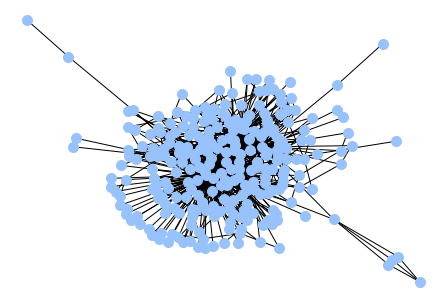

In [6]:
G_prova = nx.Graph()
G_prova.add_edges_from(prova)
nx.draw(G_prova, node_color='#97C2FC', node_size=100, edge_color='black', node_shape='o')

In [9]:
def plot_degree_dist(G):
    degrees = [G.degree(n) for n in G.nodes()]
    plt.hist(degrees)
    plt.xlabel("Degree")
    plt.ylabel("Count")

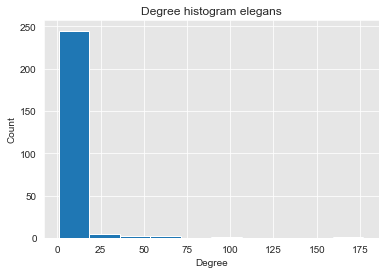

In [10]:
plot_degree_dist(G_prova)
plt.title("Degree histogram elegans")
plt.savefig("histC4G1ris.png")

In [8]:
ba_net_cc = nx.average_clustering(G_prova)
print('Grafo 3 network average cluster coefficient: ' + str(ba_net_cc) + '\n')

ba_net_cc = nx.density(G_prova)
print("Grafo 3: "+str(ba_net_cc))

Grafo 3 network average cluster coefficient: 0.6882917175137795

Grafo 3: 0.027543615871545468


In [14]:
def multicoll(G, motif):
    m = []
    liv = 1
    n, a = [], []
    # nodi G
    nodi = list(G.nodes())
    nodi.sort(key=lambda x:x[1])
    archi = list(G.edges())
    n.append(nodi)
    a.append(archi)
    while liv < 100:
        ris = identify(motif, G)
        if ris == []:
            break
        else:
            mapping = zippa(ris, nodi)
            m.append(mapping)
            G = nx.relabel_nodes(G, mapping)
            # togli triangolo usato
            # la lista ris diminuisce
            ris = ris[1:]
            # i nodi cambiano, sono il risultato della compressione
            nodi = list(G.nodes())
            nodi.sort(key=lambda x:x[1])
            archi = list(G.edges())
            n.append(nodi)
            a.append(archi)
            liv += 1

    tot = list(zip(n, a))
    tup = ()
    lista = []
    for x in tot:
        max_liv = max(x[0], key=itemgetter(0))[0]
        l = len(x[0])
        tup = (max_liv, l, x[0], x[1])
        lista.append(tup)

    d = defaultdict(list)
    for name, num, nod, arc in lista:
        d[name].append((num, nod, arc))

    res = list(zip(d, map(min, d.values())))
    

    return m

In [15]:
def memo(mapping, n):
    dizz = dict()
    for u in mapping:
        
        value_occurrences = collections.Counter(u.values())
        filtered_dict = {key: value for key, value in u.items()
                         if value_occurrences[value] == n}
        new_list = []
        for i, j in filtered_dict.items():
            j = list(j)
            j = i
            j = tuple(j)
            new_list.append(j)
        a = [i for i in new_list[0]]
        a[0] = a[0]+1
        a = tuple(a)
        #print(a, new_list)
        dizz.update({a: new_list})
    return dizz

In [16]:
def flatten(lista):
    flat_list = []
    for sublist in lista:
        #print(type(sublist))
        if type(sublist) == tuple:
            flat_list.append(sublist)
        if type(sublist) == list:
            for item in sublist:
                flat_list.append(item)
    return flat_list

In [17]:


    
from itertools import product


def all_equal(iterator):
    iterator = [x[0] for x in iterator]
    if len(set(iterator)) <= 1:
        ah = list(set(iterator))
        return ah[0] == 0
    else:
        return False

def inverti(lista_nodi, mapping):
    risultato_nodi = []
    risultato_archi = []
    grafo_finale = nx.Graph()
    
    while mapping != {}:
        lista_nodi.sort(key=lambda x:x[0])
        x = lista_nodi[-1]
        y = mapping.get(x)
        risultato_archi.append(y)
        lista_nodi[lista_nodi.index(x)] = y

        del mapping[x]
        lista_nodi = flatten(lista_nodi)
        lista_nodi.sort(key=lambda x:x[1])
    risultato_nodi.append(lista_nodi)

    
    lista = []
    for i in risultato_nodi[0]:
        lista.append(i[1])
        
        
    lista_archi_final = [(lista[i], lista[i+1]) for i in range(0, len(lista)-1, 1)] 
    #print(lista_archi_final)
    
    grafo_finale.add_edges_from(lista_archi_final)
    #print("Risultato archi", risultato_archi)
    risultato_archi2 = []
    for i in risultato_archi:
        #print("i", i, all_equal(i))
        if all_equal(i) == True:
            risultato_archi2.append(i)
    #print(risultato_archi2)
    arconi = []
    for a in risultato_archi2:
        print(a, a[0][1], a[2][1])
        arconi.append((a[0][1], a[2][1]))
    print(arconi)
    grafo_finale.add_edges_from(arconi)

    
    return grafo_finale



## Rete 1 inversa

In [18]:
m1 = multicoll(G1, motif)
m1



[{(0, '1'): (1, '1'),
  (0, '10'): (0, '10'),
  (0, '100'): (0, '100'),
  (0, '101'): (0, '101'),
  (0, '102'): (0, '102'),
  (0, '103'): (0, '103'),
  (0, '104'): (0, '104'),
  (0, '105'): (0, '105'),
  (0, '106'): (0, '106'),
  (0, '107'): (0, '107'),
  (0, '108'): (0, '108'),
  (0, '109'): (0, '109'),
  (0, '11'): (0, '11'),
  (0, '110'): (0, '110'),
  (0, '111'): (0, '111'),
  (0, '112'): (0, '112'),
  (0, '113'): (0, '113'),
  (0, '114'): (0, '114'),
  (0, '115'): (0, '115'),
  (0, '116'): (0, '116'),
  (0, '117'): (0, '117'),
  (0, '118'): (0, '118'),
  (0, '119'): (0, '119'),
  (0, '12'): (0, '12'),
  (0, '120'): (0, '120'),
  (0, '121'): (0, '121'),
  (0, '122'): (0, '122'),
  (0, '123'): (0, '123'),
  (0, '124'): (0, '124'),
  (0, '125'): (0, '125'),
  (0, '126'): (0, '126'),
  (0, '127'): (0, '127'),
  (0, '128'): (0, '128'),
  (0, '129'): (0, '129'),
  (0, '13'): (0, '13'),
  (0, '130'): (0, '130'),
  (0, '131'): (0, '131'),
  (0, '132'): (0, '132'),
  (0, '133'): (0, '133')

In [19]:
mapping1 = memo(m1, 3)



In [20]:
G1_finale = [(14, '1'), (4, '10'), (4, '100'), (0, '102'), (1, '105'), (1, '108'), (3, '111'), (4, '112'), (1, '118'), (6, '119'), (4, '12'), (2, '120'), (2, '122'), (4, '125'), (2, '128'), (0, '137'), (1, '143'), (1, '146'), (3, '147'), (2, '155'), (2, '160'), (1, '164'), (1, '170'), (2, '175'), (1, '190'), (0, '207'), (1, '211'), (1, '215'), (2, '219'), (2, '226'), (1, '25'), (1, '255'), (1, '258'), (1, '263'), (0, '272'), (0, '279'), (0, '28'), (0, '280'), (0, '281'), (0, '282'), (0, '283'), (0, '284'), (0, '285'), (0, '286'), (0, '287'), (0, '288'), (0, '289'), (0, '29'), (0, '290'), (0, '291'), (0, '292'), (0, '293'), (0, '294'), (0, '295'), (0, '296'), (0, '297'), (0, '298'), (0, '299'), (0, '30'), (0, '300'), (0, '301'), (0, '302'), (0, '303'), (0, '304'), (0, '305'), (0, '306'), (0, '307'), (0, '308'), (0, '309'), (0, '31'), (0, '310'), (0, '311'), (0, '312'), (0, '313'), (0, '314'), (0, '315'), (0, '316'), (0, '317'), (0, '318'), (0, '319'), (0, '32'), (0, '320'), (0, '321'), (0, '322'), (0, '323'), (0, '324'), (0, '327'), (0, '328'), (0, '330'), (0, '331'), (0, '332'), (0, '333'), (0, '334'), (0, '335'), (0, '336'), (0, '337'), (0, '338'), (0, '339'), (0, '340'), (0, '341'), (0, '342'), (0, '343'), (0, '344'), (0, '345'), (0, '346'), (0, '347'), (0, '349'), (0, '350'), (0, '351'), (0, '352'), (0, '353'), (0, '354'), (0, '355'), (0, '356'), (0, '357'), (0, '358'), (0, '359'), (0, '36'), (0, '360'), (0, '361'), (0, '362'), (0, '363'), (0, '364'), (0, '365'), (0, '366'), (0, '367'), (0, '368'), (0, '369'), (0, '37'), (0, '370'), (0, '371'), (0, '372'), (0, '373'), (0, '374'), (0, '375'), (0, '376'), (0, '377'), (0, '378'), (0, '379'), (0, '380'), (0, '381'), (0, '382'), (0, '383'), (0, '384'), (0, '385'), (0, '386'), (0, '388'), (0, '389'), (0, '39'), (0, '390'), (0, '391'), (0, '392'), (0, '393'), (0, '394'), (0, '395'), (0, '396'), (0, '397'), (0, '398'), (0, '399'), (0, '40'), (0, '400'), (0, '401'), (0, '402'), (0, '403'), (0, '404'), (0, '405'), (0, '406'), (0, '407'), (0, '408'), (0, '409'), (0, '41'), (0, '410'), (0, '411'), (0, '412'), (0, '413'), (0, '414'), (0, '415'), (0, '416'), (0, '418'), (0, '419'), (0, '42'), (0, '420'), (0, '421'), (0, '422'), (0, '423'), (0, '424'), (0, '425'), (0, '428'), (0, '429'), (0, '43'), (0, '430'), (0, '431'), (0, '432'), (0, '433'), (0, '435'), (0, '436'), (0, '437'), (0, '438'), (0, '439'), (0, '44'), (0, '440'), (0, '441'), (0, '442'), (0, '443'), (0, '444'), (0, '445'), (0, '446'), (0, '447'), (0, '448'), (0, '449'), (0, '45'), (0, '450'), (0, '451'), (0, '452'), (0, '453'), (0, '46'), (0, '48'), (0, '50'), (0, '53'), (0, '54'), (0, '59'), (0, '6'), (0, '61'), (0, '62'), (0, '63'), (0, '64'), (0, '65'), (0, '67'), (0, '68'), (0, '69'), (0, '71'), (0, '73'), (0, '74'), (0, '75'), (0, '76'), (0, '77'), (0, '78'), (0, '79'), (0, '8'), (0, '80'), (0, '83'), (0, '84'), (0, '85'), (0, '87'), (0, '88'), (0, '89'), (0, '90'), (0, '91'), (0, '92'), (0, '93'), (0, '94'), (0, '95'), (0, '96'), (0, '98'), (0, '99')]



In [21]:
G1_INV = inverti(G1_finale, mapping1)




[(0, '263'), (0, '264'), (0, '265')] 263 265
[(0, '258'), (0, '259'), (0, '260')] 258 260
[(0, '255'), (0, '256'), (0, '257')] 255 257
[(0, '250'), (0, '251'), (0, '252')] 250 252
[(0, '25'), (0, '26'), (0, '27')] 25 27
[(0, '235'), (0, '245'), (0, '387')] 235 387
[(0, '229'), (0, '230'), (0, '86')] 229 86
[(0, '226'), (0, '227'), (0, '228')] 226 228
[(0, '219'), (0, '220'), (0, '221')] 219 221
[(0, '216'), (0, '217'), (0, '218')] 216 218
[(0, '215'), (0, '232'), (0, '234')] 215 234
[(0, '211'), (0, '212'), (0, '213')] 211 213
[(0, '190'), (0, '191'), (0, '417')] 190 417
[(0, '177'), (0, '178'), (0, '180')] 177 180
[(0, '175'), (0, '176'), (0, '179')] 175 179
[(0, '170'), (0, '171'), (0, '172')] 170 172
[(0, '168'), (0, '70'), (0, '9')] 168 9
[(0, '164'), (0, '165'), (0, '60')] 164 60
[(0, '162'), (0, '163'), (0, '56')] 162 56
[(0, '160'), (0, '161'), (0, '55')] 160 55
[(0, '155'), (0, '156'), (0, '157')] 155 157
[(0, '149'), (0, '150'), (0, '151')] 149 151
[(0, '147'), (0, '148'), (0,

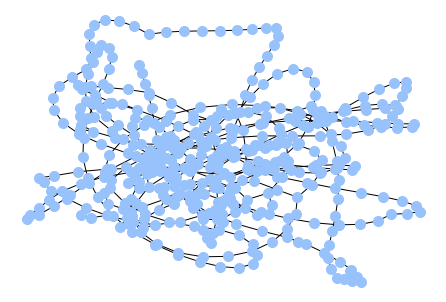

In [23]:
nx.draw(G1_INV, node_color='#97C2FC', node_size=100, edge_color='black', node_shape='o')

---

# Rete 2

In [23]:
start_time = time.time()
res2 = multicoll(G2, motif)
print("--- %s seconds ---" % (time.time() - start_time))

{(0, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (0, '101'): (0, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (0, '1019'): (0, '1019'), (0, '102'): (0, '102'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (0, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(1, '0'): (1, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(2, '0'): (2, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(2, '0'): (2, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(2, '0'): (2, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(2, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (3, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(3, '0'): (9, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '10

{(11, '0'): (12, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

{(14, '0'): (15, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

{(16, '0'): (16, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

{(16, '0'): (16, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

{(16, '0'): (16, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

{(16, '0'): (17, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

{(18, '0'): (19, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

{(20, '0'): (21, '0'), (0, '1'): (0, '1'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '1000'): (0, '1000'), (0, '1001'): (0, '1001'), (0, '1002'): (0, '1002'), (0, '1003'): (0, '1003'), (0, '1004'): (0, '1004'), (0, '1005'): (0, '1005'), (0, '1006'): (0, '1006'), (0, '1007'): (0, '1007'), (0, '1008'): (0, '1008'), (0, '1009'): (0, '1009'), (1, '101'): (1, '101'), (0, '1010'): (0, '1010'), (0, '1011'): (0, '1011'), (0, '1012'): (0, '1012'), (0, '1013'): (0, '1013'), (0, '1014'): (0, '1014'), (0, '1015'): (0, '1015'), (0, '1016'): (0, '1016'), (0, '1017'): (0, '1017'), (0, '1018'): (0, '1018'), (1, '1019'): (1, '1019'), (0, '1020'): (0, '1020'), (0, '1021'): (0, '1021'), (0, '1022'): (0, '1022'), (0, '1023'): (0, '1023'), (0, '1024'): (0, '1024'), (0, '1025'): (0, '1025'), (0, '1026'): (0, '1026'), (0, '1027'): (0, '1027'), (0, '1028'): (0, '1028'), (0, '1029'): (0, '1029'), (0, '103'): (0, '103'), (0, '1030'): (0, '1030'), (0, '1031'): (0, '1031'), (0, '1032'): (0, '1032'), (0, '

In [24]:
res2

[(0,
  (1387,
   [(0, '0'),
    (0, '1'),
    (0, '10'),
    (0, '100'),
    (0, '1000'),
    (0, '1001'),
    (0, '1002'),
    (0, '1003'),
    (0, '1004'),
    (0, '1005'),
    (0, '1006'),
    (0, '1007'),
    (0, '1008'),
    (0, '1009'),
    (0, '101'),
    (0, '1010'),
    (0, '1011'),
    (0, '1012'),
    (0, '1013'),
    (0, '1014'),
    (0, '1015'),
    (0, '1016'),
    (0, '1017'),
    (0, '1018'),
    (0, '1019'),
    (0, '102'),
    (0, '1020'),
    (0, '1021'),
    (0, '1022'),
    (0, '1023'),
    (0, '1024'),
    (0, '1025'),
    (0, '1026'),
    (0, '1027'),
    (0, '1028'),
    (0, '1029'),
    (0, '103'),
    (0, '1030'),
    (0, '1031'),
    (0, '1032'),
    (0, '1033'),
    (0, '1034'),
    (0, '1035'),
    (0, '1036'),
    (0, '1037'),
    (0, '1038'),
    (0, '1039'),
    (0, '104'),
    (0, '1040'),
    (0, '1041'),
    (0, '1042'),
    (0, '1043'),
    (0, '1044'),
    (0, '1045'),
    (0, '1046'),
    (0, '1047'),
    (0, '1048'),
    (0, '1049'),
    (0, '105'

In [25]:
livello2, num_nodi2, nodi2, archi2 = [], [], [], []
for i in res2:
    livello2.append(i[0])
    num_nodi2.append(i[1][0])
    nodi2.append(i[1][1])
    archi2.append(i[1][2])

print("Livello: ", livello2, "\n# nodi: ", num_nodi2,
      "\nNodi: ", nodi2, "\nArchi: ", archi2, "\n\n")

Livello:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22] 
# nodi:  [1387, 1349, 1347, 1305, 1271, 1247, 1245, 1243, 1241, 1239, 1237, 1235, 1233, 1231, 1229, 1227, 1205, 1203, 1199, 1197, 1195, 1193, 1189] 
Nodi:  [[(0, '0'), (0, '1'), (0, '10'), (0, '100'), (0, '1000'), (0, '1001'), (0, '1002'), (0, '1003'), (0, '1004'), (0, '1005'), (0, '1006'), (0, '1007'), (0, '1008'), (0, '1009'), (0, '101'), (0, '1010'), (0, '1011'), (0, '1012'), (0, '1013'), (0, '1014'), (0, '1015'), (0, '1016'), (0, '1017'), (0, '1018'), (0, '1019'), (0, '102'), (0, '1020'), (0, '1021'), (0, '1022'), (0, '1023'), (0, '1024'), (0, '1025'), (0, '1026'), (0, '1027'), (0, '1028'), (0, '1029'), (0, '103'), (0, '1030'), (0, '1031'), (0, '1032'), (0, '1033'), (0, '1034'), (0, '1035'), (0, '1036'), (0, '1037'), (0, '1038'), (0, '1039'), (0, '104'), (0, '1040'), (0, '1041'), (0, '1042'), (0, '1043'), (0, '1044'), (0, '1045'), (0, '1046'), (0, '1047'), (0, '1048'), (0, '1049'), (0, '10

In [26]:
for i in res2:
    print("Livello: ", i[0], "\n# nodi: ", i[1][0], "\nNodi: ",
          i[1][1], "\n\n")

Livello:  0 
# nodi:  1387 
Nodi:  [(0, '0'), (0, '1'), (0, '10'), (0, '100'), (0, '1000'), (0, '1001'), (0, '1002'), (0, '1003'), (0, '1004'), (0, '1005'), (0, '1006'), (0, '1007'), (0, '1008'), (0, '1009'), (0, '101'), (0, '1010'), (0, '1011'), (0, '1012'), (0, '1013'), (0, '1014'), (0, '1015'), (0, '1016'), (0, '1017'), (0, '1018'), (0, '1019'), (0, '102'), (0, '1020'), (0, '1021'), (0, '1022'), (0, '1023'), (0, '1024'), (0, '1025'), (0, '1026'), (0, '1027'), (0, '1028'), (0, '1029'), (0, '103'), (0, '1030'), (0, '1031'), (0, '1032'), (0, '1033'), (0, '1034'), (0, '1035'), (0, '1036'), (0, '1037'), (0, '1038'), (0, '1039'), (0, '104'), (0, '1040'), (0, '1041'), (0, '1042'), (0, '1043'), (0, '1044'), (0, '1045'), (0, '1046'), (0, '1047'), (0, '1048'), (0, '1049'), (0, '105'), (0, '1050'), (0, '1051'), (0, '1052'), (0, '1053'), (0, '1054'), (0, '1055'), (0, '1056'), (0, '1057'), (0, '1058'), (0, '1059'), (0, '106'), (0, '1060'), (0, '1061'), (0, '1062'), (0, '1063'), (0, '1064'), (0, 

[((0, '0'), (0, '1')), ((0, '0'), (0, '2')), ((0, '0'), (0, '3')), ((0, '0'), (0, '4')), ((0, '0'), (0, '5')), ((0, '0'), (0, '6')), ((0, '0'), (0, '7')), ((0, '2'), (0, '185')), ((0, '3'), (0, '191')), ((0, '3'), (0, '95')), ((0, '3'), (0, '217')), ((0, '3'), (0, '226')), ((0, '3'), (0, '227')), ((0, '3'), (0, '228')), ((0, '3'), (0, '229')), ((0, '3'), (0, '230')), ((0, '3'), (0, '231')), ((0, '3'), (0, '185')), ((0, '3'), (0, '7')), ((0, '3'), (0, '232')), ((0, '5'), (0, '662')), ((0, '5'), (0, '185')), ((0, '6'), (0, '662')), ((0, '6'), (0, '185')), ((0, '6'), (0, '607')), ((0, '7'), (0, '231')), ((0, '7'), (0, '185')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0, '874')), ((0, '11'), (0, '969')), ((0, '11'), (0, '303')), ((0, '11'), (0, '1044')), ((0, '11'), (0, '1045'))

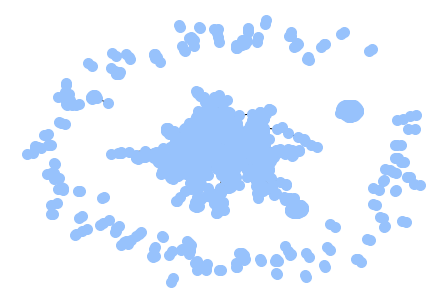

[((1, '0'), (0, '1')), ((1, '0'), (0, '2')), ((1, '0'), (1, '0')), ((1, '0'), (0, '4')), ((1, '0'), (0, '5')), ((1, '0'), (0, '6')), ((1, '0'), (0, '191')), ((1, '0'), (0, '95')), ((1, '0'), (0, '217')), ((1, '0'), (0, '226')), ((1, '0'), (0, '227')), ((1, '0'), (0, '228')), ((1, '0'), (0, '229')), ((1, '0'), (0, '230')), ((1, '0'), (0, '231')), ((1, '0'), (0, '185')), ((1, '0'), (0, '232')), ((0, '2'), (0, '185')), ((0, '5'), (0, '662')), ((0, '5'), (0, '185')), ((0, '6'), (0, '662')), ((0, '6'), (0, '185')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0, '874')), ((0, '11'), (0, '969')), ((0, '11'), (0, '303')), ((0, '11'), (0, '1044')), ((0, '11'), (0, '1045')), ((0, '11'), (0, '1046')), ((0, '12'), (0, '303')), ((0, '12'), (0, '1087')), ((0, '12'), (

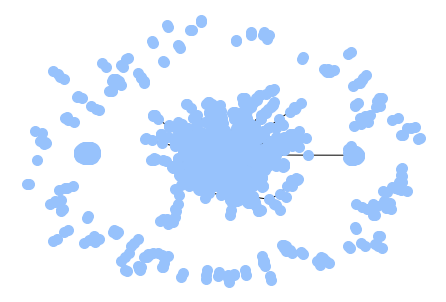

[((1, '0'), (0, '1')), ((1, '0'), (0, '2')), ((1, '0'), (1, '0')), ((1, '0'), (0, '4')), ((1, '0'), (0, '5')), ((1, '0'), (0, '6')), ((1, '0'), (0, '191')), ((1, '0'), (0, '95')), ((1, '0'), (0, '217')), ((1, '0'), (0, '226')), ((1, '0'), (0, '227')), ((1, '0'), (0, '228')), ((1, '0'), (0, '229')), ((1, '0'), (0, '230')), ((1, '0'), (0, '231')), ((1, '0'), (0, '185')), ((1, '0'), (0, '232')), ((0, '2'), (0, '185')), ((0, '5'), (0, '662')), ((0, '5'), (0, '185')), ((0, '6'), (0, '662')), ((0, '6'), (0, '185')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0, '874')), ((0, '11'), (0, '969')), ((0, '11'), (0, '303')), ((0, '11'), (0, '1044')), ((0, '11'), (0, '1045')), ((0, '11'), (0, '1046')), ((0, '12'), (0, '303')), ((0, '12'), (0, '1087')), ((0, '12'), (

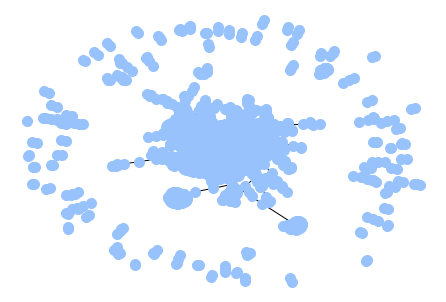

[((3, '0'), (0, '1')), ((3, '0'), (3, '0')), ((3, '0'), (0, '4')), ((3, '0'), (0, '5')), ((3, '0'), (0, '6')), ((3, '0'), (0, '191')), ((3, '0'), (0, '95')), ((3, '0'), (1, '217')), ((3, '0'), (0, '226')), ((3, '0'), (0, '227')), ((3, '0'), (0, '228')), ((3, '0'), (0, '229')), ((3, '0'), (0, '232')), ((3, '0'), (0, '349')), ((3, '0'), (0, '387')), ((3, '0'), (0, '1144')), ((3, '0'), (0, '1183')), ((3, '0'), (0, '1326')), ((3, '0'), (0, '1327')), ((3, '0'), (0, '1328')), ((3, '0'), (0, '79')), ((3, '0'), (0, '184')), ((3, '0'), (0, '598')), ((3, '0'), (0, '996')), ((3, '0'), (0, '1010')), ((3, '0'), (0, '1083')), ((3, '0'), (0, '1324')), ((3, '0'), (0, '1325')), ((0, '5'), (0, '662')), ((0, '6'), (0, '662')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0,

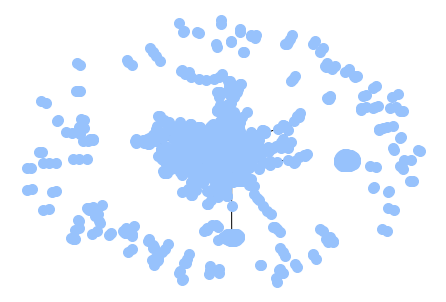

[((3, '0'), (0, '1')), ((3, '0'), (3, '0')), ((3, '0'), (0, '4')), ((3, '0'), (0, '5')), ((3, '0'), (0, '6')), ((3, '0'), (0, '191')), ((3, '0'), (0, '95')), ((3, '0'), (1, '217')), ((3, '0'), (0, '226')), ((3, '0'), (0, '227')), ((3, '0'), (0, '228')), ((3, '0'), (0, '229')), ((3, '0'), (0, '232')), ((3, '0'), (0, '349')), ((3, '0'), (0, '387')), ((3, '0'), (0, '1144')), ((3, '0'), (0, '1183')), ((3, '0'), (0, '1326')), ((3, '0'), (0, '1327')), ((3, '0'), (0, '1328')), ((3, '0'), (0, '79')), ((3, '0'), (0, '184')), ((3, '0'), (0, '598')), ((3, '0'), (0, '996')), ((3, '0'), (0, '1010')), ((3, '0'), (0, '1083')), ((3, '0'), (0, '1324')), ((3, '0'), (0, '1325')), ((0, '5'), (0, '662')), ((0, '6'), (0, '662')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0,

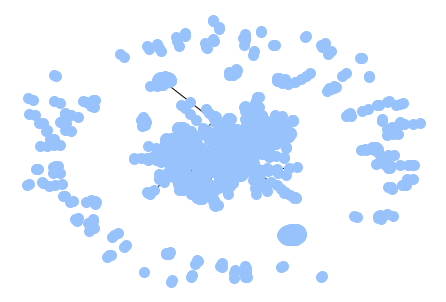

[((3, '0'), (0, '1')), ((3, '0'), (3, '0')), ((3, '0'), (0, '4')), ((3, '0'), (0, '5')), ((3, '0'), (0, '6')), ((3, '0'), (0, '191')), ((3, '0'), (0, '95')), ((3, '0'), (1, '217')), ((3, '0'), (0, '226')), ((3, '0'), (0, '227')), ((3, '0'), (0, '228')), ((3, '0'), (0, '229')), ((3, '0'), (0, '232')), ((3, '0'), (0, '349')), ((3, '0'), (0, '387')), ((3, '0'), (0, '1144')), ((3, '0'), (0, '1183')), ((3, '0'), (0, '1326')), ((3, '0'), (0, '1327')), ((3, '0'), (0, '1328')), ((3, '0'), (0, '79')), ((3, '0'), (0, '184')), ((3, '0'), (0, '598')), ((3, '0'), (0, '996')), ((3, '0'), (0, '1010')), ((3, '0'), (0, '1083')), ((3, '0'), (0, '1324')), ((3, '0'), (0, '1325')), ((0, '5'), (0, '662')), ((0, '6'), (0, '662')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0,

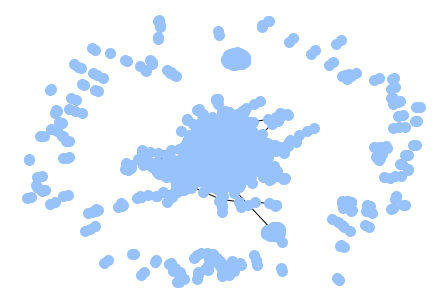

[((3, '0'), (0, '1')), ((3, '0'), (3, '0')), ((3, '0'), (0, '4')), ((3, '0'), (0, '5')), ((3, '0'), (0, '6')), ((3, '0'), (0, '191')), ((3, '0'), (0, '95')), ((3, '0'), (1, '217')), ((3, '0'), (0, '226')), ((3, '0'), (0, '227')), ((3, '0'), (0, '228')), ((3, '0'), (0, '229')), ((3, '0'), (0, '232')), ((3, '0'), (0, '349')), ((3, '0'), (0, '387')), ((3, '0'), (0, '1144')), ((3, '0'), (0, '1183')), ((3, '0'), (0, '1326')), ((3, '0'), (0, '1327')), ((3, '0'), (0, '1328')), ((3, '0'), (0, '79')), ((3, '0'), (0, '184')), ((3, '0'), (0, '598')), ((3, '0'), (0, '996')), ((3, '0'), (0, '1010')), ((3, '0'), (0, '1083')), ((3, '0'), (0, '1324')), ((3, '0'), (0, '1325')), ((0, '5'), (0, '662')), ((0, '6'), (0, '662')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0,

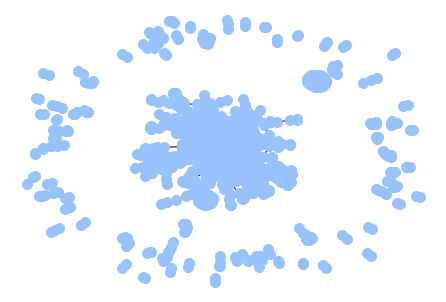

[((3, '0'), (0, '1')), ((3, '0'), (3, '0')), ((3, '0'), (0, '4')), ((3, '0'), (0, '5')), ((3, '0'), (0, '6')), ((3, '0'), (0, '191')), ((3, '0'), (0, '95')), ((3, '0'), (1, '217')), ((3, '0'), (0, '226')), ((3, '0'), (0, '227')), ((3, '0'), (0, '228')), ((3, '0'), (0, '229')), ((3, '0'), (0, '232')), ((3, '0'), (0, '349')), ((3, '0'), (0, '387')), ((3, '0'), (0, '1144')), ((3, '0'), (0, '1183')), ((3, '0'), (0, '1326')), ((3, '0'), (0, '1327')), ((3, '0'), (0, '1328')), ((3, '0'), (0, '79')), ((3, '0'), (0, '184')), ((3, '0'), (0, '598')), ((3, '0'), (0, '996')), ((3, '0'), (0, '1010')), ((3, '0'), (0, '1083')), ((3, '0'), (0, '1324')), ((3, '0'), (0, '1325')), ((0, '5'), (0, '662')), ((0, '6'), (0, '662')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0,

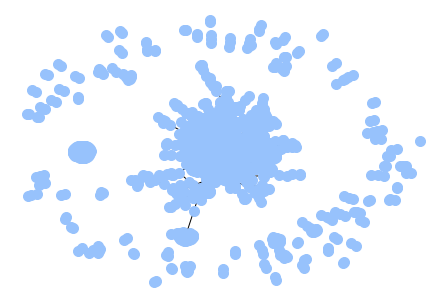

[((3, '0'), (0, '1')), ((3, '0'), (3, '0')), ((3, '0'), (0, '4')), ((3, '0'), (0, '5')), ((3, '0'), (0, '6')), ((3, '0'), (0, '191')), ((3, '0'), (0, '95')), ((3, '0'), (1, '217')), ((3, '0'), (0, '226')), ((3, '0'), (0, '227')), ((3, '0'), (0, '228')), ((3, '0'), (0, '229')), ((3, '0'), (0, '232')), ((3, '0'), (0, '349')), ((3, '0'), (0, '387')), ((3, '0'), (0, '1144')), ((3, '0'), (0, '1183')), ((3, '0'), (0, '1326')), ((3, '0'), (0, '1327')), ((3, '0'), (0, '1328')), ((3, '0'), (8, '1323')), ((3, '0'), (0, '184')), ((3, '0'), (0, '598')), ((3, '0'), (0, '996')), ((3, '0'), (0, '1010')), ((3, '0'), (0, '1083')), ((3, '0'), (0, '1324')), ((3, '0'), (0, '1325')), ((0, '5'), (0, '662')), ((0, '6'), (0, '662')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (

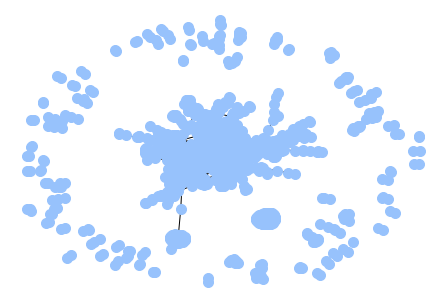

[((9, '0'), (0, '1')), ((9, '0'), (9, '0')), ((9, '0'), (0, '4')), ((9, '0'), (0, '5')), ((9, '0'), (0, '6')), ((9, '0'), (0, '191')), ((9, '0'), (0, '95')), ((9, '0'), (1, '217')), ((9, '0'), (0, '226')), ((9, '0'), (0, '227')), ((9, '0'), (0, '228')), ((9, '0'), (0, '229')), ((9, '0'), (0, '232')), ((9, '0'), (0, '349')), ((9, '0'), (0, '387')), ((9, '0'), (0, '1144')), ((9, '0'), (0, '1183')), ((9, '0'), (0, '1326')), ((9, '0'), (0, '1327')), ((9, '0'), (0, '1328')), ((9, '0'), (0, '598')), ((9, '0'), (0, '996')), ((9, '0'), (0, '1010')), ((9, '0'), (0, '1083')), ((9, '0'), (0, '1324')), ((9, '0'), (0, '1325')), ((9, '0'), (0, '18')), ((9, '0'), (0, '19')), ((9, '0'), (0, '22')), ((9, '0'), (0, '1211')), ((9, '0'), (0, '1212')), ((9, '0'), (0, '1240')), ((9, '0'), (0, '1241')), ((9, '0'), (0, '671')), ((9, '0'), (0, '659')), ((9, '0'), (0, '660')), ((9, '0'), (0, '661')), ((9, '0'), (0, '358')), ((9, '0'), (0, '359')), ((9, '0'), (0, '361')), ((9, '0'), (0, '362')), ((9, '0'), (1, '

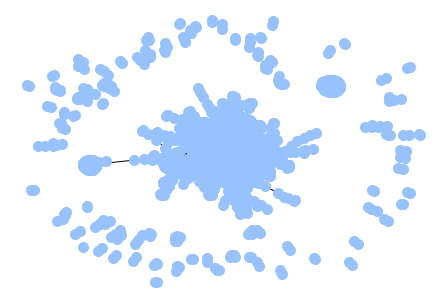

[((10, '0'), (0, '1')), ((10, '0'), (10, '0')), ((10, '0'), (0, '4')), ((10, '0'), (0, '5')), ((10, '0'), (0, '6')), ((10, '0'), (0, '191')), ((10, '0'), (0, '95')), ((10, '0'), (1, '217')), ((10, '0'), (0, '226')), ((10, '0'), (0, '227')), ((10, '0'), (0, '228')), ((10, '0'), (0, '229')), ((10, '0'), (0, '232')), ((10, '0'), (0, '349')), ((10, '0'), (0, '387')), ((10, '0'), (0, '1144')), ((10, '0'), (0, '1183')), ((10, '0'), (0, '1326')), ((10, '0'), (0, '1327')), ((10, '0'), (0, '1328')), ((10, '0'), (0, '598')), ((10, '0'), (0, '996')), ((10, '0'), (0, '1010')), ((10, '0'), (0, '1083')), ((10, '0'), (0, '1325')), ((10, '0'), (0, '18')), ((10, '0'), (0, '19')), ((10, '0'), (0, '22')), ((10, '0'), (0, '1211')), ((10, '0'), (0, '1212')), ((10, '0'), (0, '1240')), ((10, '0'), (0, '1241')), ((10, '0'), (0, '671')), ((10, '0'), (0, '659')), ((10, '0'), (0, '660')), ((10, '0'), (0, '661')), ((10, '0'), (0, '358')), ((10, '0'), (0, '359')), ((10, '0'), (0, '361')), ((10, '0'), (0, '362')), 

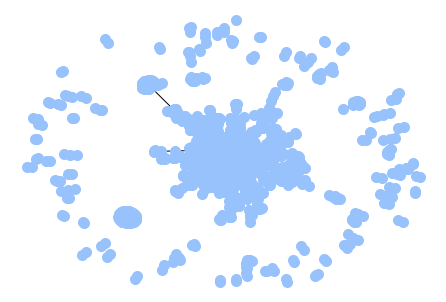

[((11, '0'), (0, '1')), ((11, '0'), (11, '0')), ((11, '0'), (0, '4')), ((11, '0'), (0, '5')), ((11, '0'), (0, '6')), ((11, '0'), (0, '191')), ((11, '0'), (0, '95')), ((11, '0'), (1, '217')), ((11, '0'), (0, '226')), ((11, '0'), (0, '227')), ((11, '0'), (0, '228')), ((11, '0'), (0, '229')), ((11, '0'), (0, '232')), ((11, '0'), (0, '349')), ((11, '0'), (0, '387')), ((11, '0'), (0, '1144')), ((11, '0'), (0, '1183')), ((11, '0'), (0, '1326')), ((11, '0'), (0, '1327')), ((11, '0'), (0, '1328')), ((11, '0'), (0, '598')), ((11, '0'), (0, '996')), ((11, '0'), (0, '1010')), ((11, '0'), (0, '1083')), ((11, '0'), (0, '1325')), ((11, '0'), (0, '18')), ((11, '0'), (0, '1211')), ((11, '0'), (0, '1212')), ((11, '0'), (0, '1240')), ((11, '0'), (0, '1241')), ((11, '0'), (0, '671')), ((11, '0'), (0, '659')), ((11, '0'), (0, '660')), ((11, '0'), (0, '661')), ((11, '0'), (0, '358')), ((11, '0'), (0, '359')), ((11, '0'), (0, '361')), ((11, '0'), (0, '362')), ((11, '0'), (1, '216')), ((11, '0'), (0, '526'))

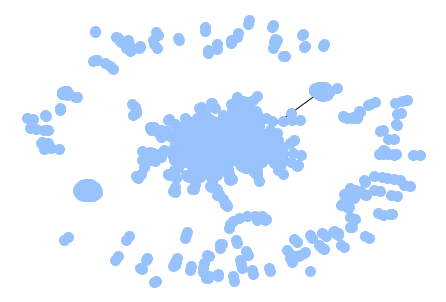

[((12, '0'), (0, '1')), ((12, '0'), (12, '0')), ((12, '0'), (0, '4')), ((12, '0'), (0, '5')), ((12, '0'), (0, '6')), ((12, '0'), (0, '191')), ((12, '0'), (0, '95')), ((12, '0'), (1, '217')), ((12, '0'), (0, '226')), ((12, '0'), (0, '227')), ((12, '0'), (0, '228')), ((12, '0'), (0, '229')), ((12, '0'), (0, '232')), ((12, '0'), (0, '349')), ((12, '0'), (0, '387')), ((12, '0'), (0, '1144')), ((12, '0'), (0, '1183')), ((12, '0'), (0, '1326')), ((12, '0'), (0, '1327')), ((12, '0'), (0, '1328')), ((12, '0'), (0, '598')), ((12, '0'), (0, '996')), ((12, '0'), (0, '1010')), ((12, '0'), (0, '1083')), ((12, '0'), (0, '1325')), ((12, '0'), (0, '18')), ((12, '0'), (0, '1211')), ((12, '0'), (0, '1212')), ((12, '0'), (0, '1240')), ((12, '0'), (0, '1241')), ((12, '0'), (0, '671')), ((12, '0'), (0, '659')), ((12, '0'), (0, '660')), ((12, '0'), (0, '661')), ((12, '0'), (0, '358')), ((12, '0'), (0, '359')), ((12, '0'), (0, '361')), ((12, '0'), (0, '362')), ((12, '0'), (1, '216')), ((12, '0'), (0, '526'))

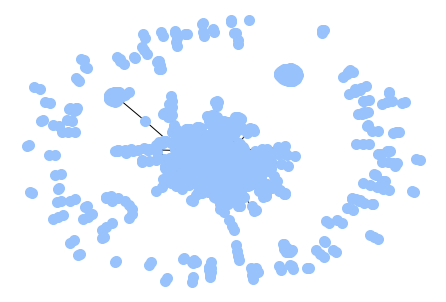

[((13, '0'), (0, '1')), ((13, '0'), (13, '0')), ((13, '0'), (0, '4')), ((13, '0'), (0, '6')), ((13, '0'), (0, '191')), ((13, '0'), (0, '95')), ((13, '0'), (1, '217')), ((13, '0'), (0, '226')), ((13, '0'), (0, '227')), ((13, '0'), (0, '228')), ((13, '0'), (0, '229')), ((13, '0'), (0, '232')), ((13, '0'), (0, '349')), ((13, '0'), (0, '387')), ((13, '0'), (0, '1144')), ((13, '0'), (0, '1183')), ((13, '0'), (0, '1326')), ((13, '0'), (0, '1327')), ((13, '0'), (0, '1328')), ((13, '0'), (0, '598')), ((13, '0'), (0, '996')), ((13, '0'), (0, '1010')), ((13, '0'), (0, '1083')), ((13, '0'), (0, '1325')), ((13, '0'), (0, '18')), ((13, '0'), (0, '1211')), ((13, '0'), (0, '1212')), ((13, '0'), (0, '1240')), ((13, '0'), (0, '1241')), ((13, '0'), (0, '671')), ((13, '0'), (0, '659')), ((13, '0'), (0, '660')), ((13, '0'), (0, '661')), ((13, '0'), (0, '358')), ((13, '0'), (0, '359')), ((13, '0'), (0, '361')), ((13, '0'), (0, '362')), ((13, '0'), (1, '216')), ((13, '0'), (0, '526')), ((13, '0'), (0, '528'

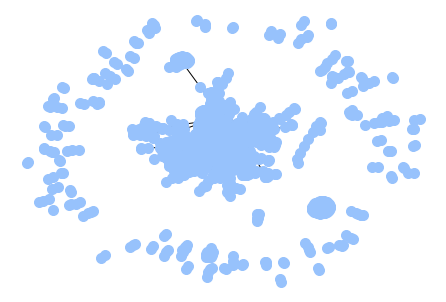

[((14, '0'), (0, '1')), ((14, '0'), (14, '0')), ((14, '0'), (0, '4')), ((14, '0'), (0, '6')), ((14, '0'), (0, '191')), ((14, '0'), (1, '217')), ((14, '0'), (0, '226')), ((14, '0'), (0, '227')), ((14, '0'), (0, '228')), ((14, '0'), (0, '229')), ((14, '0'), (0, '232')), ((14, '0'), (0, '349')), ((14, '0'), (0, '387')), ((14, '0'), (0, '1144')), ((14, '0'), (0, '1183')), ((14, '0'), (0, '1326')), ((14, '0'), (0, '1327')), ((14, '0'), (0, '1328')), ((14, '0'), (0, '598')), ((14, '0'), (0, '996')), ((14, '0'), (0, '1010')), ((14, '0'), (0, '1083')), ((14, '0'), (0, '1325')), ((14, '0'), (0, '18')), ((14, '0'), (0, '1211')), ((14, '0'), (0, '1212')), ((14, '0'), (0, '1240')), ((14, '0'), (0, '1241')), ((14, '0'), (0, '671')), ((14, '0'), (0, '659')), ((14, '0'), (0, '660')), ((14, '0'), (0, '661')), ((14, '0'), (0, '358')), ((14, '0'), (0, '359')), ((14, '0'), (0, '361')), ((14, '0'), (0, '362')), ((14, '0'), (1, '216')), ((14, '0'), (0, '526')), ((14, '0'), (0, '528')), ((14, '0'), (0, '532

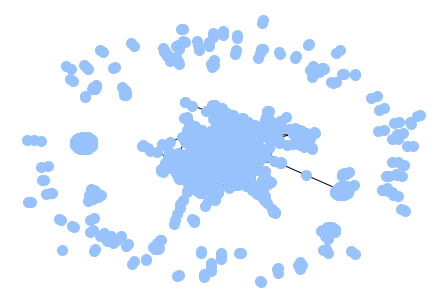

[((15, '0'), (0, '1')), ((15, '0'), (15, '0')), ((15, '0'), (0, '4')), ((15, '0'), (0, '6')), ((15, '0'), (0, '191')), ((15, '0'), (1, '217')), ((15, '0'), (0, '226')), ((15, '0'), (0, '227')), ((15, '0'), (0, '228')), ((15, '0'), (0, '229')), ((15, '0'), (0, '232')), ((15, '0'), (0, '349')), ((15, '0'), (0, '387')), ((15, '0'), (0, '1144')), ((15, '0'), (0, '1183')), ((15, '0'), (0, '1326')), ((15, '0'), (0, '1327')), ((15, '0'), (0, '1328')), ((15, '0'), (0, '598')), ((15, '0'), (0, '996')), ((15, '0'), (0, '1010')), ((15, '0'), (0, '1083')), ((15, '0'), (0, '1325')), ((15, '0'), (0, '1211')), ((15, '0'), (0, '1212')), ((15, '0'), (0, '1240')), ((15, '0'), (0, '1241')), ((15, '0'), (0, '671')), ((15, '0'), (0, '659')), ((15, '0'), (0, '660')), ((15, '0'), (0, '661')), ((15, '0'), (0, '358')), ((15, '0'), (0, '359')), ((15, '0'), (0, '361')), ((15, '0'), (0, '362')), ((15, '0'), (1, '216')), ((15, '0'), (0, '526')), ((15, '0'), (0, '528')), ((15, '0'), (0, '532')), ((15, '0'), (0, '53

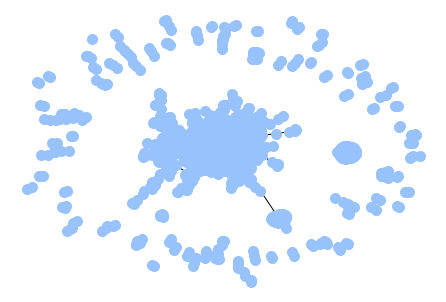

[((16, '0'), (0, '1')), ((16, '0'), (16, '0')), ((16, '0'), (0, '4')), ((16, '0'), (0, '6')), ((16, '0'), (0, '191')), ((16, '0'), (1, '217')), ((16, '0'), (0, '226')), ((16, '0'), (0, '227')), ((16, '0'), (0, '228')), ((16, '0'), (0, '229')), ((16, '0'), (0, '232')), ((16, '0'), (0, '349')), ((16, '0'), (0, '387')), ((16, '0'), (0, '1144')), ((16, '0'), (0, '1183')), ((16, '0'), (0, '1326')), ((16, '0'), (0, '1327')), ((16, '0'), (0, '1328')), ((16, '0'), (0, '598')), ((16, '0'), (0, '996')), ((16, '0'), (0, '1010')), ((16, '0'), (0, '1083')), ((16, '0'), (0, '1325')), ((16, '0'), (0, '1211')), ((16, '0'), (0, '1212')), ((16, '0'), (0, '1240')), ((16, '0'), (0, '1241')), ((16, '0'), (0, '671')), ((16, '0'), (0, '659')), ((16, '0'), (0, '660')), ((16, '0'), (0, '661')), ((16, '0'), (0, '358')), ((16, '0'), (0, '359')), ((16, '0'), (0, '361')), ((16, '0'), (0, '362')), ((16, '0'), (1, '216')), ((16, '0'), (0, '526')), ((16, '0'), (0, '528')), ((16, '0'), (0, '532')), ((16, '0'), (0, '61

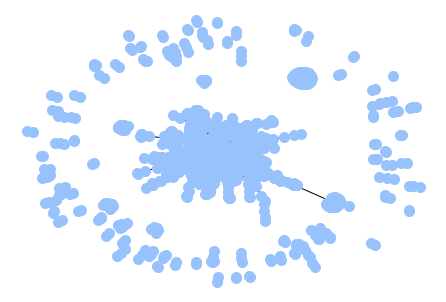

[((17, '0'), (0, '1')), ((17, '0'), (17, '0')), ((17, '0'), (0, '4')), ((17, '0'), (0, '6')), ((17, '0'), (0, '191')), ((17, '0'), (1, '217')), ((17, '0'), (0, '226')), ((17, '0'), (0, '227')), ((17, '0'), (0, '228')), ((17, '0'), (0, '229')), ((17, '0'), (0, '232')), ((17, '0'), (0, '349')), ((17, '0'), (0, '387')), ((17, '0'), (0, '1144')), ((17, '0'), (0, '1183')), ((17, '0'), (0, '1326')), ((17, '0'), (0, '1327')), ((17, '0'), (0, '1328')), ((17, '0'), (0, '598')), ((17, '0'), (0, '996')), ((17, '0'), (0, '1010')), ((17, '0'), (0, '1083')), ((17, '0'), (0, '1325')), ((17, '0'), (0, '1211')), ((17, '0'), (0, '1212')), ((17, '0'), (0, '1240')), ((17, '0'), (0, '1241')), ((17, '0'), (0, '671')), ((17, '0'), (0, '659')), ((17, '0'), (0, '660')), ((17, '0'), (0, '661')), ((17, '0'), (0, '358')), ((17, '0'), (0, '359')), ((17, '0'), (0, '361')), ((17, '0'), (0, '362')), ((17, '0'), (1, '216')), ((17, '0'), (0, '526')), ((17, '0'), (0, '528')), ((17, '0'), (0, '532')), ((17, '0'), (0, '61

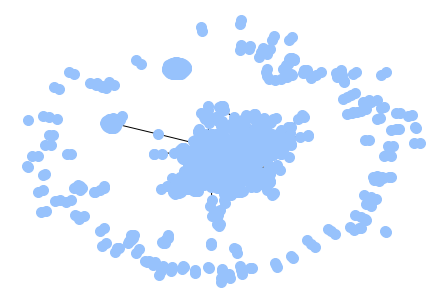

[((18, '0'), (0, '1')), ((18, '0'), (18, '0')), ((18, '0'), (0, '4')), ((18, '0'), (0, '6')), ((18, '0'), (0, '191')), ((18, '0'), (1, '217')), ((18, '0'), (0, '226')), ((18, '0'), (0, '227')), ((18, '0'), (0, '228')), ((18, '0'), (0, '229')), ((18, '0'), (0, '232')), ((18, '0'), (0, '349')), ((18, '0'), (0, '387')), ((18, '0'), (0, '1144')), ((18, '0'), (0, '1183')), ((18, '0'), (0, '1326')), ((18, '0'), (0, '1327')), ((18, '0'), (0, '1328')), ((18, '0'), (0, '598')), ((18, '0'), (0, '996')), ((18, '0'), (0, '1010')), ((18, '0'), (0, '1083')), ((18, '0'), (0, '1325')), ((18, '0'), (0, '1211')), ((18, '0'), (0, '1212')), ((18, '0'), (0, '1240')), ((18, '0'), (0, '1241')), ((18, '0'), (0, '671')), ((18, '0'), (0, '659')), ((18, '0'), (0, '660')), ((18, '0'), (0, '661')), ((18, '0'), (0, '358')), ((18, '0'), (0, '359')), ((18, '0'), (0, '361')), ((18, '0'), (0, '362')), ((18, '0'), (1, '216')), ((18, '0'), (0, '526')), ((18, '0'), (0, '528')), ((18, '0'), (0, '532')), ((18, '0'), (0, '61

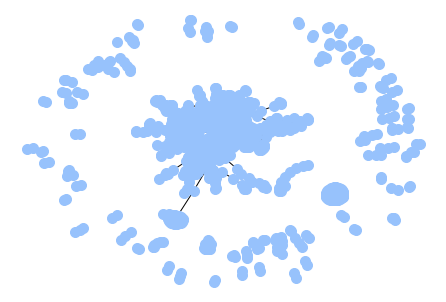

[((19, '0'), (0, '1')), ((19, '0'), (19, '0')), ((19, '0'), (0, '4')), ((19, '0'), (0, '6')), ((19, '0'), (0, '191')), ((19, '0'), (1, '217')), ((19, '0'), (0, '226')), ((19, '0'), (0, '227')), ((19, '0'), (0, '228')), ((19, '0'), (0, '229')), ((19, '0'), (0, '232')), ((19, '0'), (0, '349')), ((19, '0'), (0, '387')), ((19, '0'), (0, '1144')), ((19, '0'), (0, '1183')), ((19, '0'), (0, '1326')), ((19, '0'), (0, '1327')), ((19, '0'), (0, '1328')), ((19, '0'), (0, '598')), ((19, '0'), (0, '996')), ((19, '0'), (0, '1010')), ((19, '0'), (0, '1083')), ((19, '0'), (0, '1325')), ((19, '0'), (0, '1211')), ((19, '0'), (0, '1212')), ((19, '0'), (0, '1240')), ((19, '0'), (0, '1241')), ((19, '0'), (0, '671')), ((19, '0'), (0, '659')), ((19, '0'), (0, '660')), ((19, '0'), (0, '661')), ((19, '0'), (0, '358')), ((19, '0'), (0, '359')), ((19, '0'), (0, '361')), ((19, '0'), (0, '362')), ((19, '0'), (1, '216')), ((19, '0'), (0, '526')), ((19, '0'), (0, '528')), ((19, '0'), (0, '532')), ((19, '0'), (0, '61

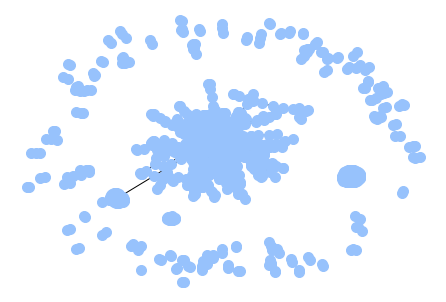

[((20, '0'), (0, '1')), ((20, '0'), (20, '0')), ((20, '0'), (0, '4')), ((20, '0'), (0, '6')), ((20, '0'), (0, '191')), ((20, '0'), (1, '217')), ((20, '0'), (0, '226')), ((20, '0'), (0, '227')), ((20, '0'), (0, '228')), ((20, '0'), (0, '229')), ((20, '0'), (0, '232')), ((20, '0'), (0, '349')), ((20, '0'), (0, '387')), ((20, '0'), (0, '1144')), ((20, '0'), (0, '1183')), ((20, '0'), (0, '1326')), ((20, '0'), (0, '1327')), ((20, '0'), (0, '1328')), ((20, '0'), (0, '598')), ((20, '0'), (0, '996')), ((20, '0'), (0, '1010')), ((20, '0'), (0, '1083')), ((20, '0'), (0, '1325')), ((20, '0'), (0, '1211')), ((20, '0'), (0, '1212')), ((20, '0'), (0, '1240')), ((20, '0'), (0, '1241')), ((20, '0'), (0, '671')), ((20, '0'), (0, '659')), ((20, '0'), (0, '660')), ((20, '0'), (0, '661')), ((20, '0'), (0, '358')), ((20, '0'), (0, '359')), ((20, '0'), (0, '361')), ((20, '0'), (0, '362')), ((20, '0'), (1, '216')), ((20, '0'), (0, '526')), ((20, '0'), (0, '528')), ((20, '0'), (0, '532')), ((20, '0'), (0, '61

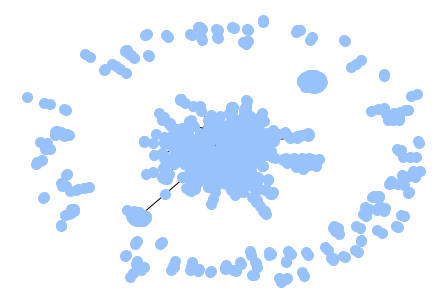

[((21, '0'), (0, '1')), ((21, '0'), (21, '0')), ((21, '0'), (0, '4')), ((21, '0'), (0, '6')), ((21, '0'), (0, '191')), ((21, '0'), (1, '217')), ((21, '0'), (0, '226')), ((21, '0'), (0, '227')), ((21, '0'), (0, '228')), ((21, '0'), (0, '229')), ((21, '0'), (0, '232')), ((21, '0'), (0, '349')), ((21, '0'), (0, '387')), ((21, '0'), (0, '1144')), ((21, '0'), (0, '1183')), ((21, '0'), (0, '1326')), ((21, '0'), (0, '1327')), ((21, '0'), (0, '1328')), ((21, '0'), (0, '598')), ((21, '0'), (0, '996')), ((21, '0'), (0, '1010')), ((21, '0'), (0, '1083')), ((21, '0'), (0, '1325')), ((21, '0'), (0, '1211')), ((21, '0'), (0, '1212')), ((21, '0'), (0, '1240')), ((21, '0'), (0, '1241')), ((21, '0'), (0, '671')), ((21, '0'), (0, '659')), ((21, '0'), (0, '660')), ((21, '0'), (0, '661')), ((21, '0'), (0, '358')), ((21, '0'), (0, '359')), ((21, '0'), (0, '361')), ((21, '0'), (0, '362')), ((21, '0'), (1, '216')), ((21, '0'), (0, '526')), ((21, '0'), (0, '528')), ((21, '0'), (0, '532')), ((21, '0'), (0, '61

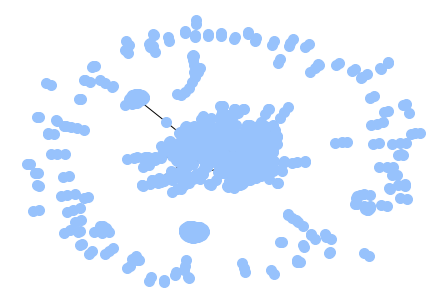

[((22, '0'), (0, '1')), ((22, '0'), (22, '0')), ((22, '0'), (0, '4')), ((22, '0'), (0, '6')), ((22, '0'), (0, '191')), ((22, '0'), (2, '217')), ((22, '0'), (0, '226')), ((22, '0'), (0, '227')), ((22, '0'), (0, '228')), ((22, '0'), (0, '229')), ((22, '0'), (0, '232')), ((22, '0'), (0, '349')), ((22, '0'), (0, '387')), ((22, '0'), (0, '1144')), ((22, '0'), (0, '1183')), ((22, '0'), (0, '1326')), ((22, '0'), (0, '1327')), ((22, '0'), (0, '1328')), ((22, '0'), (0, '598')), ((22, '0'), (0, '996')), ((22, '0'), (0, '1010')), ((22, '0'), (0, '1083')), ((22, '0'), (0, '1325')), ((22, '0'), (0, '1211')), ((22, '0'), (0, '1212')), ((22, '0'), (0, '1240')), ((22, '0'), (0, '1241')), ((22, '0'), (0, '671')), ((22, '0'), (0, '659')), ((22, '0'), (0, '660')), ((22, '0'), (0, '661')), ((22, '0'), (0, '358')), ((22, '0'), (0, '359')), ((22, '0'), (0, '361')), ((22, '0'), (0, '362')), ((22, '0'), (1, '216')), ((22, '0'), (0, '526')), ((22, '0'), (0, '528')), ((22, '0'), (0, '532')), ((22, '0'), (0, '61

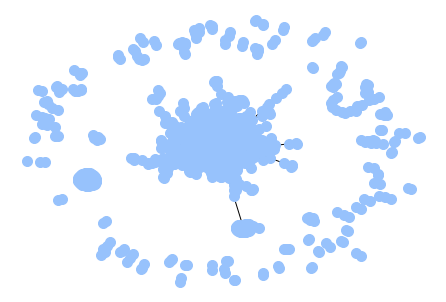

In [27]:
for i in archi2:
    print(i)
    GG = nx.Graph()
    GG.add_edges_from(i)
    plt.clf()
    #nx.draw(GG)
    nx.draw(GG, node_color='#97C2FC', node_size=100, edge_color='black', node_shape='o')
    plt.pause(1)
    plt.show()

In [28]:
print("Rete 2: ", nodes_decrease(num_nodi2))

Rete 2:  (198, 14.275414563806777, 1189, 85.72458543619322)


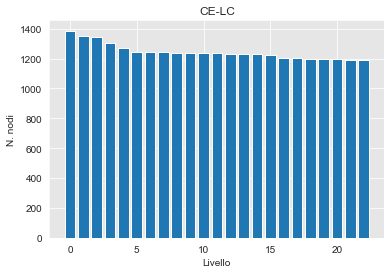

In [11]:
livelli =  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22] 
nnodi =  [1387, 1349, 1347, 1305, 1271, 1247, 1245, 1243, 1241, 1239, 1237, 1235, 1233, 1231, 1229, 1227, 1205, 1203, 1199, 1197, 1195, 1193, 1189] 

plt.bar(livelli, nnodi)
plt.xlabel("Livello")
plt.ylabel("N. nodi")

plt.title("CE-LC")
plt.savefig("livelliC4G2.png")

In [12]:
prova = [((22, '0'), (0, '1')), ((22, '0'), (22, '0')), ((22, '0'), (0, '4')), ((22, '0'), (0, '6')), ((22, '0'), (0, '191')), ((22, '0'), (2, '217')), ((22, '0'), (0, '226')), ((22, '0'), (0, '227')), ((22, '0'), (0, '228')), ((22, '0'), (0, '229')), ((22, '0'), (0, '232')), ((22, '0'), (0, '349')), ((22, '0'), (0, '387')), ((22, '0'), (0, '1144')), ((22, '0'), (0, '1183')), ((22, '0'), (0, '1326')), ((22, '0'), (0, '1327')), ((22, '0'), (0, '1328')), ((22, '0'), (0, '598')), ((22, '0'), (0, '996')), ((22, '0'), (0, '1010')), ((22, '0'), (0, '1083')), ((22, '0'), (0, '1325')), ((22, '0'), (0, '1211')), ((22, '0'), (0, '1212')), ((22, '0'), (0, '1240')), ((22, '0'), (0, '1241')), ((22, '0'), (0, '671')), ((22, '0'), (0, '659')), ((22, '0'), (0, '660')), ((22, '0'), (0, '661')), ((22, '0'), (0, '358')), ((22, '0'), (0, '359')), ((22, '0'), (0, '361')), ((22, '0'), (0, '362')), ((22, '0'), (1, '216')), ((22, '0'), (0, '526')), ((22, '0'), (0, '528')), ((22, '0'), (0, '532')), ((22, '0'), (0, '610')), ((22, '0'), (0, '116')), ((22, '0'), (0, '238')), ((22, '0'), (1, '1126')), ((22, '0'), (0, '1118')), ((22, '0'), (0, '884')), ((22, '0'), (0, '181')), ((22, '0'), (0, '182')), ((22, '0'), (0, '30')), ((22, '0'), (0, '32')), ((22, '0'), (0, '33')), ((22, '0'), (0, '34')), ((22, '0'), (0, '35')), ((22, '0'), (0, '36')), ((22, '0'), (0, '38')), ((22, '0'), (0, '39')), ((22, '0'), (0, '41')), ((22, '0'), (0, '42')), ((22, '0'), (0, '43')), ((22, '0'), (0, '44')), ((22, '0'), (0, '45')), ((22, '0'), (0, '46')), ((22, '0'), (0, '47')), ((22, '0'), (0, '48')), ((22, '0'), (0, '872')), ((22, '0'), (0, '391')), ((22, '0'), (0, '938')), ((22, '0'), (0, '550')), ((22, '0'), (0, '732')), ((22, '0'), (0, '878')), ((22, '0'), (0, '746')), ((22, '0'), (0, '99')), ((22, '0'), (0, '879')), ((22, '0'), (0, '881')), ((22, '0'), (0, '602')), ((22, '0'), (0, '1034')), ((22, '0'), (0, '1322')), ((22, '0'), (0, '20')), ((22, '0'), (0, '21')), ((22, '0'), (0, '94')), ((22, '0'), (0, '142')), ((22, '0'), (0, '503')), ((22, '0'), (0, '985')), ((22, '0'), (0, '1331')), ((22, '0'), (0, '17')), ((22, '0'), (0, '474')), ((22, '0'), (0, '741')), ((22, '0'), (0, '742')), ((22, '0'), (0, '743')), ((22, '0'), (0, '393')), ((22, '0'), (1, '1019')), ((22, '0'), (0, '745')), ((22, '0'), (0, '82')), ((22, '0'), (0, '84')), ((22, '0'), (0, '85')), ((22, '0'), (0, '86')), ((22, '0'), (0, '87')), ((22, '0'), (0, '89')), ((22, '0'), (0, '208')), ((22, '0'), (0, '256')), ((22, '0'), (0, '265')), ((22, '0'), (0, '469')), ((22, '0'), (0, '668')), ((22, '0'), (0, '589')), ((22, '0'), (0, '542')), ((22, '0'), (0, '1160')), ((22, '0'), (0, '1163')), ((22, '0'), (0, '1164')), ((22, '0'), (0, '139')), ((22, '0'), (0, '292')), ((22, '0'), (0, '658')), ((22, '0'), (0, '721')), ((22, '0'), (0, '725')), ((22, '0'), (0, '734')), ((22, '0'), (0, '768')), ((22, '0'), (0, '868')), ((22, '0'), (0, '873')), ((22, '0'), (0, '919')), ((22, '0'), (0, '929')), ((22, '0'), (0, '973')), ((22, '0'), (0, '989')), ((22, '0'), (0, '1214')), ((22, '0'), (0, '1216')), ((22, '0'), (0, '1220')), ((22, '0'), (0, '1221')), ((22, '0'), (0, '1222')), ((22, '0'), (0, '1223')), ((22, '0'), (0, '121')), ((22, '0'), (0, '244')), ((22, '0'), (0, '257')), ((22, '0'), (0, '282')), ((22, '0'), (0, '325')), ((22, '0'), (0, '371')), ((22, '0'), (0, '583')), ((22, '0'), (0, '621')), ((22, '0'), (0, '755')), ((22, '0'), (0, '908')), ((22, '0'), (0, '940')), ((22, '0'), (0, '987')), ((22, '0'), (0, '999')), ((22, '0'), (0, '1025')), ((22, '0'), (0, '1027')), ((22, '0'), (0, '1042')), ((22, '0'), (0, '1071')), ((22, '0'), (0, '1080')), ((22, '0'), (0, '1115')), ((22, '0'), (0, '1135')), ((22, '0'), (0, '1185')), ((22, '0'), (0, '1205')), ((22, '0'), (0, '1210')), ((22, '0'), (0, '1296')), ((22, '0'), (0, '1297')), ((22, '0'), (0, '1298')), ((22, '0'), (0, '1356')), ((22, '0'), (0, '1366')), ((22, '0'), (0, '1092')), ((22, '0'), (0, '1351')), ((22, '0'), (0, '1375')), ((22, '0'), (0, '249')), ((22, '0'), (0, '860')), ((22, '0'), (0, '939')), ((22, '0'), (0, '1209')), ((22, '0'), (0, '1219')), ((22, '0'), (0, '1364')), ((22, '0'), (0, '1365')), ((22, '0'), (0, '1339')), ((22, '0'), (0, '127')), ((22, '0'), (0, '376')), ((22, '0'), (0, '455')), ((22, '0'), (0, '1074')), ((22, '0'), (0, '1188')), ((22, '0'), (0, '1379')), ((22, '0'), (0, '123')), ((22, '0'), (0, '186')), ((22, '0'), (0, '205')), ((22, '0'), (0, '242')), ((22, '0'), (0, '347')), ((22, '0'), (0, '765')), ((22, '0'), (0, '838')), ((22, '0'), (0, '896')), ((22, '0'), (0, '897')), ((22, '0'), (5, '143')), ((22, '0'), (0, '898')), ((22, '0'), (0, '899')), ((22, '0'), (0, '900')), ((22, '0'), (0, '704')), ((22, '0'), (0, '901')), ((22, '0'), (0, '902')), ((22, '0'), (0, '903')), ((22, '0'), (0, '904')), ((22, '0'), (0, '905')), ((22, '0'), (0, '156')), ((22, '0'), (0, '206')), ((22, '0'), (0, '614')), ((22, '0'), (0, '615')), ((22, '0'), (0, '617')), ((22, '0'), (0, '618')), ((0, '6'), (0, '607')), ((0, '8'), (0, '9')), ((0, '9'), (0, '116')), ((0, '9'), (0, '1382')), ((0, '10'), (0, '11')), ((0, '10'), (0, '12')), ((0, '11'), (0, '62')), ((0, '11'), (0, '373')), ((0, '11'), (0, '449')), ((0, '11'), (0, '577')), ((0, '11'), (0, '691')), ((0, '11'), (0, '874')), ((0, '11'), (0, '969')), ((0, '11'), (5, '143')), ((0, '11'), (0, '1044')), ((0, '11'), (0, '1045')), ((0, '11'), (0, '1046')), ((0, '12'), (5, '143')), ((0, '12'), (0, '1087')), ((0, '12'), (0, '275')), ((0, '12'), (2, '192')), ((0, '12'), (1, '1332')), ((0, '13'), (0, '14')), ((0, '14'), (0, '90')), ((0, '14'), (0, '91')), ((0, '14'), (0, '100')), ((0, '14'), (0, '110')), ((0, '14'), (0, '204')), ((0, '14'), (0, '207')), ((0, '14'), (0, '233')), ((0, '14'), (0, '289')), ((0, '14'), (0, '339')), ((0, '14'), (0, '340')), ((0, '14'), (0, '370')), ((0, '14'), (0, '375')), ((0, '14'), (0, '400')), ((0, '14'), (0, '464')), ((0, '14'), (0, '492')), ((0, '14'), (0, '493')), ((0, '14'), (0, '508')), ((0, '14'), (0, '517')), ((0, '14'), (0, '535')), ((0, '14'), (0, '566')), ((0, '14'), (0, '574')), ((0, '14'), (0, '576')), ((0, '14'), (0, '595')), ((0, '14'), (0, '611')), ((0, '14'), (0, '624')), ((0, '14'), (0, '637')), ((0, '14'), (0, '656')), ((0, '14'), (0, '663')), ((0, '14'), (0, '674')), ((0, '14'), (0, '692')), ((0, '14'), (0, '693')), ((0, '14'), (0, '705')), ((0, '14'), (0, '731')), ((0, '14'), (0, '740')), ((0, '14'), (0, '847')), ((0, '14'), (0, '855')), ((0, '14'), (0, '858')), ((0, '14'), (0, '859')), ((0, '14'), (0, '862')), ((0, '14'), (0, '863')), ((0, '14'), (0, '889')), ((0, '14'), (0, '894')), ((0, '14'), (0, '895')), ((0, '14'), (0, '920')), ((0, '14'), (0, '924')), ((0, '14'), (0, '927')), ((0, '14'), (0, '928')), ((0, '14'), (0, '941')), ((0, '14'), (0, '948')), ((0, '14'), (0, '974')), ((0, '14'), (0, '994')), ((0, '14'), (0, '1017')), ((0, '14'), (0, '1026')), ((0, '14'), (0, '1032')), ((0, '14'), (0, '1033')), ((0, '14'), (0, '1035')), ((0, '14'), (0, '1041')), ((0, '14'), (0, '1052')), ((0, '14'), (0, '1061')), ((0, '14'), (0, '1077')), ((0, '14'), (0, '1094')), ((0, '14'), (0, '1096')), ((0, '14'), (0, '1108')), ((0, '14'), (0, '1123')), ((0, '14'), (0, '1131')), ((0, '14'), (0, '1140')), ((0, '14'), (0, '1142')), ((0, '14'), (0, '1157')), ((0, '14'), (0, '1166')), ((0, '14'), (0, '1191')), ((0, '14'), (0, '1194')), ((0, '14'), (0, '1202')), ((0, '14'), (0, '1207')), ((0, '14'), (0, '1208')), ((0, '14'), (0, '1217')), ((0, '14'), (0, '1225')), ((0, '14'), (0, '1226')), ((0, '14'), (0, '1228')), ((0, '14'), (0, '1229')), ((0, '14'), (0, '1230')), ((0, '14'), (0, '1237')), ((0, '14'), (0, '1245')), ((0, '14'), (0, '1246')), ((0, '14'), (0, '1247')), ((0, '14'), (0, '1248')), ((0, '14'), (0, '1249')), ((0, '14'), (0, '1250')), ((0, '14'), (0, '1251')), ((0, '14'), (0, '1252')), ((0, '14'), (0, '1253')), ((0, '14'), (0, '1254')), ((0, '14'), (0, '1255')), ((0, '14'), (0, '1256')), ((0, '14'), (0, '1257')), ((0, '14'), (0, '1258')), ((0, '14'), (0, '1259')), ((0, '14'), (0, '1260')), ((0, '14'), (0, '1261')), ((0, '14'), (0, '1262')), ((0, '14'), (0, '1263')), ((0, '14'), (0, '1264')), ((0, '14'), (0, '1265')), ((0, '14'), (0, '1266')), ((0, '14'), (0, '1267')), ((0, '14'), (0, '1268')), ((0, '14'), (0, '1269')), ((0, '14'), (0, '1270')), ((0, '14'), (0, '1271')), ((0, '14'), (0, '1272')), ((0, '14'), (0, '1273')), ((0, '14'), (0, '1274')), ((0, '14'), (0, '1275')), ((0, '14'), (0, '1276')), ((0, '14'), (0, '1277')), ((0, '14'), (0, '1278')), ((0, '14'), (0, '1279')), ((0, '14'), (0, '1280')), ((0, '14'), (0, '1281')), ((0, '14'), (0, '1282')), ((0, '14'), (0, '1283')), ((0, '14'), (0, '1284')), ((0, '14'), (0, '1285')), ((0, '14'), (0, '1286')), ((0, '14'), (0, '1287')), ((0, '14'), (0, '1288')), ((0, '14'), (0, '1289')), ((0, '14'), (0, '1290')), ((0, '14'), (0, '1291')), ((0, '14'), (0, '1292')), ((0, '14'), (0, '1293')), ((0, '15'), (0, '16')), ((0, '16'), (0, '65')), ((0, '16'), (0, '328')), ((0, '16'), (0, '338')), ((0, '16'), (0, '363')), ((0, '16'), (0, '366')), ((0, '16'), (0, '411')), ((0, '16'), (0, '436')), ((0, '16'), (0, '481')), ((0, '16'), (0, '496')), ((0, '16'), (0, '563')), ((0, '16'), (0, '573')), ((0, '16'), (0, '596')), ((0, '16'), (0, '623')), ((0, '16'), (0, '655')), ((0, '16'), (0, '678')), ((0, '16'), (0, '686')), ((0, '16'), (0, '700')), ((0, '16'), (0, '778')), ((0, '16'), (0, '779')), ((0, '16'), (0, '780')), ((0, '16'), (0, '781')), ((0, '16'), (0, '782')), ((0, '16'), (0, '783')), ((0, '16'), (0, '784')), ((0, '16'), (0, '785')), ((0, '16'), (0, '786')), ((0, '16'), (0, '787')), ((0, '16'), (0, '788')), ((0, '16'), (0, '789')), ((0, '16'), (0, '790')), ((0, '16'), (0, '791')), ((0, '16'), (0, '792')), ((0, '16'), (0, '793')), ((0, '16'), (0, '794')), ((0, '16'), (0, '795')), ((0, '16'), (0, '796')), ((0, '16'), (0, '797')), ((0, '16'), (0, '798')), ((0, '16'), (0, '799')), ((0, '16'), (0, '800')), ((0, '16'), (0, '801')), ((0, '16'), (0, '802')), ((0, '16'), (0, '803')), ((0, '16'), (0, '804')), ((0, '16'), (0, '805')), ((0, '16'), (0, '806')), ((0, '16'), (0, '807')), ((0, '16'), (0, '808')), ((0, '16'), (0, '809')), ((0, '16'), (0, '810')), ((0, '16'), (0, '811')), ((0, '16'), (0, '812')), ((0, '16'), (0, '813')), ((0, '16'), (0, '814')), ((0, '16'), (0, '815')), ((0, '16'), (0, '816')), ((0, '16'), (0, '817')), ((0, '16'), (0, '818')), ((0, '16'), (0, '819')), ((0, '16'), (0, '820')), ((0, '16'), (0, '821')), ((0, '16'), (0, '822')), ((0, '16'), (0, '823')), ((0, '16'), (0, '824')), ((0, '16'), (0, '825')), ((0, '16'), (0, '826')), ((0, '16'), (0, '827')), ((0, '21'), (0, '299')), ((1, '24'), (1, '24')), ((1, '24'), (0, '27')), ((1, '24'), (0, '28')), ((0, '27'), (1, '101')), ((0, '27'), (0, '1380')), ((0, '28'), (0, '1380')), ((0, '30'), (0, '77')), ((1, '49'), (2, '220')), ((1, '49'), (1, '49')), ((1, '49'), (0, '163')), ((2, '220'), (0, '212')), ((2, '220'), (0, '213')), ((2, '220'), (0, '214')), ((2, '220'), (0, '215')), ((2, '220'), (1, '216')), ((2, '220'), (2, '217')), ((2, '220'), (0, '218')), ((2, '220'), (0, '219')), ((2, '220'), (2, '220')), ((2, '220'), (0, '222')), ((2, '220'), (0, '223')), ((2, '220'), (0, '224')), ((2, '220'), (0, '225')), ((2, '220'), (3, '288')), ((2, '220'), (2, '329')), ((2, '220'), (1, '726')), ((2, '220'), (0, '1105')), ((1, '53'), (0, '54')), ((1, '53'), (0, '55')), ((1, '53'), (0, '56')), ((1, '53'), (1, '53')), ((1, '53'), (0, '59')), ((1, '53'), (0, '1124')), ((0, '54'), (0, '261')), ((0, '55'), (0, '348')), ((0, '55'), (0, '840')), ((0, '55'), (0, '841')), ((0, '56'), (0, '392')), ((0, '60'), (0, '61')), ((0, '61'), (0, '209')), ((0, '61'), (0, '413')), ((0, '61'), (0, '434')), ((0, '61'), (0, '483')), ((0, '61'), (0, '572')), ((0, '61'), (0, '626')), ((0, '61'), (0, '680')), ((0, '61'), (0, '694')), ((0, '61'), (0, '710')), ((0, '61'), (0, '713')), ((0, '61'), (0, '736')), ((0, '61'), (0, '769')), ((0, '61'), (0, '885')), ((0, '61'), (0, '917')), ((0, '61'), (0, '954')), ((0, '61'), (0, '991')), ((0, '61'), (0, '1008')), ((0, '61'), (0, '1060')), ((0, '61'), (0, '1085')), ((0, '61'), (0, '1088')), ((0, '61'), (0, '1095')), ((0, '61'), (0, '1116')), ((0, '61'), (0, '1141')), ((0, '61'), (0, '1192')), ((0, '61'), (2, '217')), ((0, '61'), (0, '1242')), ((0, '61'), (0, '1300')), ((0, '61'), (0, '1304')), ((0, '61'), (0, '1305')), ((0, '61'), (0, '1306')), ((0, '61'), (0, '1307')), ((0, '61'), (0, '1308')), ((0, '61'), (0, '324')), ((0, '61'), (0, '1309')), ((0, '61'), (0, '1310')), ((0, '61'), (0, '1311')), ((0, '61'), (0, '1312')), ((0, '61'), (0, '1313')), ((0, '61'), (0, '1314')), ((0, '61'), (0, '1315')), ((0, '61'), (0, '1316')), ((0, '61'), (0, '1317')), ((0, '61'), (0, '1318')), ((0, '61'), (0, '1319')), ((0, '61'), (0, '932')), ((0, '61'), (0, '1320')), ((0, '61'), (0, '1321')), ((0, '63'), (1, '216')), ((1, '216'), (1, '216')), ((1, '216'), (0, '636')), ((1, '216'), (1, '266')), ((1, '216'), (0, '839')), ((1, '216'), (0, '125')), ((1, '216'), (0, '548')), ((0, '66'), (0, '67')), ((0, '67'), (0, '250')), ((0, '67'), (0, '251')), ((0, '68'), (0, '69')), ((0, '69'), (0, '286')), ((0, '69'), (0, '374')), ((0, '69'), (0, '625')), ((0, '69'), (0, '636')), ((0, '69'), (0, '685')), ((0, '69'), (0, '953')), ((0, '69'), (0, '1076')), ((0, '69'), (0, '875')), ((0, '69'), (0, '1354')), ((0, '69'), (0, '1355')), ((0, '69'), (0, '1007')), ((0, '69'), (0, '1215')), ((0, '70'), (0, '71')), ((0, '71'), (0, '657')), ((2, '210'), (2, '210')), ((2, '210'), (3, '288')), ((2, '210'), (0, '209')), ((2, '210'), (0, '413')), ((2, '210'), (0, '434')), ((2, '210'), (0, '483')), ((2, '210'), (0, '626')), ((2, '210'), (0, '680')), ((2, '210'), (0, '690')), ((2, '210'), (0, '694')), ((2, '210'), (0, '714')), ((2, '210'), (0, '885')), ((2, '210'), (0, '917')), ((2, '210'), (0, '1060')), ((2, '210'), (0, '742')), ((2, '210'), (0, '1085')), ((2, '210'), (0, '1088')), ((2, '210'), (0, '1141')), ((2, '210'), (0, '1243')), ((2, '210'), (0, '1300')), ((2, '210'), (0, '1304')), ((2, '210'), (0, '1305')), ((2, '210'), (0, '1311')), ((2, '210'), (0, '1312')), ((2, '210'), (0, '1313')), ((2, '210'), (0, '1317')), ((2, '210'), (0, '1336')), ((2, '210'), (0, '1319')), ((2, '210'), (0, '587')), ((3, '288'), (0, '285')), ((3, '288'), (3, '288')), ((3, '288'), (5, '143')), ((3, '288'), (1, '499')), ((3, '288'), (0, '650')), ((3, '288'), (0, '162')), ((3, '288'), (0, '202')), ((3, '288'), (1, '266')), ((3, '288'), (0, '287')), ((3, '288'), (0, '542')), ((3, '288'), (2, '329')), ((3, '288'), (0, '344')), ((0, '77'), (0, '992')), ((0, '77'), (0, '1097')), ((0, '77'), (0, '1335')), ((0, '92'), (0, '93')), ((0, '96'), (0, '97')), ((0, '98'), (0, '99')), ((0, '99'), (0, '701')), ((0, '99'), (0, '604')), ((0, '99'), (0, '1182')), ((1, '101'), (1, '101')), ((1, '101'), (0, '103')), ((1, '101'), (0, '104')), ((1, '101'), (0, '125')), ((1, '101'), (0, '126')), ((0, '104'), (0, '654')), ((0, '104'), (0, '1233')), ((0, '106'), (0, '107')), ((0, '107'), (0, '882')), ((0, '108'), (0, '109')), ((0, '109'), (3, '312')), ((0, '109'), (0, '883')), ((0, '109'), (0, '878')), ((0, '109'), (0, '959')), ((0, '109'), (0, '960')), ((0, '109'), (0, '961')), ((0, '109'), (0, '515')), ((0, '111'), (0, '112')), ((0, '111'), (0, '113')), ((0, '113'), (0, '688')), ((2, '114'), (2, '114')), ((2, '114'), (0, '116')), ((2, '114'), (0, '942')), ((2, '114'), (0, '1371')), ((2, '114'), (0, '249')), ((2, '114'), (0, '553')), ((0, '116'), (0, '118')), ((0, '116'), (0, '196')), ((0, '116'), (0, '365')), ((0, '116'), (0, '368')), ((0, '116'), (0, '382')), ((0, '116'), (0, '452')), ((0, '116'), (0, '645')), ((0, '116'), (0, '697')), ((0, '116'), (0, '711')), ((0, '116'), (0, '735')), ((0, '116'), (0, '776')), ((0, '116'), (0, '835')), ((0, '116'), (0, '864')), ((0, '116'), (0, '871')), ((0, '116'), (0, '950')), ((0, '116'), (0, '975')), ((0, '116'), (0, '986')), ((0, '116'), (0, '995')), ((0, '116'), (0, '1114')), ((0, '116'), (0, '601')), ((0, '116'), (0, '1170')), ((0, '116'), (0, '1171')), ((0, '116'), (0, '1172')), ((0, '116'), (0, '1173')), ((0, '116'), (0, '1174')), ((0, '116'), (0, '1175')), ((0, '119'), (1, '1019')), ((1, '1019'), (1, '1019')), ((1, '1019'), (0, '200')), ((1, '1019'), (0, '1138')), ((1, '1019'), (0, '1218')), ((0, '126'), (0, '1338')), ((0, '129'), (0, '130')), ((2, '131'), (2, '131')), ((2, '131'), (1, '133')), ((2, '131'), (1, '1332')), ((2, '131'), (0, '354')), ((2, '131'), (0, '650')), ((1, '133'), (1, '518')), ((1, '133'), (1, '133')), ((1, '133'), (1, '1332')), ((1, '133'), (5, '143')), ((1, '133'), (0, '949')), ((1, '133'), (0, '673')), ((1, '1332'), (0, '278')), ((1, '1332'), (0, '722')), ((1, '1332'), (1, '1332')), ((1, '1332'), (0, '1350')), ((1, '1332'), (0, '682')), ((1, '1332'), (0, '1368')), ((1, '1332'), (0, '1380')), ((0, '138'), (0, '139')), ((0, '139'), (0, '422')), ((0, '139'), (0, '1187')), ((0, '139'), (0, '1301')), ((0, '140'), (0, '141')), ((0, '141'), (0, '176')), ((0, '141'), (0, '372')), ((0, '141'), (0, '330')), ((0, '141'), (0, '1000')), ((0, '141'), (0, '601')), ((0, '141'), (0, '1381')), ((0, '141'), (0, '1385')), ((5, '143'), (0, '144')), ((5, '143'), (0, '145')), ((5, '143'), (5, '143')), ((5, '143'), (0, '147')), ((5, '143'), (0, '149')), ((5, '143'), (0, '150')), ((5, '143'), (0, '957')), ((5, '143'), (0, '849')), ((5, '143'), (0, '307')), ((5, '143'), (0, '187')), ((5, '143'), (0, '1146')), ((5, '143'), (0, '1081')), ((5, '143'), (0, '1119')), ((5, '143'), (0, '1120')), ((5, '143'), (0, '752')), ((5, '143'), (0, '1198')), ((5, '143'), (0, '1199')), ((5, '143'), (1, '1039')), ((5, '143'), (0, '447')), ((5, '143'), (0, '708')), ((0, '147'), (0, '367')), ((0, '149'), (0, '1336')), ((0, '150'), (0, '367')), ((0, '151'), (0, '152')), ((0, '152'), (0, '377')), ((0, '152'), (0, '453')), ((0, '152'), (0, '505')), ((0, '152'), (0, '580')), ((0, '152'), (0, '586')), ((0, '152'), (0, '1028')), ((0, '152'), (0, '1075')), ((0, '152'), (0, '1147')), ((0, '152'), (0, '1148')), ((0, '152'), (0, '1149')), ((0, '152'), (0, '1150')), ((0, '152'), (0, '1151')), ((0, '157'), (0, '158')), ((0, '158'), (0, '878')), ((0, '158'), (1, '1126')), ((0, '158'), (1, '468')), ((1, '159'), (1, '159')), ((1, '159'), (0, '162')), ((1, '159'), (0, '516')), ((1, '159'), (1, '518')), ((0, '163'), (0, '164')), ((0, '164'), (0, '319')), ((3, '165'), (3, '165')), ((3, '165'), (0, '1186')), ((0, '176'), (0, '177')), ((0, '176'), (0, '178')), ((0, '189'), (2, '190')), ((2, '190'), (0, '257')), ((2, '190'), (2, '190')), ((2, '190'), (0, '321')), ((2, '190'), (0, '469')), ((2, '190'), (0, '993')), ((2, '190'), (0, '1122')), ((2, '190'), (0, '1213')), ((2, '190'), (0, '1227')), ((2, '190'), (0, '200')), ((2, '190'), (0, '513')), ((2, '190'), (0, '238')), ((2, '190'), (0, '1130')), ((2, '190'), (0, '1369')), ((2, '190'), (0, '1370')), ((2, '190'), (0, '260')), ((2, '190'), (0, '742')), ((2, '190'), (0, '1102')), ((2, '190'), (0, '507')), ((2, '192'), (2, '192')), ((2, '192'), (1, '1039')), ((2, '192'), (3, '312')), ((2, '192'), (0, '1089')), ((1, '1039'), (1, '1039')), ((0, '197'), (2, '198')), ((2, '198'), (2, '198')), ((2, '198'), (0, '428')), ((2, '198'), (0, '429')), ((2, '198'), (0, '545')), ((0, '199'), (0, '200')), ((0, '200'), (0, '211')), ((0, '200'), (0, '552')), ((0, '200'), (0, '1113')), ((0, '200'), (0, '1231')), ((0, '200'), (0, '1334')), ((0, '201'), (0, '202')), ((0, '201'), (0, '203')), ((0, '202'), (1, '252')), ((0, '202'), (0, '444')), ((0, '202'), (0, '445')), ((0, '202'), (0, '447')), ((0, '203'), (0, '891')), ((0, '203'), (0, '1050')), ((0, '203'), (0, '1037')), ((2, '217'), (2, '217')), ((2, '217'), (0, '604')), ((2, '217'), (0, '605')), ((2, '217'), (0, '606')), ((2, '217'), (0, '607')), ((2, '217'), (0, '326')), ((2, '217'), (0, '751')), ((2, '217'), (1, '266')), ((2, '217'), (0, '839')), ((0, '229'), (1, '252')), ((1, '234'), (0, '235')), ((1, '234'), (1, '234')), ((1, '234'), (0, '237')), ((1, '234'), (0, '238')), ((1, '234'), (0, '239')), ((1, '234'), (0, '241')), ((0, '235'), (0, '839')), ((0, '238'), (0, '369')), ((0, '238'), (0, '597')), ((0, '239'), (0, '1072')), ((0, '242'), (0, '243')), ((0, '243'), (0, '730')), ((0, '243'), (0, '911')), ((0, '243'), (0, '930')), ((0, '243'), (0, '558')), ((0, '243'), (0, '931')), ((0, '243'), (0, '932')), ((0, '245'), (0, '246')), ((0, '248'), (0, '249')), ((0, '249'), (0, '262')), ((0, '249'), (0, '448')), ((0, '249'), (0, '323')), ((0, '249'), (0, '714')), ((0, '249'), (0, '737')), ((0, '249'), (0, '445')), ((0, '249'), (0, '1047')), ((0, '249'), (0, '1051')), ((0, '249'), (0, '1204')), ((0, '249'), (0, '1244')), ((0, '249'), (0, '324')), ((0, '249'), (0, '1215')), ((1, '252'), (1, '252')), ((1, '252'), (0, '255')), ((1, '252'), (0, '271')), ((1, '252'), (0, '272')), ((1, '252'), (0, '273')), ((1, '252'), (1, '274')), ((1, '252'), (0, '275')), ((0, '255'), (0, '677')), ((0, '263'), (0, '264')), ((1, '266'), (1, '266')), ((1, '266'), (0, '401')), ((1, '266'), (0, '487')), ((1, '266'), (0, '875')), ((1, '266'), (1, '468')), ((1, '266'), (0, '877')), ((0, '269'), (0, '270')), ((0, '271'), (0, '506')), ((1, '274'), (0, '644')), ((1, '274'), (1, '274')), ((1, '274'), (0, '926')), ((1, '274'), (0, '925')), ((0, '276'), (0, '277')), ((0, '280'), (0, '281')), ((0, '283'), (1, '1347')), ((1, '1347'), (0, '426')), ((1, '1347'), (0, '455')), ((1, '1347'), (0, '622')), ((1, '1347'), (0, '679')), ((1, '1347'), (0, '1153')), ((1, '1347'), (1, '1347')), ((1, '1347'), (0, '1348')), ((1, '1347'), (0, '1349')), ((0, '290'), (1, '1126')), ((1, '1126'), (0, '1058')), ((1, '1126'), (0, '1125')), ((1, '1126'), (1, '1126')), ((1, '1126'), (0, '1128')), ((1, '1126'), (0, '1129')), ((0, '294'), (0, '295')), ((0, '294'), (1, '296')), ((0, '295'), (0, '516')), ((0, '295'), (0, '1024')), ((1, '296'), (1, '296')), ((1, '296'), (0, '1302')), ((0, '297'), (0, '298')), ((0, '298'), (0, '548')), ((0, '298'), (0, '556')), ((0, '298'), (0, '557')), ((0, '298'), (0, '558')), ((0, '298'), (0, '559')), ((0, '298'), (0, '560')), ((0, '298'), (1, '468')), ((0, '298'), (0, '561')), ((0, '298'), (0, '562')), ((0, '299'), (0, '300')), ((0, '299'), (0, '301')), ((0, '301'), (0, '575')), ((0, '301'), (0, '1232')), ((0, '308'), (0, '309')), ((0, '310'), (0, '311')), ((0, '311'), (0, '1203')), ((3, '312'), (3, '312')), ((3, '312'), (0, '388')), ((3, '312'), (0, '454')), ((3, '312'), (0, '647')), ((3, '312'), (1, '499')), ((3, '312'), (0, '648')), ((3, '312'), (0, '649')), ((3, '312'), (0, '650')), ((3, '312'), (0, '1331')), ((0, '319'), (0, '320')), ((0, '322'), (0, '323')), ((0, '322'), (0, '324')), ((2, '329'), (0, '330')), ((2, '329'), (2, '329')), ((2, '329'), (0, '334')), ((2, '329'), (0, '335')), ((2, '329'), (0, '1154')), ((0, '330'), (0, '487')), ((0, '330'), (0, '631')), ((0, '343'), (0, '344')), ((0, '344'), (0, '477')), ((0, '344'), (0, '639')), ((0, '344'), (0, '709')), ((0, '344'), (0, '775')), ((0, '344'), (0, '1011')), ((0, '344'), (0, '1012')), ((0, '344'), (0, '1013')), ((0, '344'), (0, '1014')), ((0, '344'), (0, '1015')), ((0, '344'), (0, '1016')), ((0, '344'), (0, '841')), ((0, '345'), (0, '346')), ((0, '350'), (0, '351')), ((0, '352'), (0, '353')), ((0, '353'), (0, '407')), ((0, '353'), (0, '408')), ((0, '353'), (0, '409')), ((0, '353'), (0, '410')), ((0, '354'), (0, '1079')), ((0, '362'), (0, '584')), ((0, '363'), (0, '364')), ((0, '364'), (0, '388')), ((0, '364'), (0, '389')), ((0, '364'), (0, '390')), ((0, '364'), (0, '391')), ((0, '364'), (0, '392')), ((0, '364'), (0, '393')), ((0, '364'), (0, '394')), ((0, '364'), (0, '395')), ((0, '380'), (0, '381')), ((0, '381'), (0, '1117')), ((0, '381'), (0, '702')), ((0, '383'), (0, '384')), ((0, '384'), (1, '828')), ((0, '385'), (0, '386')), ((0, '386'), (0, '482')), ((0, '392'), (0, '1130')), ((0, '394'), (0, '472')), ((0, '396'), (0, '397')), ((0, '397'), (0, '754')), ((0, '398'), (0, '399')), ((1, '402'), (1, '402')), ((1, '402'), (0, '405')), ((1, '402'), (0, '406')), ((1, '402'), (0, '547')), ((0, '406'), (0, '963')), ((0, '408'), (0, '722')), ((2, '414'), (2, '414')), ((2, '414'), (0, '417')), ((2, '414'), (0, '1124')), ((0, '420'), (0, '421')), ((0, '423'), (1, '1152')), ((1, '1152'), (0, '944')), ((1, '1152'), (1, '1152')), ((0, '428'), (0, '718')), ((0, '428'), (0, '766')), ((0, '428'), (0, '767')), ((0, '432'), (0, '433')), ((0, '434'), (0, '435')), ((0, '435'), (0, '483')), ((0, '435'), (0, '626')), ((0, '435'), (0, '694')), ((0, '435'), (0, '714')), ((0, '435'), (0, '885')), ((0, '435'), (0, '954')), ((0, '435'), (0, '742')), ((0, '435'), (0, '1192')), ((0, '435'), (0, '1300')), ((0, '435'), (0, '1304')), ((0, '435'), (0, '1309')), ((0, '435'), (0, '1319')), ((0, '437'), (0, '438')), ((0, '439'), (0, '440')), ((0, '441'), (0, '442')), ((0, '441'), (0, '443')), ((0, '444'), (0, '536')), ((0, '444'), (0, '537')), ((0, '444'), (0, '538')), ((0, '444'), (0, '539')), ((0, '447'), (0, '537')), ((0, '450'), (0, '451')), ((0, '457'), (0, '458')), ((0, '458'), (0, '461')), ((0, '458'), (0, '933')), ((0, '458'), (0, '1351')), ((1, '459'), (1, '459')), ((1, '459'), (0, '461')), ((1, '459'), (0, '463')), ((0, '461'), (0, '720')), ((0, '463'), (0, '1055')), ((0, '463'), (0, '1136')), ((0, '463'), (0, '1386')), ((0, '465'), (0, '466')), ((0, '465'), (0, '467')), ((0, '465'), (1, '468')), ((1, '468'), (1, '468')), ((1, '468'), (0, '1333')), ((1, '468'), (0, '1358')), ((1, '468'), (0, '1359')), ((1, '468'), (0, '522')), ((1, '468'), (0, '915')), ((1, '468'), (0, '857')), ((1, '468'), (0, '916')), ((0, '470'), (0, '471')), ((0, '470'), (0, '472')), ((0, '470'), (0, '473')), ((0, '475'), (0, '476')), ((0, '486'), (0, '487')), ((0, '487'), (0, '509')), ((0, '487'), (0, '510')), ((0, '487'), (0, '511')), ((0, '487'), (0, '512')), ((0, '487'), (0, '513')), ((0, '487'), (0, '514')), ((0, '487'), (0, '515')), ((0, '494'), (0, '495')), ((0, '497'), (0, '498')), ((1, '499'), (1, '499')), ((1, '499'), (0, '1020')), ((1, '499'), (0, '904')), ((0, '515'), (0, '1056')), ((1, '518'), (1, '518')), ((1, '518'), (0, '521')), ((1, '518'), (0, '608')), ((1, '518'), (0, '867')), ((1, '518'), (0, '1193')), ((1, '518'), (0, '1236')), ((0, '522'), (0, '524')), ((0, '524'), (0, '590')), ((0, '524'), (0, '717')), ((0, '524'), (0, '831')), ((0, '524'), (0, '947')), ((0, '524'), (0, '990')), ((0, '524'), (0, '615')), ((0, '524'), (0, '1056')), ((0, '524'), (0, '1156')), ((0, '537'), (0, '891')), ((0, '537'), (0, '754')), ((0, '537'), (0, '906')), ((0, '537'), (0, '907')), ((0, '539'), (0, '976')), ((0, '543'), (0, '544')), ((0, '545'), (0, '1051')), ((0, '545'), (0, '1295')), ((0, '548'), (0, '756')), ((0, '548'), (0, '757')), ((0, '548'), (0, '758')), ((0, '548'), (0, '759')), ((0, '548'), (0, '760')), ((0, '548'), (0, '761')), ((0, '551'), (0, '552')), ((0, '552'), (0, '653')), ((0, '557'), (0, '669')), ((0, '557'), (0, '1043')), ((0, '557'), (0, '1066')), ((0, '557'), (0, '1067')), ((0, '557'), (0, '1068')), ((0, '557'), (0, '1069')), ((0, '557'), (0, '1070')), ((0, '562'), (0, '644')), ((0, '562'), (0, '1376')), ((0, '564'), (0, '565')), ((0, '565'), (0, '1098')), ((0, '567'), (0, '568')), ((0, '567'), (0, '569')), ((0, '568'), (0, '1059')), ((0, '570'), (0, '571')), ((0, '578'), (0, '579')), ((0, '579'), (0, '777')), ((0, '579'), (0, '935')), ((0, '579'), (0, '1065')), ((0, '579'), (0, '1145')), ((0, '584'), (0, '585')), ((0, '588'), (0, '589')), ((0, '589'), (0, '1132')), ((0, '589'), (0, '1206')), ((0, '593'), (0, '594')), ((0, '597'), (0, '598')), ((0, '598'), (0, '966')), ((0, '598'), (0, '967')), ((0, '598'), (0, '968')), ((0, '599'), (0, '600')), ((0, '599'), (0, '601')), ((0, '604'), (0, '918')), ((0, '605'), (0, '653')), ((0, '606'), (0, '1084')), ((0, '606'), (0, '1121')), ((0, '606'), (0, '1189')), ((0, '607'), (0, '1383')), ((0, '610'), (0, '1107')), ((0, '612'), (0, '613')), ((0, '619'), (0, '620')), ((0, '620'), (0, '1078')), ((0, '620'), (0, '1079')), ((0, '627'), (0, '628')), ((0, '629'), (0, '630')), ((0, '632'), (0, '633')), ((0, '633'), (0, '687')), ((0, '634'), (0, '635')), ((0, '638'), (0, '639')), ((0, '639'), (0, '640')), ((0, '639'), (0, '681')), ((0, '639'), (0, '673')), ((0, '639'), (0, '682')), ((0, '639'), (0, '683')), ((0, '639'), (0, '684')), ((0, '641'), (0, '642')), ((0, '641'), (0, '643')), ((0, '645'), (0, '646')), ((0, '650'), (0, '888')), ((0, '664'), (0, '665')), ((0, '666'), (0, '667')), ((0, '672'), (0, '673')), ((0, '673'), (0, '764')), ((0, '673'), (0, '1006')), ((0, '675'), (0, '676')), ((0, '675'), (0, '677')), ((0, '677'), (0, '733')), ((0, '677'), (0, '1234')), ((0, '677'), (0, '1235')), ((0, '688'), (0, '689')), ((0, '695'), (0, '696')), ((0, '696'), (0, '1018')), ((0, '698'), (0, '699')), ((0, '699'), (0, '892')), ((0, '699'), (0, '978')), ((0, '701'), (0, '702')), ((0, '703'), (0, '704')), ((0, '711'), (0, '712')), ((0, '715'), (0, '716')), ((0, '716'), (0, '757')), ((0, '716'), (0, '955')), ((0, '716'), (0, '956')), ((0, '718'), (0, '719')), ((0, '719'), (0, '766')), ((0, '719'), (0, '767')), ((0, '723'), (0, '724')), ((1, '726'), (1, '726')), ((1, '726'), (0, '728')), ((1, '726'), (0, '1190')), ((0, '738'), (0, '739')), ((0, '739'), (0, '940')), ((0, '739'), (0, '857')), ((0, '747'), (0, '748')), ((0, '749'), (0, '750')), ((0, '751'), (0, '846')), ((0, '751'), (0, '936')), ((0, '753'), (0, '754')), ((0, '754'), (0, '922')), ((0, '762'), (0, '763')), ((0, '763'), (0, '988')), ((0, '763'), (0, '1082')), ((0, '769'), (0, '770')), ((0, '770'), (0, '1003')), ((0, '770'), (0, '1224')), ((1, '771'), (0, '772')), ((1, '771'), (1, '771')), ((1, '771'), (0, '834')), ((0, '778'), (0, '837')), ((1, '828'), (1, '828')), ((1, '828'), (0, '921')), ((0, '832'), (0, '833')), ((0, '833'), (0, '1086')), ((0, '842'), (0, '843')), ((0, '844'), (0, '845')), ((0, '848'), (0, '849')), ((0, '850'), (0, '851')), ((0, '852'), (0, '853')), ((0, '852'), (0, '854')), ((0, '856'), (0, '857')), ((0, '857'), (0, '1378')), ((0, '860'), (0, '861')), ((0, '865'), (0, '866')), ((0, '869'), (0, '870')), ((0, '875'), (0, '1006')), ((0, '886'), (0, '887')), ((0, '892'), (0, '893')), ((0, '893'), (0, '1022')), ((0, '898'), (0, '1009')), ((0, '906'), (0, '1093')), ((0, '906'), (0, '1037')), ((0, '912'), (0, '913')), ((0, '925'), (0, '926')), ((0, '926'), (0, '970')), ((0, '933'), (0, '934')), ((0, '937'), (0, '938')), ((0, '942'), (0, '943')), ((0, '944'), (0, '945')), ((0, '944'), (0, '946')), ((0, '951'), (0, '952')), ((0, '962'), (0, '963')), ((0, '964'), (0, '965')), ((0, '971'), (0, '972')), ((0, '976'), (0, '977')), ((0, '978'), (0, '979')), ((0, '978'), (0, '980')), ((0, '981'), (0, '982')), ((0, '981'), (0, '983')), ((0, '982'), (0, '1048')), ((0, '982'), (0, '1049')), ((0, '983'), (0, '1048')), ((0, '983'), (0, '1340')), ((0, '983'), (0, '1049')), ((0, '984'), (0, '985')), ((0, '997'), (0, '998')), ((0, '998'), (0, '1029')), ((0, '998'), (0, '1030')), ((0, '998'), (0, '1031')), ((0, '1001'), (0, '1002')), ((0, '1002'), (0, '1155')), ((0, '1004'), (0, '1005')), ((0, '1006'), (0, '1007')), ((0, '1007'), (0, '1030')), ((0, '1021'), (0, '1022')), ((0, '1021'), (0, '1023')), ((0, '1030'), (0, '1073')), ((0, '1030'), (0, '1215')), ((0, '1036'), (0, '1037')), ((0, '1036'), (0, '1038')), ((0, '1053'), (0, '1054')), ((0, '1056'), (0, '1057')), ((0, '1062'), (0, '1063')), ((0, '1062'), (0, '1064')), ((0, '1064'), (0, '1137')), ((0, '1064'), (0, '1169')), ((0, '1064'), (0, '1357')), ((0, '1081'), (0, '1167')), ((0, '1081'), (0, '1168')), ((0, '1090'), (0, '1091')), ((0, '1090'), (0, '1092')), ((0, '1093'), (0, '1184')), ((0, '1099'), (0, '1100')), ((0, '1099'), (0, '1101')), ((0, '1103'), (0, '1104')), ((0, '1105'), (0, '1106')), ((0, '1109'), (0, '1110')), ((0, '1110'), (0, '1344')), ((0, '1111'), (0, '1112')), ((0, '1112'), (0, '1299')), ((0, '1118'), (0, '1294')), ((0, '1120'), (0, '1337')), ((0, '1133'), (0, '1134')), ((0, '1134'), (0, '1139')), ((0, '1158'), (0, '1159')), ((0, '1176'), (0, '1177')), ((0, '1177'), (0, '1367')), ((0, '1178'), (0, '1179')), ((0, '1180'), (0, '1181')), ((1, '1195'), (1, '1195')), ((1, '1195'), (0, '1204')), ((0, '1200'), (0, '1201')), ((0, '1201'), (0, '1380')), ((0, '1215'), (0, '1384')), ((0, '1236'), (0, '1303')), ((0, '1238'), (0, '1239')), ((0, '1302'), (0, '1377')), ((0, '1329'), (0, '1330')), ((0, '1338'), (0, '1339')), ((1, '1341'), (1, '1341')), ((0, '1345'), (0, '1346')), ((0, '1352'), (0, '1353')), ((0, '1360'), (0, '1361')), ((0, '1362'), (0, '1363')), ((0, '1372'), (0, '1373')), ((0, '1373'), (0, '1374'))]

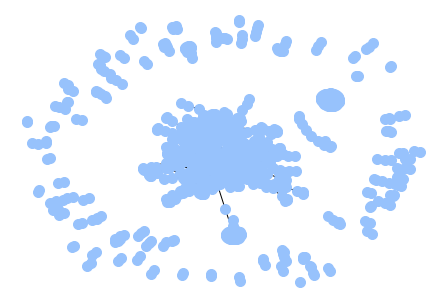

In [13]:
G_prova = nx.Graph()
G_prova.add_edges_from(prova)
nx.draw(G_prova, node_color='#97C2FC', node_size=100, edge_color='black', node_shape='o')

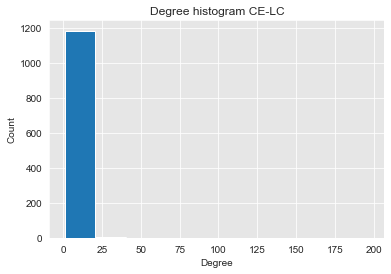

In [14]:
plot_degree_dist(G_prova)
plt.title("Degree histogram CE-LC")
plt.savefig("histC4G2ris.png")

In [15]:




ba_net_cc = nx.average_clustering(G_prova)
print('Grafo 3 network average cluster coefficient: ' + str(ba_net_cc) + '\n')

ba_net_cc = nx.density(G_prova)
print("Grafo 3: "+str(ba_net_cc))

Grafo 3 network average cluster coefficient: 0.0015542062504413465

Grafo 3: 0.0017684555110963859


## Rete 2 inversa

In [24]:
m2 = multicoll(G2, motif)
m2



[{(0, '0'): (1, '0'),
  (0, '1'): (0, '1'),
  (0, '10'): (0, '10'),
  (0, '100'): (0, '100'),
  (0, '1000'): (0, '1000'),
  (0, '1001'): (0, '1001'),
  (0, '1002'): (0, '1002'),
  (0, '1003'): (0, '1003'),
  (0, '1004'): (0, '1004'),
  (0, '1005'): (0, '1005'),
  (0, '1006'): (0, '1006'),
  (0, '1007'): (0, '1007'),
  (0, '1008'): (0, '1008'),
  (0, '1009'): (0, '1009'),
  (0, '101'): (0, '101'),
  (0, '1010'): (0, '1010'),
  (0, '1011'): (0, '1011'),
  (0, '1012'): (0, '1012'),
  (0, '1013'): (0, '1013'),
  (0, '1014'): (0, '1014'),
  (0, '1015'): (0, '1015'),
  (0, '1016'): (0, '1016'),
  (0, '1017'): (0, '1017'),
  (0, '1018'): (0, '1018'),
  (0, '1019'): (0, '1019'),
  (0, '102'): (0, '102'),
  (0, '1020'): (0, '1020'),
  (0, '1021'): (0, '1021'),
  (0, '1022'): (0, '1022'),
  (0, '1023'): (0, '1023'),
  (0, '1024'): (0, '1024'),
  (0, '1025'): (0, '1025'),
  (0, '1026'): (0, '1026'),
  (0, '1027'): (0, '1027'),
  (0, '1028'): (0, '1028'),
  (0, '1029'): (0, '1029'),
  (0, '103'): 

In [25]:
mapping2 = memo(m2, 3)



In [26]:
G2_finale = [(22, '0'), (0, '1'), (0, '10'), (0, '100'), (0, '1000'), (0, '1001'), (0, '1002'), (0, '1003'), (0, '1004'), (0, '1005'), (0, '1006'), (0, '1007'), (0, '1008'), (0, '1009'), (1, '101'), (0, '1010'), (0, '1011'), (0, '1012'), (0, '1013'), (0, '1014'), (0, '1015'), (0, '1016'), (0, '1017'), (0, '1018'), (1, '1019'), (0, '1020'), (0, '1021'), (0, '1022'), (0, '1023'), (0, '1024'), (0, '1025'), (0, '1026'), (0, '1027'), (0, '1028'), (0, '1029'), (0, '103'), (0, '1030'), (0, '1031'), (0, '1032'), (0, '1033'), (0, '1034'), (0, '1035'), (0, '1036'), (0, '1037'), (0, '1038'), (1, '1039'), (0, '104'), (0, '1041'), (0, '1042'), (0, '1043'), (0, '1044'), (0, '1045'), (0, '1046'), (0, '1047'), (0, '1048'), (0, '1049'), (0, '1050'), (0, '1051'), (0, '1052'), (0, '1053'), (0, '1054'), (0, '1055'), (0, '1056'), (0, '1057'), (0, '1058'), (0, '1059'), (0, '106'), (0, '1060'), (0, '1061'), (0, '1062'), (0, '1063'), (0, '1064'), (0, '1065'), (0, '1066'), (0, '1067'), (0, '1068'), (0, '1069'), (0, '107'), (0, '1070'), (0, '1071'), (0, '1072'), (0, '1073'), (0, '1074'), (0, '1075'), (0, '1076'), (0, '1077'), (0, '1078'), (0, '1079'), (0, '108'), (0, '1080'), (0, '1081'), (0, '1082'), (0, '1083'), (0, '1084'), (0, '1085'), (0, '1086'), (0, '1087'), (0, '1088'), (0, '1089'), (0, '109'), (0, '1090'), (0, '1091'), (0, '1092'), (0, '1093'), (0, '1094'), (0, '1095'), (0, '1096'), (0, '1097'), (0, '1098'), (0, '1099'), (0, '11'), (0, '110'), (0, '1100'), (0, '1101'), (0, '1102'), (0, '1103'), (0, '1104'), (0, '1105'), (0, '1106'), (0, '1107'), (0, '1108'), (0, '1109'), (0, '111'), (0, '1110'), (0, '1111'), (0, '1112'), (0, '1113'), (0, '1114'), (0, '1115'), (0, '1116'), (0, '1117'), (0, '1118'), (0, '1119'), (0, '112'), (0, '1120'), (0, '1121'), (0, '1122'), (0, '1123'), (0, '1124'), (0, '1125'), (1, '1126'), (0, '1128'), (0, '1129'), (0, '113'), (0, '1130'), (0, '1131'), (0, '1132'), (0, '1133'), (0, '1134'), (0, '1135'), (0, '1136'), (0, '1137'), (0, '1138'), (0, '1139'), (2, '114'), (0, '1140'), (0, '1141'), (0, '1142'), (0, '1144'), (0, '1145'), (0, '1146'), (0, '1147'), (0, '1148'), (0, '1149'), (0, '1150'), (0, '1151'), (1, '1152'), (0, '1153'), (0, '1154'), (0, '1155'), (0, '1156'), (0, '1157'), (0, '1158'), (0, '1159'), (0, '116'), (0, '1160'), (0, '1163'), (0, '1164'), (0, '1166'), (0, '1167'), (0, '1168'), (0, '1169'), (0, '1170'), (0, '1171'), (0, '1172'), (0, '1173'), (0, '1174'), (0, '1175'), (0, '1176'), (0, '1177'), (0, '1178'), (0, '1179'), (0, '118'), (0, '1180'), (0, '1181'), (0, '1182'), (0, '1183'), (0, '1184'), (0, '1185'), (0, '1186'), (0, '1187'), (0, '1188'), (0, '1189'), (0, '119'), (0, '1190'), (0, '1191'), (0, '1192'), (0, '1193'), (0, '1194'), (1, '1195'), (0, '1198'), (0, '1199'), (0, '12'), (0, '1200'), (0, '1201'), (0, '1202'), (0, '1203'), (0, '1204'), (0, '1205'), (0, '1206'), (0, '1207'), (0, '1208'), (0, '1209'), (0, '121'), (0, '1210'), (0, '1211'), (0, '1212'), (0, '1213'), (0, '1214'), (0, '1215'), (0, '1216'), (0, '1217'), (0, '1218'), (0, '1219'), (0, '1220'), (0, '1221'), (0, '1222'), (0, '1223'), (0, '1224'), (0, '1225'), (0, '1226'), (0, '1227'), (0, '1228'), (0, '1229'), (0, '123'), (0, '1230'), (0, '1231'), (0, '1232'), (0, '1233'), (0, '1234'), (0, '1235'), (0, '1236'), (0, '1237'), (0, '1238'), (0, '1239'), (0, '1240'), (0, '1241'), (0, '1242'), (0, '1243'), (0, '1244'), (0, '1245'), (0, '1246'), (0, '1247'), (0, '1248'), (0, '1249'), (0, '125'), (0, '1250'), (0, '1251'), (0, '1252'), (0, '1253'), (0, '1254'), (0, '1255'), (0, '1256'), (0, '1257'), (0, '1258'), (0, '1259'), (0, '126'), (0, '1260'), (0, '1261'), (0, '1262'), (0, '1263'), (0, '1264'), (0, '1265'), (0, '1266'), (0, '1267'), (0, '1268'), (0, '1269'), (0, '127'), (0, '1270'), (0, '1271'), (0, '1272'), (0, '1273'), (0, '1274'), (0, '1275'), (0, '1276'), (0, '1277'), (0, '1278'), (0, '1279'), (0, '1280'), (0, '1281'), (0, '1282'), (0, '1283'), (0, '1284'), (0, '1285'), (0, '1286'), (0, '1287'), (0, '1288'), (0, '1289'), (0, '129'), (0, '1290'), (0, '1291'), (0, '1292'), (0, '1293'), (0, '1294'), (0, '1295'), (0, '1296'), (0, '1297'), (0, '1298'), (0, '1299'), (0, '13'), (0, '130'), (0, '1300'), (0, '1301'), (0, '1302'), (0, '1303'), (0, '1304'), (0, '1305'), (0, '1306'), (0, '1307'), (0, '1308'), (0, '1309'), (2, '131'), (0, '1310'), (0, '1311'), (0, '1312'), (0, '1313'), (0, '1314'), (0, '1315'), (0, '1316'), (0, '1317'), (0, '1318'), (0, '1319'), (0, '1320'), (0, '1321'), (0, '1322'), (0, '1325'), (0, '1326'), (0, '1327'), (0, '1328'), (0, '1329'), (1, '133'), (0, '1330'), (0, '1331'), (1, '1332'), (0, '1333'), (0, '1334'), (0, '1335'), (0, '1336'), (0, '1337'), (0, '1338'), (0, '1339'), (0, '1340'), (1, '1341'), (0, '1344'), (0, '1345'), (0, '1346'), (1, '1347'), (0, '1348'), (0, '1349'), (0, '1350'), (0, '1351'), (0, '1352'), (0, '1353'), (0, '1354'), (0, '1355'), (0, '1356'), (0, '1357'), (0, '1358'), (0, '1359'), (0, '1360'), (0, '1361'), (0, '1362'), (0, '1363'), (0, '1364'), (0, '1365'), (0, '1366'), (0, '1367'), (0, '1368'), (0, '1369'), (0, '1370'), (0, '1371'), (0, '1372'), (0, '1373'), (0, '1374'), (0, '1375'), (0, '1376'), (0, '1377'), (0, '1378'), (0, '1379'), (0, '138'), (0, '1380'), (0, '1381'), (0, '1382'), (0, '1383'), (0, '1384'), (0, '1385'), (0, '1386'), (0, '139'), (0, '14'), (0, '140'), (0, '141'), (0, '142'), (5, '143'), (0, '144'), (0, '145'), (0, '147'), (0, '149'), (0, '15'), (0, '150'), (0, '151'), (0, '152'), (0, '156'), (0, '157'), (0, '158'), (1, '159'), (0, '16'), (0, '162'), (0, '163'), (0, '164'), (3, '165'), (0, '17'), (0, '176'), (0, '177'), (0, '178'), (0, '181'), (0, '182'), (0, '186'), (0, '187'), (0, '189'), (2, '190'), (0, '191'), (2, '192'), (0, '196'), (0, '197'), (2, '198'), (0, '199'), (0, '20'), (0, '200'), (0, '201'), (0, '202'), (0, '203'), (0, '204'), (0, '205'), (0, '206'), (0, '207'), (0, '208'), (0, '209'), (0, '21'), (2, '210'), (0, '211'), (0, '212'), (0, '213'), (0, '214'), (0, '215'), (1, '216'), (2, '217'), (0, '218'), (0, '219'), (2, '220'), (0, '222'), (0, '223'), (0, '224'), (0, '225'), (0, '226'), (0, '227'), (0, '228'), (0, '229'), (0, '232'), (0, '233'), (1, '234'), (0, '235'), (0, '237'), (0, '238'), (0, '239'), (1, '24'), (0, '241'), (0, '242'), (0, '243'), (0, '244'), (0, '245'), (0, '246'), (0, '248'), (0, '249'), (0, '250'), (0, '251'), (1, '252'), (0, '255'), (0, '256'), (0, '257'), (0, '260'), (0, '261'), (0, '262'), (0, '263'), (0, '264'), (0, '265'), (1, '266'), (0, '269'), (0, '27'), (0, '270'), (0, '271'), (0, '272'), (0, '273'), (1, '274'), (0, '275'), (0, '276'), (0, '277'), (0, '278'), (0, '28'), (0, '280'), (0, '281'), (0, '282'), (0, '283'), (0, '285'), (0, '286'), (0, '287'), (3, '288'), (0, '289'), (0, '290'), (0, '292'), (0, '294'), (0, '295'), (1, '296'), (0, '297'), (0, '298'), (0, '299'), (0, '30'), (0, '300'), (0, '301'), (0, '307'), (0, '308'), (0, '309'), (0, '310'), (0, '311'), (3, '312'), (0, '319'), (0, '32'), (0, '320'), (0, '321'), (0, '322'), (0, '323'), (0, '324'), (0, '325'), (0, '326'), (0, '328'), (2, '329'), (0, '33'), (0, '330'), (0, '334'), (0, '335'), (0, '338'), (0, '339'), (0, '34'), (0, '340'), (0, '343'), (0, '344'), (0, '345'), (0, '346'), (0, '347'), (0, '348'), (0, '349'), (0, '35'), (0, '350'), (0, '351'), (0, '352'), (0, '353'), (0, '354'), (0, '358'), (0, '359'), (0, '36'), (0, '361'), (0, '362'), (0, '363'), (0, '364'), (0, '365'), (0, '366'), (0, '367'), (0, '368'), (0, '369'), (0, '370'), (0, '371'), (0, '372'), (0, '373'), (0, '374'), (0, '375'), (0, '376'), (0, '377'), (0, '38'), (0, '380'), (0, '381'), (0, '382'), (0, '383'), (0, '384'), (0, '385'), (0, '386'), (0, '387'), (0, '388'), (0, '389'), (0, '39'), (0, '390'), (0, '391'), (0, '392'), (0, '393'), (0, '394'), (0, '395'), (0, '396'), (0, '397'), (0, '398'), (0, '399'), (0, '4'), (0, '400'), (0, '401'), (1, '402'), (0, '405'), (0, '406'), (0, '407'), (0, '408'), (0, '409'), (0, '41'), (0, '410'), (0, '411'), (0, '413'), (2, '414'), (0, '417'), (0, '42'), (0, '420'), (0, '421'), (0, '422'), (0, '423'), (0, '426'), (0, '428'), (0, '429'), (0, '43'), (0, '432'), (0, '433'), (0, '434'), (0, '435'), (0, '436'), (0, '437'), (0, '438'), (0, '439'), (0, '44'), (0, '440'), (0, '441'), (0, '442'), (0, '443'), (0, '444'), (0, '445'), (0, '447'), (0, '448'), (0, '449'), (0, '45'), (0, '450'), (0, '451'), (0, '452'), (0, '453'), (0, '454'), (0, '455'), (0, '457'), (0, '458'), (1, '459'), (0, '46'), (0, '461'), (0, '463'), (0, '464'), (0, '465'), (0, '466'), (0, '467'), (1, '468'), (0, '469'), (0, '47'), (0, '470'), (0, '471'), (0, '472'), (0, '473'), (0, '474'), (0, '475'), (0, '476'), (0, '477'), (0, '48'), (0, '481'), (0, '482'), (0, '483'), (0, '486'), (0, '487'), (1, '49'), (0, '492'), (0, '493'), (0, '494'), (0, '495'), (0, '496'), (0, '497'), (0, '498'), (1, '499'), (0, '503'), (0, '505'), (0, '506'), (0, '507'), (0, '508'), (0, '509'), (0, '510'), (0, '511'), (0, '512'), (0, '513'), (0, '514'), (0, '515'), (0, '516'), (0, '517'), (1, '518'), (0, '521'), (0, '522'), (0, '524'), (0, '526'), (0, '528'), (1, '53'), (0, '532'), (0, '535'), (0, '536'), (0, '537'), (0, '538'), (0, '539'), (0, '54'), (0, '542'), (0, '543'), (0, '544'), (0, '545'), (0, '547'), (0, '548'), (0, '55'), (0, '550'), (0, '551'), (0, '552'), (0, '553'), (0, '556'), (0, '557'), (0, '558'), (0, '559'), (0, '56'), (0, '560'), (0, '561'), (0, '562'), (0, '563'), (0, '564'), (0, '565'), (0, '566'), (0, '567'), (0, '568'), (0, '569'), (0, '570'), (0, '571'), (0, '572'), (0, '573'), (0, '574'), (0, '575'), (0, '576'), (0, '577'), (0, '578'), (0, '579'), (0, '580'), (0, '583'), (0, '584'), (0, '585'), (0, '586'), (0, '587'), (0, '588'), (0, '589'), (0, '59'), (0, '590'), (0, '593'), (0, '594'), (0, '595'), (0, '596'), (0, '597'), (0, '598'), (0, '599'), (0, '6'), (0, '60'), (0, '600'), (0, '601'), (0, '602'), (0, '604'), (0, '605'), (0, '606'), (0, '607'), (0, '608'), (0, '61'), (0, '610'), (0, '611'), (0, '612'), (0, '613'), (0, '614'), (0, '615'), (0, '617'), (0, '618'), (0, '619'), (0, '62'), (0, '620'), (0, '621'), (0, '622'), (0, '623'), (0, '624'), (0, '625'), (0, '626'), (0, '627'), (0, '628'), (0, '629'), (0, '63'), (0, '630'), (0, '631'), (0, '632'), (0, '633'), (0, '634'), (0, '635'), (0, '636'), (0, '637'), (0, '638'), (0, '639'), (0, '640'), (0, '641'), (0, '642'), (0, '643'), (0, '644'), (0, '645'), (0, '646'), (0, '647'), (0, '648'), (0, '649'), (0, '65'), (0, '650'), (0, '653'), (0, '654'), (0, '655'), (0, '656'), (0, '657'), (0, '658'), (0, '659'), (0, '66'), (0, '660'), (0, '661'), (0, '663'), (0, '664'), (0, '665'), (0, '666'), (0, '667'), (0, '668'), (0, '669'), (0, '67'), (0, '671'), (0, '672'), (0, '673'), (0, '674'), (0, '675'), (0, '676'), (0, '677'), (0, '678'), (0, '679'), (0, '68'), (0, '680'), (0, '681'), (0, '682'), (0, '683'), (0, '684'), (0, '685'), (0, '686'), (0, '687'), (0, '688'), (0, '689'), (0, '69'), (0, '690'), (0, '691'), (0, '692'), (0, '693'), (0, '694'), (0, '695'), (0, '696'), (0, '697'), (0, '698'), (0, '699'), (0, '70'), (0, '700'), (0, '701'), (0, '702'), (0, '703'), (0, '704'), (0, '705'), (0, '708'), (0, '709'), (0, '71'), (0, '710'), (0, '711'), (0, '712'), (0, '713'), (0, '714'), (0, '715'), (0, '716'), (0, '717'), (0, '718'), (0, '719'), (0, '720'), (0, '721'), (0, '722'), (0, '723'), (0, '724'), (0, '725'), (1, '726'), (0, '728'), (0, '730'), (0, '731'), (0, '732'), (0, '733'), (0, '734'), (0, '735'), (0, '736'), (0, '737'), (0, '738'), (0, '739'), (0, '740'), (0, '741'), (0, '742'), (0, '743'), (0, '745'), (0, '746'), (0, '747'), (0, '748'), (0, '749'), (0, '750'), (0, '751'), (0, '752'), (0, '753'), (0, '754'), (0, '755'), (0, '756'), (0, '757'), (0, '758'), (0, '759'), (0, '760'), (0, '761'), (0, '762'), (0, '763'), (0, '764'), (0, '765'), (0, '766'), (0, '767'), (0, '768'), (0, '769'), (0, '77'), (0, '770'), (1, '771'), (0, '772'), (0, '775'), (0, '776'), (0, '777'), (0, '778'), (0, '779'), (0, '780'), (0, '781'), (0, '782'), (0, '783'), (0, '784'), (0, '785'), (0, '786'), (0, '787'), (0, '788'), (0, '789'), (0, '790'), (0, '791'), (0, '792'), (0, '793'), (0, '794'), (0, '795'), (0, '796'), (0, '797'), (0, '798'), (0, '799'), (0, '8'), (0, '800'), (0, '801'), (0, '802'), (0, '803'), (0, '804'), (0, '805'), (0, '806'), (0, '807'), (0, '808'), (0, '809'), (0, '810'), (0, '811'), (0, '812'), (0, '813'), (0, '814'), (0, '815'), (0, '816'), (0, '817'), (0, '818'), (0, '819'), (0, '82'), (0, '820'), (0, '821'), (0, '822'), (0, '823'), (0, '824'), (0, '825'), (0, '826'), (0, '827'), (1, '828'), (0, '831'), (0, '832'), (0, '833'), (0, '834'), (0, '835'), (0, '837'), (0, '838'), (0, '839'), (0, '84'), (0, '840'), (0, '841'), (0, '842'), (0, '843'), (0, '844'), (0, '845'), (0, '846'), (0, '847'), (0, '848'), (0, '849'), (0, '85'), (0, '850'), (0, '851'), (0, '852'), (0, '853'), (0, '854'), (0, '855'), (0, '856'), (0, '857'), (0, '858'), (0, '859'), (0, '86'), (0, '860'), (0, '861'), (0, '862'), (0, '863'), (0, '864'), (0, '865'), (0, '866'), (0, '867'), (0, '868'), (0, '869'), (0, '87'), (0, '870'), (0, '871'), (0, '872'), (0, '873'), (0, '874'), (0, '875'), (0, '877'), (0, '878'), (0, '879'), (0, '881'), (0, '882'), (0, '883'), (0, '884'), (0, '885'), (0, '886'), (0, '887'), (0, '888'), (0, '889'), (0, '89'), (0, '891'), (0, '892'), (0, '893'), (0, '894'), (0, '895'), (0, '896'), (0, '897'), (0, '898'), (0, '899'), (0, '9'), (0, '90'), (0, '900'), (0, '901'), (0, '902'), (0, '903'), (0, '904'), (0, '905'), (0, '906'), (0, '907'), (0, '908'), (0, '91'), (0, '911'), (0, '912'), (0, '913'), (0, '915'), (0, '916'), (0, '917'), (0, '918'), (0, '919'), (0, '92'), (0, '920'), (0, '921'), (0, '922'), (0, '924'), (0, '925'), (0, '926'), (0, '927'), (0, '928'), (0, '929'), (0, '93'), (0, '930'), (0, '931'), (0, '932'), (0, '933'), (0, '934'), (0, '935'), (0, '936'), (0, '937'), (0, '938'), (0, '939'), (0, '94'), (0, '940'), (0, '941'), (0, '942'), (0, '943'), (0, '944'), (0, '945'), (0, '946'), (0, '947'), (0, '948'), (0, '949'), (0, '950'), (0, '951'), (0, '952'), (0, '953'), (0, '954'), (0, '955'), (0, '956'), (0, '957'), (0, '959'), (0, '96'), (0, '960'), (0, '961'), (0, '962'), (0, '963'), (0, '964'), (0, '965'), (0, '966'), (0, '967'), (0, '968'), (0, '969'), (0, '97'), (0, '970'), (0, '971'), (0, '972'), (0, '973'), (0, '974'), (0, '975'), (0, '976'), (0, '977'), (0, '978'), (0, '979'), (0, '98'), (0, '980'), (0, '981'), (0, '982'), (0, '983'), (0, '984'), (0, '985'), (0, '986'), (0, '987'), (0, '988'), (0, '989'), (0, '99'), (0, '990'), (0, '991'), (0, '992'), (0, '993'), (0, '994'), (0, '995'), (0, '996'), (0, '997'), (0, '998'), (0, '999')] 



In [27]:
G2_INV = inverti(G2_finale, mapping2)



KeyError: (9, '0')

In [28]:

nx.draw(G2_INV, node_color='#97C2FC', node_size=150, edge_color='black', node_shape='o')

NameError: name 'G2_INV' is not defined

***

# Rete 3

In [29]:
start_time = time.time()
res3 = multicoll(G3, motif)
print("--- %s seconds ---" % (time.time() - start_time))

{(0, '0'): (1, '0'), (0, '1'): (1, '0'), (0, '10'): (0, '10'), (0, '100'): (0, '100'), (0, '101'): (0, '101'), (0, '102'): (0, '102'), (0, '103'): (0, '103'), (0, '104'): (0, '104'), (0, '105'): (0, '105'), (0, '106'): (0, '106'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '11'): (0, '11'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (0, '12'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '13

{(1, '0'): (1, '0'), (0, '10'): (1, '10'), (0, '100'): (0, '100'), (0, '101'): (0, '101'), (0, '102'): (0, '102'), (0, '103'): (0, '103'), (0, '104'): (0, '104'), (0, '105'): (0, '105'), (0, '106'): (0, '106'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '11'): (1, '10'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '118'): (0, '118'), (0, '119'): (0, '119'), (0, '12'): (1, '10'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0,

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (0, '101'): (1, '101'), (0, '102'): (1, '101'), (0, '103'): (0, '103'), (0, '104'): (0, '104'), (0, '105'): (0, '105'), (0, '106'): (0, '106'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '119'): (0, '119'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'),

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (0, '103'): (1, '103'), (0, '104'): (0, '104'), (0, '105'): (0, '105'), (0, '106'): (1, '103'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '119'): (0, '119'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (0, '104'): (1, '104'), (0, '105'): (0, '105'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '119'): (0, '119'), (0, '120'): (0, '120'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (0, '105'): (1, '105'), (0, '107'): (0, '107'), (0, '108'): (0, '108'), (0, '109'): (0, '109'), (0, '110'): (0, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '119'): (0, '119'), (0, '120'): (1, '105'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (0, '110'): (1, '110'), (0, '111'): (0, '111'), (0, '112'): (0, '112'), (0, '113'): (0, '113'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '119'): (0, '119'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (0, '111'): (1, '111'), (0, '112'): (1, '111'), (0, '113'): (1, '111'), (0, '114'): (0, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '119'): (0, '119'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (1, '111'): (1, '111'), (0, '114'): (1, '114'), (0, '115'): (0, '115'), (0, '116'): (0, '116'), (0, '117'): (0, '117'), (0, '119'): (0, '119'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (1, '111'): (2, '111'), (1, '114'): (1, '114'), (0, '115'): (2, '111'), (0, '116'): (0, '116'), (0, '117'): (2, '111'), (0, '119'): (0, '119'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (0, '116'): (1, '116'), (0, '119'): (0, '119'), (0, '121'): (0, '121'), (0, '122'): (0, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (1, '119'): (1, '119'), (0, '122'): (1, '122'), (0, '123'): (0, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (0, '128'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (0, '130'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (1, '119'): (1, '119'), (1, '122'): (1, '122'), (0, '123'): (1, '123'), (0, '124'): (0, '124'), (0, '125'): (0, '125'), (0, '126'): (0, '126'), (0, '127'): (0, '127'), (0, '128'): (1, '123'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '130'): (1, '123'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (2, '119'): (2, '119'), (1, '122'): (1, '122'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (0, '126'): (1, '126'), (0, '127'): (0, '127'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (2, '119'): (3, '119'), (1, '122'): (1, '122'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '127'): (3, '119'), (0, '129'): (0, '129'), (0, '13'): (0, '13'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (3, '119'): (4, '119'), (1, '122'): (4, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '129'): (4, '119'), (0, '13'): (0, '13'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (4, '119'): (4, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '132'): (0, '132'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (0, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (0, '148'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (5, '119'): (5, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (0, '136'): (1, '136'), (0, '137'): (0, '137'), (0, '138'): (0, '138'), (0, '139'): (0, '139'), (0, '14'): (0, '14'), (0, '140'): (0, '140'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '148'): (1, '136'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (0, '139'): (1, '139'), (0, '14'): (0, '14'), (0, '140'): (1, '139'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (

{(1, '0'): (1, '0'), (1, '10'): (1, '10'), (1, '100'): (1, '100'), (1, '101'): (1, '101'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (0, '14'): (1, '14'), (0, '141'): (0, '141'), (0, '142'): (0, '142'), (0, '143'): (0, '143'), (0, '145'): (0, '145'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (

{(1, '0'): (1, '0'), (1, '10'): (2, '10'), (1, '100'): (1, '100'), (1, '101'): (2, '10'), (1, '103'): (1, '103'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '145'): (2, '10'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '149'): (0, '149'), (0, '150'): (0, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (1, '136'): (1, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '150'): (1, '150'), (0, '151'): (0, '151'), (0, '152'): (0, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0,

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (2, '136'): (2, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (0, '152'): (1, '152'), (0, '153'): (0, '153'), (0, '154'): (0, '154'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0,

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (2, '136'): (3, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (0, '154'): (3, '136'), (0, '155'): (0, '155'), (0, '156'): (0, '156'), (0, '157'): (0, '157'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (0, '160'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0,

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (3, '136'): (3, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (1, '155'): (1, '155'), (0, '156'): (1, '156'), (0, '157'): (1, '156'), (0, '158'): (0, '158'), (0, '159'): (0, '159'), (0, '16'): (0, '16'), (0, '160'): (1, '156'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0,

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (3, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (1, '155'): (1, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (0, '16'): (4, '136'), (0, '161'): (0, '161'), (0, '162'): (0, '162'), (0, '163'): (0, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (1, '155'): (1, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (1, '161'): (1, '161'), (0, '163'): (1, '163'), (0, '164'): (0, '164'), (0, '165'): (0, '165'), (0, '166'): (0, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (1, '155'): (1, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (2, '161'): (2, '161'), (0, '165'): (0, '165'), (0, '166'): (1, '166'), (0, '167'): (0, '167'), (0, '168'): (0, '168'), (0, '169'): (0, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (1, '155'): (1, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (1, '166'): (1, '166'), (0, '167'): (0, '167'), (0, '169'): (1, '169'), (0, '170'): (0, '170'), (0, '171'): (0, '171'), (0, '172'): (0, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (2, '100'): (2, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (1, '155'): (1, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (0, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '175'): (0, '175'), (0, '177'): (0, '177'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (3, '100'): (3, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (1, '155'): (1, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (0, '177'): (1, '177'), (0, '180'): (0, '180'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (3, '100'): (3, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (3, '100'): (3, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (3, '100'): (3, '100'), (1, '104'): (1, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (3, '100'): (3, '100'), (1, '104'): (2, '104'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (3, '100'): (4, '100'), (2, '104'): (4, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (1, '153'): (1, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (4, '100'): (4, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (1, '13'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (4, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (1, '13'): (5, '100'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), 

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (1, '110'): (1, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'),

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (2, '110'): (2, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'),

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (2, '110'): (2, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '156'): (1, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'),

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (1, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '156'): (2, '156'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'),

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (1, '116'): (1, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (1, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '14'): (4, '14'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (3, '156'): (4, '14'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), 

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (5, '116'): (5, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (1, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (5, '116'): (5, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (5, '116'): (5, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (5, '100'): (5, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (5, '116'): (5, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (6, '100'): (6, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (1, '114'), (5, '116'): (5, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (2, '166'): (2, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (6, '100'): (6, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (1, '114'): (2, '114'), (5, '116'): (5, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (3, '166'): (3, '166'), (0, '167'): (0, '167'), (1, '169'): (1, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (2, '10'): (2, '10'), (6, '100'): (6, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (2, '114'): (2, '114'), (5, '116'): (5, '116'), (6, '119'): (6, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (3, '166'): (3, '166'), (0, '167'): (0, '167'), (2, '169'): (2, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (3, '10'): (3, '10'), (6, '100'): (6, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (2, '114'): (2, '114'), (5, '116'): (5, '116'), (6, '119'): (7, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (3, '166'): (3, '166'), (0, '167'): (0, '167'), (2, '169'): (2, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (3, '10'): (3, '10'), (6, '100'): (6, '100'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (2, '114'): (2, '114'), (6, '116'): (6, '116'), (7, '119'): (7, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (3, '166'): (3, '166'), (0, '167'): (0, '167'), (2, '169'): (2, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'

{(1, '0'): (1, '0'), (7, '10'): (8, '10'), (1, '105'): (1, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (2, '114'): (2, '114'), (6, '116'): (6, '116'), (7, '119'): (7, '119'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (3, '166'): (3, '166'), (0, '167'): (0, '167'), (2, '169'): (2, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'), (0, '197'): (0, '197'

{(1, '0'): (1, '0'), (9, '10'): (9, '10'), (2, '105'): (2, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (2, '114'): (2, '114'), (6, '116'): (6, '116'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (3, '166'): (3, '166'), (0, '167'): (0, '167'), (2, '169'): (3, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'), (0, '197'): (0, '197'), (0, '198'): (0, '198'

{(1, '0'): (1, '0'), (10, '10'): (10, '10'), (2, '105'): (2, '105'), (1, '107'): (1, '107'), (4, '110'): (4, '110'), (2, '111'): (2, '111'), (2, '114'): (2, '114'), (6, '116'): (6, '116'), (1, '123'): (1, '123'), (0, '125'): (0, '125'), (2, '126'): (2, '126'), (0, '131'): (0, '131'), (0, '133'): (0, '133'), (0, '134'): (0, '134'), (0, '135'): (0, '135'), (4, '136'): (4, '136'), (0, '137'): (0, '137'), (1, '139'): (1, '139'), (1, '141'): (1, '141'), (0, '146'): (0, '146'), (0, '147'): (0, '147'), (1, '152'): (1, '152'), (2, '153'): (2, '153'), (2, '155'): (2, '155'), (1, '158'): (1, '158'), (3, '161'): (3, '161'), (0, '165'): (0, '165'), (4, '166'): (4, '166'), (0, '167'): (0, '167'), (3, '169'): (3, '169'), (0, '171'): (0, '171'), (1, '172'): (1, '172'), (0, '173'): (0, '173'), (0, '174'): (0, '174'), (1, '177'): (1, '177'), (0, '181'): (0, '181'), (2, '183'): (2, '183'), (1, '190'): (1, '190'), (1, '192'): (1, '192'), (1, '196'): (1, '196'), (0, '197'): (0, '197'), (0, '198'): (0, '19

In [30]:
res3

[(0,
  (924,
   [(0, '0'),
    (0, '1'),
    (0, '10'),
    (0, '100'),
    (0, '101'),
    (0, '102'),
    (0, '103'),
    (0, '104'),
    (0, '105'),
    (0, '106'),
    (0, '107'),
    (0, '108'),
    (0, '109'),
    (0, '11'),
    (0, '110'),
    (0, '111'),
    (0, '112'),
    (0, '113'),
    (0, '114'),
    (0, '115'),
    (0, '116'),
    (0, '117'),
    (0, '118'),
    (0, '119'),
    (0, '12'),
    (0, '120'),
    (0, '121'),
    (0, '122'),
    (0, '123'),
    (0, '124'),
    (0, '125'),
    (0, '126'),
    (0, '127'),
    (0, '128'),
    (0, '129'),
    (0, '13'),
    (0, '130'),
    (0, '131'),
    (0, '132'),
    (0, '133'),
    (0, '134'),
    (0, '135'),
    (0, '136'),
    (0, '137'),
    (0, '138'),
    (0, '139'),
    (0, '14'),
    (0, '140'),
    (0, '141'),
    (0, '142'),
    (0, '143'),
    (0, '144'),
    (0, '145'),
    (0, '146'),
    (0, '147'),
    (0, '148'),
    (0, '149'),
    (0, '15'),
    (0, '150'),
    (0, '151'),
    (0, '152'),
    (0, '153'),
    (

In [31]:
livello3, num_nodi3, nodi3, archi3 = [], [], [], []
for i in res3:
    livello3.append(i[0])
    num_nodi3.append(i[1][0])
    nodi3.append(i[1][1])
    archi3.append(i[1][2])

print("Livello: ", livello3, "\n# nodi: ", num_nodi3,
      "\nNodi: ", nodi3, "\nArchi: ", archi3, "\n\n")

Livello:  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10] 
# nodi:  [924, 902, 888, 886, 882, 878, 750, 740, 738, 730, 726] 
Nodi:  [[(0, '0'), (0, '1'), (0, '10'), (0, '100'), (0, '101'), (0, '102'), (0, '103'), (0, '104'), (0, '105'), (0, '106'), (0, '107'), (0, '108'), (0, '109'), (0, '11'), (0, '110'), (0, '111'), (0, '112'), (0, '113'), (0, '114'), (0, '115'), (0, '116'), (0, '117'), (0, '118'), (0, '119'), (0, '12'), (0, '120'), (0, '121'), (0, '122'), (0, '123'), (0, '124'), (0, '125'), (0, '126'), (0, '127'), (0, '128'), (0, '129'), (0, '13'), (0, '130'), (0, '131'), (0, '132'), (0, '133'), (0, '134'), (0, '135'), (0, '136'), (0, '137'), (0, '138'), (0, '139'), (0, '14'), (0, '140'), (0, '141'), (0, '142'), (0, '143'), (0, '144'), (0, '145'), (0, '146'), (0, '147'), (0, '148'), (0, '149'), (0, '15'), (0, '150'), (0, '151'), (0, '152'), (0, '153'), (0, '154'), (0, '155'), (0, '156'), (0, '157'), (0, '158'), (0, '159'), (0, '16'), (0, '160'), (0, '161'), (0, '162'), (0, '163'), (0, '164'), (0

In [32]:
for i in res3:
    print("Livello: ", i[0], "\n# nodi: ", i[1][0], "\nNodi: ",
          i[1][1], "\n\n")

Livello:  0 
# nodi:  924 
Nodi:  [(0, '0'), (0, '1'), (0, '10'), (0, '100'), (0, '101'), (0, '102'), (0, '103'), (0, '104'), (0, '105'), (0, '106'), (0, '107'), (0, '108'), (0, '109'), (0, '11'), (0, '110'), (0, '111'), (0, '112'), (0, '113'), (0, '114'), (0, '115'), (0, '116'), (0, '117'), (0, '118'), (0, '119'), (0, '12'), (0, '120'), (0, '121'), (0, '122'), (0, '123'), (0, '124'), (0, '125'), (0, '126'), (0, '127'), (0, '128'), (0, '129'), (0, '13'), (0, '130'), (0, '131'), (0, '132'), (0, '133'), (0, '134'), (0, '135'), (0, '136'), (0, '137'), (0, '138'), (0, '139'), (0, '14'), (0, '140'), (0, '141'), (0, '142'), (0, '143'), (0, '144'), (0, '145'), (0, '146'), (0, '147'), (0, '148'), (0, '149'), (0, '15'), (0, '150'), (0, '151'), (0, '152'), (0, '153'), (0, '154'), (0, '155'), (0, '156'), (0, '157'), (0, '158'), (0, '159'), (0, '16'), (0, '160'), (0, '161'), (0, '162'), (0, '163'), (0, '164'), (0, '165'), (0, '166'), (0, '167'), (0, '168'), (0, '169'), (0, '17'), (0, '170'), (0, '

[((0, '0'), (0, '1')), ((0, '0'), (0, '2')), ((0, '0'), (0, '3')), ((0, '0'), (0, '4')), ((0, '1'), (0, '652')), ((0, '1'), (0, '2')), ((0, '1'), (0, '653')), ((0, '1'), (0, '654')), ((0, '1'), (0, '655')), ((0, '2'), (0, '3')), ((0, '2'), (0, '832')), ((0, '2'), (0, '4')), ((0, '2'), (0, '342')), ((0, '3'), (0, '106')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (0, '7')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (0, '10')), ((0, '5'), (0, '11')), ((0, '5'), (0, '12')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (0, '15')), ((0, '6'), (0, '50')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (0, '51')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (0, '7')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (0, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '12')), (

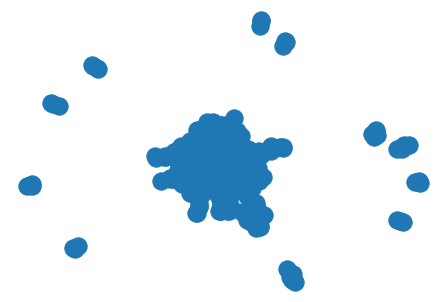

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (1, '101')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (1, '10')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (1, '100')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (0, '51')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '14')), ((0, '6'), (1, '100')), ((0, '6'), (0, '645')), ((0, '6'), (0, '673')), ((1, '101'), (1, '101')), ((1, '101'), (1, '103')), ((1, 

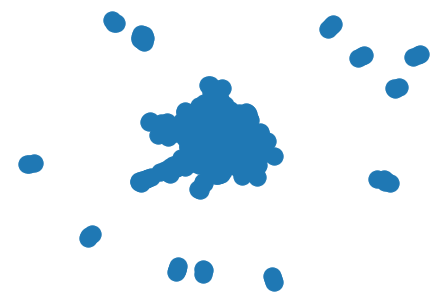

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (1, '101')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (1, '10')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (1, '100')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (1, '122')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '14')), ((0, '6'), (1, '100')), ((0, '6'), (0, '645')), ((0, '6'), (0, '673')), ((1, '101'), (1, '101')), ((1, '101'), (1, '103')), ((1,

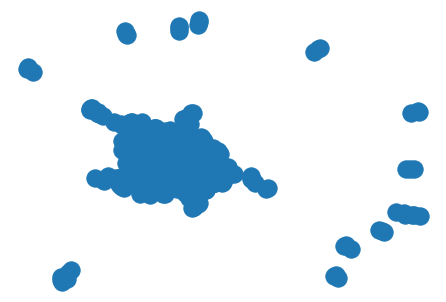

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (1, '101')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (1, '10')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (1, '100')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (1, '122')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '14')), ((0, '6'), (1, '100')), ((0, '6'), (0, '645')), ((0, '6'), (0, '673')), ((1, '101'), (1, '101')), ((1, '101'), (1, '103')), ((1,

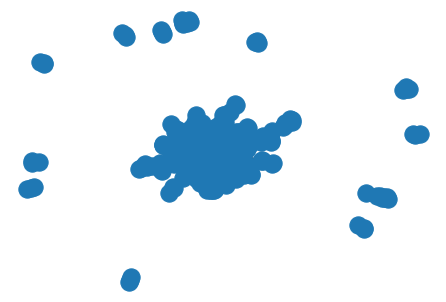

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((1, '13'), (0, '6')), ((1, '13'), (1, '101')), ((1, '13'), (1, '13')), ((1, '13'), (0, '9')), ((1, '13'), (1, '10')), ((1, '13'), (0, '14')), ((1, '13'), (1, '100')), ((1, '13'), (1, '104')), ((1, '13'), (0, '272')), ((1, '13'), (0, '214')), ((1, '13'), (0, '259')), ((1, '13'), (0, '634')), ((1, '13'), (0, '645')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (4, '119')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '

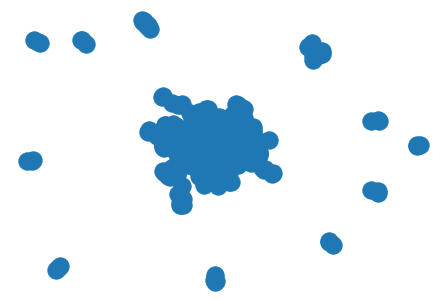

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((1, '13'), (0, '6')), ((1, '13'), (1, '101')), ((1, '13'), (1, '13')), ((1, '13'), (0, '9')), ((1, '13'), (1, '10')), ((1, '13'), (0, '14')), ((1, '13'), (1, '100')), ((1, '13'), (1, '104')), ((1, '13'), (0, '272')), ((1, '13'), (0, '214')), ((1, '13'), (0, '259')), ((1, '13'), (0, '634')), ((1, '13'), (0, '645')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (5, '119')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '

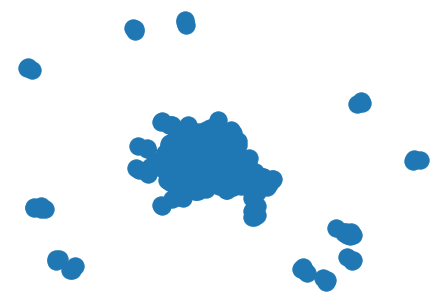

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (6, '100')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((6, '100'), (0, '6')), ((6, '100'), (3, '10')), ((6, '100'), (6, '100')), ((6, '100'), (0, '9')), ((6, '100'), (5, '116')), ((6, '100'), (1, '211')), ((6, '100'), (0, '634')), ((6, '100'), (0, '645')), ((6, '100'), (6, '119')), ((6, '100'), (3, '161')), ((6, '100'), (0, '270')), ((6, '100'), (1, '105')), ((6, '100'), (0, '275')), ((6, '100'), (0, '372')), ((6, '100'), (0, '440')), ((6, '100'), (0, '465')), ((6, '100'), (0, '276')), ((6, '100'), (0, '277')), ((6, '100'), (0, '499')), ((6, '100'), (4, '110')), ((6, '100'), (0, '462')), ((6, '100'), (0, '542')), ((6, '100'), (0, '281')), ((6, '100'), (0, '283')), ((6, '100'), (3, '166')), ((6, '100'), (0, '285'))

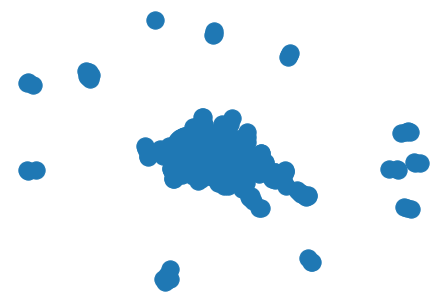

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (7, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((7, '10'), (0, '6')), ((7, '10'), (7, '10')), ((7, '10'), (0, '9')), ((7, '10'), (6, '116')), ((7, '10'), (1, '211')), ((7, '10'), (0, '634')), ((7, '10'), (0, '645')), ((7, '10'), (7, '119')), ((7, '10'), (3, '161')), ((7, '10'), (1, '105')), ((7, '10'), (0, '275')), ((7, '10'), (0, '372')), ((7, '10'), (0, '440')), ((7, '10'), (0, '465')), ((7, '10'), (0, '276')), ((7, '10'), (0, '277')), ((7, '10'), (0, '499')), ((7, '10'), (4, '110')), ((7, '10'), (0, '462')), ((7, '10'), (0, '542')), ((7, '10'), (0, '281')), ((7, '10'), (0, '283')), ((7, '10'), (3, '166')), ((7, '10'), (0, '285')), ((7, '10'), (0, '289')), ((7, '10'), (0, '293')), ((7, '10'), (2, '114')), 

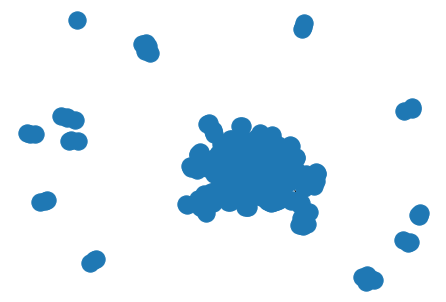

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (8, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((8, '10'), (0, '6')), ((8, '10'), (8, '10')), ((8, '10'), (0, '9')), ((8, '10'), (6, '116')), ((8, '10'), (1, '211')), ((8, '10'), (0, '634')), ((8, '10'), (0, '645')), ((8, '10'), (7, '119')), ((8, '10'), (3, '161')), ((8, '10'), (1, '105')), ((8, '10'), (0, '275')), ((8, '10'), (0, '372')), ((8, '10'), (0, '440')), ((8, '10'), (0, '465')), ((8, '10'), (0, '276')), ((8, '10'), (0, '277')), ((8, '10'), (0, '499')), ((8, '10'), (4, '110')), ((8, '10'), (0, '462')), ((8, '10'), (0, '542')), ((8, '10'), (0, '281')), ((8, '10'), (0, '283')), ((8, '10'), (3, '166')), ((8, '10'), (0, '285')), ((8, '10'), (0, '289')), ((8, '10'), (0, '293')), ((8, '10'), (2, '114')), 

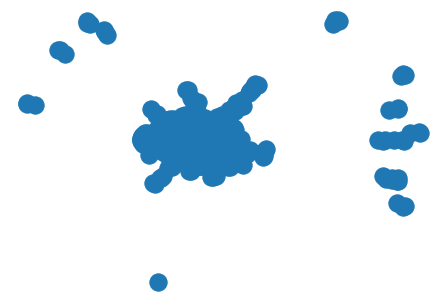

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (9, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((9, '10'), (0, '6')), ((9, '10'), (9, '10')), ((9, '10'), (0, '9')), ((9, '10'), (6, '116')), ((9, '10'), (1, '211')), ((9, '10'), (0, '634')), ((9, '10'), (0, '645')), ((9, '10'), (3, '161')), ((9, '10'), (2, '105')), ((9, '10'), (0, '275')), ((9, '10'), (0, '372')), ((9, '10'), (0, '440')), ((9, '10'), (0, '465')), ((9, '10'), (0, '499')), ((9, '10'), (4, '110')), ((9, '10'), (0, '462')), ((9, '10'), (0, '542')), ((9, '10'), (3, '169')), ((9, '10'), (0, '283')), ((9, '10'), (4, '166')), ((9, '10'), (0, '285')), ((9, '10'), (0, '293')), ((9, '10'), (2, '114')), ((9, '10'), (0, '295')), ((9, '10'), (0, '381')), ((9, '10'), (0, '296')), ((9, '10'), (0, '382')), 

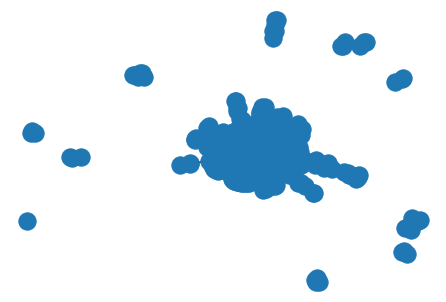

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (10, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((10, '10'), (0, '6')), ((10, '10'), (10, '10')), ((10, '10'), (0, '9')), ((10, '10'), (6, '116')), ((10, '10'), (1, '211')), ((10, '10'), (0, '634')), ((10, '10'), (0, '645')), ((10, '10'), (3, '161')), ((10, '10'), (2, '105')), ((10, '10'), (0, '275')), ((10, '10'), (0, '372')), ((10, '10'), (0, '440')), ((10, '10'), (0, '465')), ((10, '10'), (0, '499')), ((10, '10'), (4, '110')), ((10, '10'), (0, '462')), ((10, '10'), (0, '542')), ((10, '10'), (3, '169')), ((10, '10'), (0, '283')), ((10, '10'), (4, '166')), ((10, '10'), (0, '285')), ((10, '10'), (2, '114')), ((10, '10'), (0, '295')), ((10, '10'), (0, '381')), ((10, '10'), (0, '296')), ((10, '10'), (0, '382')

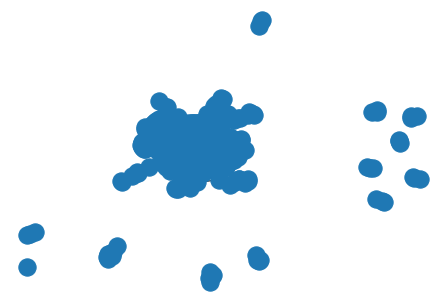

In [33]:
for i in archi3:
    print(i)
    GG = nx.Graph()
    GG.add_edges_from(i)
    plt.clf()
    nx.draw(GG)
    plt.pause(1)
    plt.show()

[((0, '0'), (0, '1')), ((0, '0'), (0, '2')), ((0, '0'), (0, '3')), ((0, '0'), (0, '4')), ((0, '1'), (0, '652')), ((0, '1'), (0, '2')), ((0, '1'), (0, '653')), ((0, '1'), (0, '654')), ((0, '1'), (0, '655')), ((0, '2'), (0, '3')), ((0, '2'), (0, '832')), ((0, '2'), (0, '4')), ((0, '2'), (0, '342')), ((0, '3'), (0, '106')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (0, '7')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (0, '10')), ((0, '5'), (0, '11')), ((0, '5'), (0, '12')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (0, '15')), ((0, '6'), (0, '50')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (0, '51')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (0, '7')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (0, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '12')), (

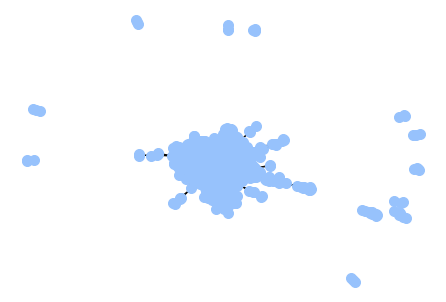

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (1, '101')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (1, '10')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (1, '100')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (0, '51')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '14')), ((0, '6'), (1, '100')), ((0, '6'), (0, '645')), ((0, '6'), (0, '673')), ((1, '101'), (1, '101')), ((1, '101'), (1, '103')), ((1, 

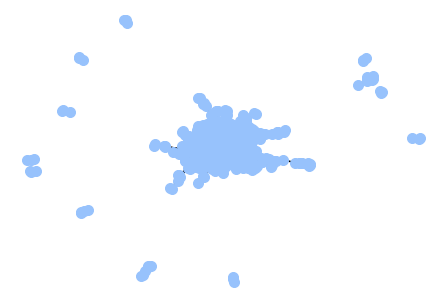

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (1, '101')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (1, '10')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (1, '100')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (1, '122')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '14')), ((0, '6'), (1, '100')), ((0, '6'), (0, '645')), ((0, '6'), (0, '673')), ((1, '101'), (1, '101')), ((1, '101'), (1, '103')), ((1,

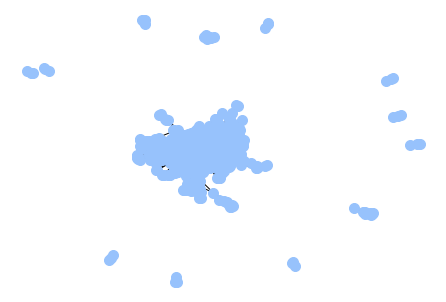

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((0, '5'), (0, '6')), ((0, '5'), (1, '101')), ((0, '5'), (0, '8')), ((0, '5'), (0, '9')), ((0, '5'), (1, '10')), ((0, '5'), (0, '13')), ((0, '5'), (0, '14')), ((0, '5'), (1, '100')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (1, '122')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '14')), ((0, '6'), (1, '100')), ((0, '6'), (0, '645')), ((0, '6'), (0, '673')), ((1, '101'), (1, '101')), ((1, '101'), (1, '103')), ((1,

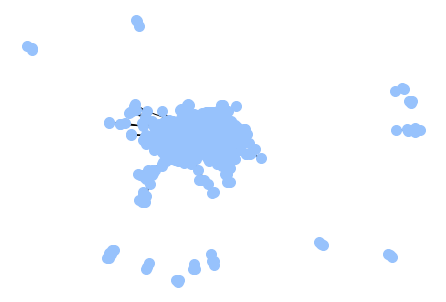

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((1, '13'), (0, '6')), ((1, '13'), (1, '101')), ((1, '13'), (1, '13')), ((1, '13'), (0, '9')), ((1, '13'), (1, '10')), ((1, '13'), (0, '14')), ((1, '13'), (1, '100')), ((1, '13'), (1, '104')), ((1, '13'), (0, '272')), ((1, '13'), (0, '214')), ((1, '13'), (0, '259')), ((1, '13'), (0, '634')), ((1, '13'), (0, '645')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (4, '119')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '

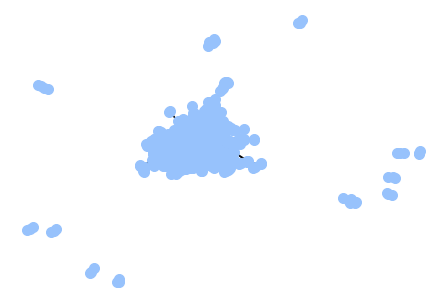

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (1, '103')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((1, '13'), (0, '6')), ((1, '13'), (1, '101')), ((1, '13'), (1, '13')), ((1, '13'), (0, '9')), ((1, '13'), (1, '10')), ((1, '13'), (0, '14')), ((1, '13'), (1, '100')), ((1, '13'), (1, '104')), ((1, '13'), (0, '272')), ((1, '13'), (0, '214')), ((1, '13'), (0, '259')), ((1, '13'), (0, '634')), ((1, '13'), (0, '645')), ((0, '6'), (1, '103')), ((0, '6'), (0, '252')), ((0, '6'), (0, '261')), ((0, '6'), (5, '119')), ((0, '6'), (0, '542')), ((0, '6'), (0, '234')), ((0, '6'), (0, '272')), ((0, '6'), (0, '206')), ((0, '6'), (1, '101')), ((0, '6'), (0, '267')), ((0, '6'), (0, '543')), ((0, '6'), (1, '10')), ((0, '6'), (0, '212')), ((0, '6'), (0, '274')), ((0, '6'), (0, '

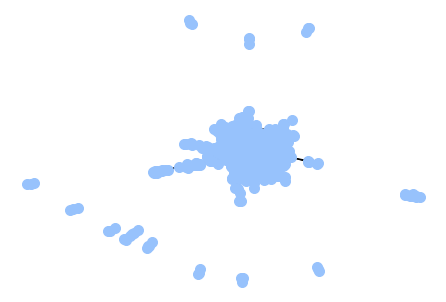

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (6, '100')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((6, '100'), (0, '6')), ((6, '100'), (3, '10')), ((6, '100'), (6, '100')), ((6, '100'), (0, '9')), ((6, '100'), (5, '116')), ((6, '100'), (1, '211')), ((6, '100'), (0, '634')), ((6, '100'), (0, '645')), ((6, '100'), (6, '119')), ((6, '100'), (3, '161')), ((6, '100'), (0, '270')), ((6, '100'), (1, '105')), ((6, '100'), (0, '275')), ((6, '100'), (0, '372')), ((6, '100'), (0, '440')), ((6, '100'), (0, '465')), ((6, '100'), (0, '276')), ((6, '100'), (0, '277')), ((6, '100'), (0, '499')), ((6, '100'), (4, '110')), ((6, '100'), (0, '462')), ((6, '100'), (0, '542')), ((6, '100'), (0, '281')), ((6, '100'), (0, '283')), ((6, '100'), (3, '166')), ((6, '100'), (0, '285'))

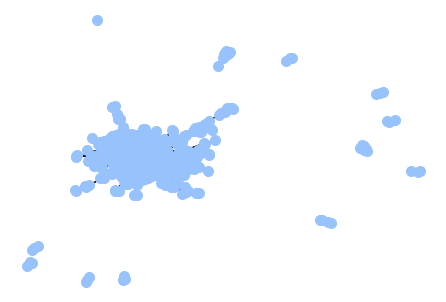

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (7, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((7, '10'), (0, '6')), ((7, '10'), (7, '10')), ((7, '10'), (0, '9')), ((7, '10'), (6, '116')), ((7, '10'), (1, '211')), ((7, '10'), (0, '634')), ((7, '10'), (0, '645')), ((7, '10'), (7, '119')), ((7, '10'), (3, '161')), ((7, '10'), (1, '105')), ((7, '10'), (0, '275')), ((7, '10'), (0, '372')), ((7, '10'), (0, '440')), ((7, '10'), (0, '465')), ((7, '10'), (0, '276')), ((7, '10'), (0, '277')), ((7, '10'), (0, '499')), ((7, '10'), (4, '110')), ((7, '10'), (0, '462')), ((7, '10'), (0, '542')), ((7, '10'), (0, '281')), ((7, '10'), (0, '283')), ((7, '10'), (3, '166')), ((7, '10'), (0, '285')), ((7, '10'), (0, '289')), ((7, '10'), (0, '293')), ((7, '10'), (2, '114')), 

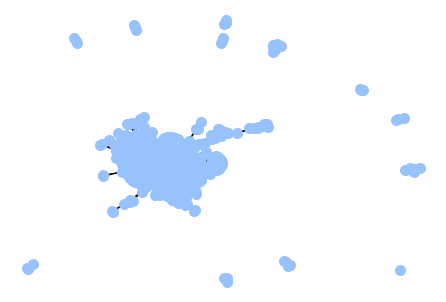

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (8, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((8, '10'), (0, '6')), ((8, '10'), (8, '10')), ((8, '10'), (0, '9')), ((8, '10'), (6, '116')), ((8, '10'), (1, '211')), ((8, '10'), (0, '634')), ((8, '10'), (0, '645')), ((8, '10'), (7, '119')), ((8, '10'), (3, '161')), ((8, '10'), (1, '105')), ((8, '10'), (0, '275')), ((8, '10'), (0, '372')), ((8, '10'), (0, '440')), ((8, '10'), (0, '465')), ((8, '10'), (0, '276')), ((8, '10'), (0, '277')), ((8, '10'), (0, '499')), ((8, '10'), (4, '110')), ((8, '10'), (0, '462')), ((8, '10'), (0, '542')), ((8, '10'), (0, '281')), ((8, '10'), (0, '283')), ((8, '10'), (3, '166')), ((8, '10'), (0, '285')), ((8, '10'), (0, '289')), ((8, '10'), (0, '293')), ((8, '10'), (2, '114')), 

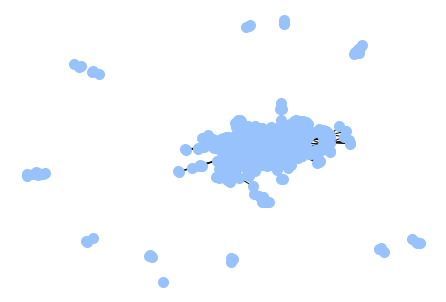

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (9, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((9, '10'), (0, '6')), ((9, '10'), (9, '10')), ((9, '10'), (0, '9')), ((9, '10'), (6, '116')), ((9, '10'), (1, '211')), ((9, '10'), (0, '634')), ((9, '10'), (0, '645')), ((9, '10'), (3, '161')), ((9, '10'), (2, '105')), ((9, '10'), (0, '275')), ((9, '10'), (0, '372')), ((9, '10'), (0, '440')), ((9, '10'), (0, '465')), ((9, '10'), (0, '499')), ((9, '10'), (4, '110')), ((9, '10'), (0, '462')), ((9, '10'), (0, '542')), ((9, '10'), (3, '169')), ((9, '10'), (0, '283')), ((9, '10'), (4, '166')), ((9, '10'), (0, '285')), ((9, '10'), (0, '293')), ((9, '10'), (2, '114')), ((9, '10'), (0, '295')), ((9, '10'), (0, '381')), ((9, '10'), (0, '296')), ((9, '10'), (0, '382')), 

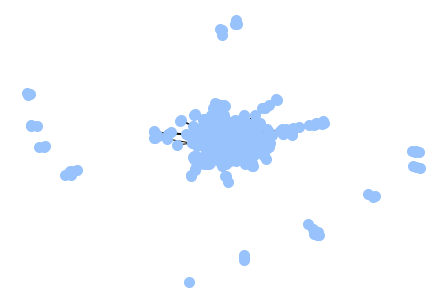

[((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (10, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((10, '10'), (0, '6')), ((10, '10'), (10, '10')), ((10, '10'), (0, '9')), ((10, '10'), (6, '116')), ((10, '10'), (1, '211')), ((10, '10'), (0, '634')), ((10, '10'), (0, '645')), ((10, '10'), (3, '161')), ((10, '10'), (2, '105')), ((10, '10'), (0, '275')), ((10, '10'), (0, '372')), ((10, '10'), (0, '440')), ((10, '10'), (0, '465')), ((10, '10'), (0, '499')), ((10, '10'), (4, '110')), ((10, '10'), (0, '462')), ((10, '10'), (0, '542')), ((10, '10'), (3, '169')), ((10, '10'), (0, '283')), ((10, '10'), (4, '166')), ((10, '10'), (0, '285')), ((10, '10'), (2, '114')), ((10, '10'), (0, '295')), ((10, '10'), (0, '381')), ((10, '10'), (0, '296')), ((10, '10'), (0, '382')

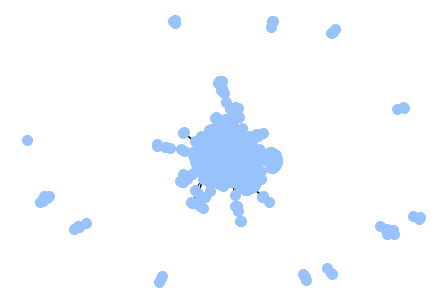

In [34]:
for i in archi3:
    print(i)
    GG = nx.Graph()
    GG.add_edges_from(i)
    plt.clf()
    #nx.draw(GG)
    nx.draw(GG, node_color='#97C2FC', node_size=100, edge_color='black', node_shape='o')
    plt.pause(1)
    plt.show()

In [35]:
print("Rete 3: ", nodes_decrease(num_nodi3))

Rete 3:  (198, 21.428571428571427, 726, 78.57142857142857)


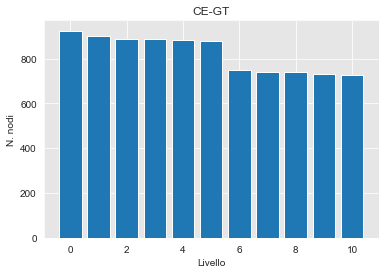

In [17]:
livelli =  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  
nnodi =  [924, 902, 888, 886, 882, 878, 750, 740, 738, 730, 726] 

plt.bar(livelli, nnodi)
plt.xlabel("Livello")
plt.ylabel("N. nodi")

plt.title("CE-GT")
plt.savefig("livelliC4G3.png")

In [18]:
prova = [((1, '0'), (1, '0')), ((1, '0'), (0, '3')), ((1, '0'), (0, '4')), ((1, '0'), (0, '652')), ((1, '0'), (0, '653')), ((1, '0'), (0, '654')), ((1, '0'), (0, '655')), ((1, '0'), (0, '832')), ((1, '0'), (0, '342')), ((0, '3'), (10, '10')), ((0, '4'), (0, '509')), ((0, '4'), (0, '796')), ((0, '4'), (0, '765')), ((0, '4'), (0, '654')), ((10, '10'), (0, '6')), ((10, '10'), (10, '10')), ((10, '10'), (0, '9')), ((10, '10'), (6, '116')), ((10, '10'), (1, '211')), ((10, '10'), (0, '634')), ((10, '10'), (0, '645')), ((10, '10'), (3, '161')), ((10, '10'), (2, '105')), ((10, '10'), (0, '275')), ((10, '10'), (0, '372')), ((10, '10'), (0, '440')), ((10, '10'), (0, '465')), ((10, '10'), (0, '499')), ((10, '10'), (4, '110')), ((10, '10'), (0, '462')), ((10, '10'), (0, '542')), ((10, '10'), (3, '169')), ((10, '10'), (0, '283')), ((10, '10'), (4, '166')), ((10, '10'), (0, '285')), ((10, '10'), (2, '114')), ((10, '10'), (0, '295')), ((10, '10'), (0, '381')), ((10, '10'), (0, '296')), ((10, '10'), (0, '382')), ((10, '10'), (0, '740')), ((10, '10'), (0, '297')), ((10, '10'), (0, '500')), ((10, '10'), (2, '153')), ((10, '10'), (0, '784')), ((10, '10'), (0, '408')), ((10, '10'), (1, '215')), ((10, '10'), (1, '298')), ((10, '10'), (0, '299')), ((10, '10'), (0, '744')), ((10, '10'), (0, '799')), ((10, '10'), (0, '802')), ((10, '10'), (0, '300')), ((10, '10'), (0, '302')), ((10, '10'), (0, '303')), ((10, '10'), (1, '141')), ((10, '10'), (0, '814')), ((10, '10'), (0, '304')), ((10, '10'), (0, '798')), ((10, '10'), (0, '543')), ((10, '10'), (0, '486')), ((10, '10'), (0, '845')), ((10, '10'), (0, '487')), ((10, '10'), (0, '847')), ((10, '10'), (0, '305')), ((10, '10'), (0, '307')), ((10, '10'), (0, '441')), ((10, '10'), (0, '411')), ((10, '10'), (0, '311')), ((10, '10'), (0, '491')), ((10, '10'), (0, '887')), ((10, '10'), (0, '314')), ((10, '10'), (0, '316')), ((10, '10'), (0, '318')), ((10, '10'), (0, '392')), ((10, '10'), (0, '492')), ((10, '10'), (0, '319')), ((10, '10'), (0, '321')), ((10, '10'), (0, '869')), ((10, '10'), (0, '894')), ((10, '10'), (0, '324')), ((10, '10'), (0, '897')), ((10, '10'), (0, '820')), ((10, '10'), (0, '821')), ((10, '10'), (0, '642')), ((10, '10'), (0, '331')), ((10, '10'), (0, '332')), ((10, '10'), (0, '776')), ((10, '10'), (1, '192')), ((10, '10'), (1, '190')), ((10, '10'), (0, '96')), ((10, '10'), (0, '822')), ((10, '10'), (0, '334')), ((10, '10'), (3, '225')), ((10, '10'), (1, '258')), ((10, '10'), (0, '335')), ((10, '10'), (0, '336')), ((10, '10'), (2, '111')), ((10, '10'), (0, '870')), ((10, '10'), (0, '916')), ((10, '10'), (0, '30')), ((10, '10'), (0, '337')), ((10, '10'), (0, '471')), ((10, '10'), (0, '338')), ((10, '10'), (0, '918')), ((10, '10'), (0, '339')), ((10, '10'), (0, '340')), ((10, '10'), (0, '341')), ((10, '10'), (0, '342')), ((10, '10'), (0, '716')), ((10, '10'), (4, '136')), ((10, '10'), (0, '644')), ((10, '10'), (0, '343')), ((10, '10'), (0, '646')), ((10, '10'), (0, '344')), ((10, '10'), (0, '430')), ((10, '10'), (0, '345')), ((10, '10'), (1, '247')), ((10, '10'), (0, '346')), ((10, '10'), (0, '571')), ((10, '10'), (0, '67')), ((10, '10'), (0, '88')), ((10, '10'), (0, '91')), ((10, '10'), (0, '92')), ((10, '10'), (0, '717')), ((10, '10'), (0, '672')), ((10, '10'), (0, '615')), ((10, '10'), (0, '813')), ((10, '10'), (0, '718')), ((10, '10'), (0, '616')), ((10, '10'), (0, '617')), ((10, '10'), (0, '301')), ((10, '10'), (0, '829')), ((10, '10'), (0, '459')), ((10, '10'), (0, '914')), ((10, '10'), (0, '496')), ((10, '10'), (0, '789')), ((10, '10'), (0, '497')), ((10, '10'), (0, '49')), ((10, '10'), (0, '278')), ((10, '10'), (0, '279')), ((10, '10'), (0, '280')), ((10, '10'), (0, '282')), ((10, '10'), (0, '284')), ((10, '10'), (0, '286')), ((10, '10'), (0, '287')), ((10, '10'), (0, '288')), ((10, '10'), (0, '291')), ((10, '10'), (0, '292')), ((10, '10'), (0, '294')), ((10, '10'), (0, '308')), ((10, '10'), (0, '309')), ((10, '10'), (0, '310')), ((10, '10'), (0, '312')), ((10, '10'), (0, '313')), ((10, '10'), (0, '315')), ((10, '10'), (0, '320')), ((10, '10'), (0, '322')), ((10, '10'), (0, '323')), ((10, '10'), (0, '325')), ((10, '10'), (0, '326')), ((10, '10'), (0, '327')), ((10, '10'), (0, '328')), ((10, '10'), (0, '329')), ((10, '10'), (0, '330')), ((10, '10'), (0, '333')), ((10, '10'), (0, '371')), ((10, '10'), (0, '720')), ((10, '10'), (0, '722')), ((10, '10'), (0, '793')), ((10, '10'), (0, '746')), ((10, '10'), (0, '505')), ((10, '10'), (0, '833')), ((10, '10'), (0, '815')), ((10, '10'), (0, '751')), ((10, '10'), (0, '816')), ((10, '10'), (0, '762')), ((10, '10'), (0, '529')), ((10, '10'), (0, '389')), ((10, '10'), (0, '484')), ((10, '10'), (0, '858')), ((10, '10'), (0, '414')), ((10, '10'), (0, '859')), ((10, '10'), (0, '635')), ((10, '10'), (0, '443')), ((10, '10'), (0, '728')), ((10, '10'), (0, '619')), ((10, '10'), (0, '59')), ((10, '10'), (1, '250')), ((10, '10'), (0, '208')), ((10, '10'), (0, '444')), ((10, '10'), (0, '445')), ((10, '10'), (0, '446')), ((10, '10'), (0, '447')), ((10, '10'), (0, '804')), ((10, '10'), (0, '439')), ((10, '10'), (0, '823')), ((10, '10'), (0, '753')), ((10, '10'), (0, '824')), ((10, '10'), (0, '683')), ((10, '10'), (0, '448')), ((10, '10'), (0, '146')), ((10, '10'), (0, '147')), ((10, '10'), (0, '548')), ((10, '10'), (0, '376')), ((10, '10'), (0, '377')), ((10, '10'), (0, '622')), ((10, '10'), (0, '378')), ((10, '10'), (0, '379')), ((10, '10'), (0, '706')), ((10, '10'), (0, '385')), ((10, '10'), (0, '386')), ((10, '10'), (0, '387')), ((10, '10'), (0, '388')), ((10, '10'), (0, '707')), ((10, '10'), (0, '475')), ((10, '10'), (1, '172')), ((10, '10'), (0, '488')), ((10, '10'), (0, '390')), ((10, '10'), (0, '489')), ((10, '10'), (0, '708')), ((10, '10'), (0, '709')), ((10, '10'), (0, '412')), ((10, '10'), (0, '413')), ((10, '10'), (0, '710')), ((10, '10'), (0, '711')), ((10, '10'), (0, '393')), ((10, '10'), (0, '394')), ((10, '10'), (0, '518')), ((10, '10'), (0, '395')), ((10, '10'), (0, '712')), ((10, '10'), (0, '713')), ((10, '10'), (0, '396')), ((10, '10'), (0, '714')), ((10, '10'), (0, '715')), ((10, '10'), (0, '399')), ((10, '10'), (0, '400')), ((10, '10'), (0, '570')), ((10, '10'), (0, '406')), ((10, '10'), (0, '375')), ((10, '10'), (0, '380')), ((10, '10'), (0, '383')), ((10, '10'), (0, '384')), ((10, '10'), (0, '391')), ((10, '10'), (0, '397')), ((10, '10'), (0, '398')), ((10, '10'), (0, '401')), ((10, '10'), (0, '402')), ((10, '10'), (0, '404')), ((10, '10'), (0, '405')), ((10, '10'), (0, '640')), ((10, '10'), (0, '831')), ((10, '10'), (0, '774')), ((10, '10'), (0, '493')), ((10, '10'), (2, '126')), ((10, '10'), (1, '107')), ((10, '10'), (1, '24')), ((10, '10'), (0, '417')), ((10, '10'), (0, '424')), ((10, '10'), (0, '766')), ((10, '10'), (0, '825')), ((10, '10'), (0, '867')), ((10, '10'), (0, '868')), ((10, '10'), (0, '38')), ((10, '10'), (1, '152')), ((10, '10'), (0, '428')), ((10, '10'), (1, '158')), ((10, '10'), (0, '725')), ((10, '10'), (0, '638')), ((10, '10'), (0, '610')), ((10, '10'), (0, '611')), ((10, '10'), (0, '416')), ((10, '10'), (0, '66')), ((10, '10'), (0, '68')), ((10, '10'), (0, '72')), ((10, '10'), (0, '75')), ((10, '10'), (0, '76')), ((10, '10'), (0, '60')), ((10, '10'), (0, '63')), ((10, '10'), (0, '80')), ((10, '10'), (0, '264')), ((10, '10'), (0, '466')), ((10, '10'), (1, '123')), ((10, '10'), (0, '513')), ((10, '10'), (0, '662')), ((10, '10'), (0, '698')), ((10, '10'), (0, '777')), ((10, '10'), (0, '817')), ((10, '10'), (0, '419')), ((10, '10'), (0, '485')), ((10, '10'), (0, '851')), ((10, '10'), (0, '853')), ((10, '10'), (0, '476')), ((10, '10'), (0, '81')), ((10, '10'), (0, '890')), ((10, '10'), (0, '850')), ((10, '10'), (0, '131')), ((10, '10'), (0, '82')), ((10, '10'), (0, '83')), ((10, '10'), (0, '84')), ((10, '10'), (0, '73')), ((10, '10'), (0, '85')), ((10, '10'), (0, '86')), ((10, '10'), (0, '137')), ((10, '10'), (0, '477')), ((10, '10'), (0, '478')), ((10, '10'), (0, '905')), ((10, '10'), (0, '906')), ((10, '10'), (0, '125')), ((10, '10'), (0, '133')), ((10, '10'), (0, '134')), ((10, '10'), (0, '135')), ((10, '10'), (0, '767')), ((10, '10'), (0, '861')), ((10, '10'), (0, '481')), ((10, '10'), (0, '482')), ((10, '10'), (0, '483')), ((10, '10'), (0, '490')), ((10, '10'), (0, '494')), ((10, '10'), (0, '495')), ((10, '10'), (0, '498')), ((10, '10'), (0, '473')), ((10, '10'), (0, '765')), ((10, '10'), (0, '198')), ((10, '10'), (0, '64')), ((10, '10'), (0, '852')), ((10, '10'), (0, '888')), ((10, '10'), (0, '891')), ((10, '10'), (0, '892')), ((0, '6'), (1, '211')), ((0, '6'), (6, '116')), ((0, '6'), (0, '542')), ((0, '6'), (3, '225')), ((0, '6'), (0, '543')), ((0, '6'), (0, '645')), ((0, '6'), (0, '673')), ((0, '9'), (2, '114')), ((0, '9'), (0, '798')), ((0, '9'), (0, '642')), ((0, '9'), (0, '645')), ((6, '116'), (6, '116')), ((6, '116'), (1, '211')), ((6, '116'), (0, '542')), ((6, '116'), (2, '153')), ((6, '116'), (3, '225')), ((6, '116'), (0, '543')), ((6, '116'), (2, '114')), ((6, '116'), (0, '903')), ((6, '116'), (0, '634')), ((6, '116'), (0, '471')), ((6, '116'), (0, '340')), ((6, '116'), (0, '645')), ((6, '116'), (0, '636')), ((6, '116'), (0, '673')), ((6, '116'), (1, '258')), ((6, '116'), (2, '126')), ((6, '116'), (3, '161')), ((6, '116'), (4, '166')), ((6, '116'), (1, '215')), ((6, '116'), (0, '682')), ((6, '116'), (0, '515')), ((6, '116'), (0, '517')), ((6, '116'), (0, '411')), ((6, '116'), (4, '136')), ((6, '116'), (1, '152')), ((6, '116'), (1, '196')), ((6, '116'), (2, '111')), ((6, '116'), (1, '158')), ((6, '116'), (0, '510')), ((6, '116'), (3, '169')), ((6, '116'), (0, '724')), ((6, '116'), (0, '725')), ((6, '116'), (0, '726')), ((6, '116'), (0, '727')), ((6, '116'), (0, '728')), ((6, '116'), (0, '412')), ((6, '116'), (0, '780')), ((6, '116'), (0, '339')), ((6, '116'), (0, '805')), ((6, '116'), (0, '424')), ((6, '116'), (0, '410')), ((6, '116'), (0, '427')), ((6, '116'), (0, '428')), ((6, '116'), (0, '432')), ((6, '116'), (0, '350')), ((6, '116'), (0, '415')), ((6, '116'), (0, '429')), ((6, '116'), (0, '433')), ((6, '116'), (0, '416')), ((6, '116'), (0, '430')), ((6, '116'), (0, '431')), ((6, '116'), (0, '327')), ((6, '116'), (0, '635')), ((6, '116'), (0, '619')), ((6, '116'), (0, '371')), ((6, '116'), (0, '440')), ((6, '116'), (0, '763')), ((6, '116'), (0, '774')), ((6, '116'), (0, '816')), ((6, '116'), (0, '443')), ((6, '116'), (0, '365')), ((6, '116'), (0, '353')), ((6, '116'), (0, '425')), ((6, '116'), (0, '426')), ((6, '116'), (0, '408')), ((6, '116'), (0, '895')), ((6, '116'), (0, '896')), ((4, '136'), (4, '136')), ((4, '136'), (2, '153')), ((4, '136'), (0, '60')), ((4, '136'), (0, '56')), ((4, '136'), (0, '62')), ((4, '136'), (0, '68')), ((4, '136'), (1, '250')), ((4, '136'), (1, '152')), ((4, '136'), (0, '72')), ((4, '136'), (0, '73')), ((4, '136'), (2, '155')), ((4, '136'), (0, '75')), ((4, '136'), (0, '76')), ((4, '136'), (0, '59')), ((4, '136'), (1, '196')), ((4, '136'), (0, '86')), ((4, '136'), (0, '777')), ((4, '136'), (0, '419')), ((4, '136'), (0, '921')), ((4, '136'), (0, '922')), ((4, '136'), (0, '66')), ((4, '136'), (0, '473')), ((4, '136'), (0, '448')), ((4, '136'), (4, '166')), ((4, '136'), (0, '512')), ((4, '136'), (0, '844')), ((4, '136'), (0, '364')), ((2, '153'), (0, '60')), ((2, '153'), (2, '153')), ((2, '153'), (0, '66')), ((2, '153'), (0, '68')), ((2, '153'), (0, '72')), ((2, '153'), (0, '76')), ((2, '153'), (1, '123')), ((2, '153'), (0, '62')), ((2, '153'), (0, '759')), ((2, '153'), (0, '474')), ((2, '153'), (1, '250')), ((2, '153'), (0, '776')), ((2, '153'), (0, '364')), ((2, '153'), (0, '75')), ((2, '153'), (0, '478')), ((2, '153'), (0, '59')), ((2, '153'), (0, '695')), ((2, '153'), (0, '448')), ((2, '153'), (0, '697')), ((2, '153'), (0, '910')), ((2, '153'), (0, '88')), ((2, '153'), (0, '473')), ((2, '153'), (2, '114')), ((1, '24'), (1, '172')), ((1, '24'), (1, '24')), ((1, '24'), (1, '258')), ((1, '24'), (0, '30')), ((1, '24'), (0, '305')), ((1, '24'), (0, '459')), ((1, '24'), (0, '855')), ((1, '24'), (0, '335')), ((1, '24'), (0, '856')), ((1, '24'), (0, '857')), ((1, '24'), (0, '497')), ((1, '172'), (1, '172')), ((1, '172'), (2, '114')), ((1, '172'), (0, '457')), ((1, '172'), (0, '550')), ((1, '172'), (0, '30')), ((1, '172'), (0, '497')), ((1, '172'), (3, '161')), ((1, '172'), (4, '166')), ((1, '172'), (3, '169')), ((1, '172'), (0, '800')), ((1, '172'), (0, '843')), ((1, '172'), (0, '316')), ((1, '172'), (0, '460')), ((1, '172'), (0, '458')), ((1, '172'), (0, '459')), ((1, '172'), (0, '461')), ((1, '258'), (1, '258')), ((1, '258'), (0, '912')), ((1, '258'), (0, '332')), ((1, '258'), (0, '30')), ((1, '258'), (4, '166')), ((1, '258'), (0, '645')), ((1, '258'), (0, '497')), ((1, '258'), (1, '211')), ((1, '258'), (3, '161')), ((1, '258'), (0, '588')), ((1, '258'), (0, '415')), ((1, '258'), (0, '599')), ((1, '258'), (0, '920')), ((0, '32'), (1, '139')), ((0, '32'), (2, '126')), ((0, '32'), (0, '35')), ((0, '32'), (1, '240')), ((1, '139'), (1, '139')), ((1, '139'), (2, '126')), ((1, '139'), (2, '105')), ((1, '139'), (1, '240')), ((1, '139'), (3, '225')), ((1, '139'), (1, '242')), ((1, '139'), (0, '35')), ((1, '139'), (3, '169')), ((1, '139'), (1, '247')), ((1, '139'), (0, '684')), ((2, '126'), (2, '126')), ((2, '126'), (0, '436')), ((2, '126'), (2, '105')), ((2, '126'), (1, '240')), ((2, '126'), (1, '242')), ((2, '126'), (0, '450')), ((2, '126'), (0, '426')), ((2, '126'), (2, '114')), ((2, '126'), (0, '35')), ((2, '126'), (0, '451')), ((2, '126'), (0, '369')), ((2, '126'), (0, '452')), ((2, '126'), (0, '370')), ((2, '126'), (0, '453')), ((2, '126'), (0, '454')), ((2, '126'), (3, '169')), ((2, '126'), (0, '455')), ((2, '126'), (1, '247')), ((2, '126'), (0, '88')), ((2, '126'), (0, '89')), ((2, '126'), (0, '92')), ((2, '126'), (0, '96')), ((2, '126'), (0, '98')), ((2, '126'), (1, '211')), ((2, '126'), (1, '107')), ((2, '126'), (0, '774')), ((0, '35'), (1, '240')), ((1, '240'), (2, '105')), ((1, '240'), (3, '225')), ((1, '240'), (1, '240')), ((1, '240'), (1, '242')), ((1, '240'), (3, '169')), ((1, '240'), (0, '684')), ((0, '38'), (1, '152')), ((0, '38'), (1, '196')), ((1, '152'), (1, '152')), ((1, '152'), (1, '158')), ((1, '152'), (1, '196')), ((1, '152'), (2, '183')), ((1, '152'), (0, '68')), ((1, '152'), (0, '59')), ((1, '152'), (0, '72')), ((1, '196'), (1, '196')), ((1, '196'), (1, '158')), ((1, '196'), (2, '183')), ((1, '196'), (1, '190')), ((0, '42'), (3, '161')), ((3, '161'), (0, '232')), ((3, '161'), (0, '358')), ((3, '161'), (3, '161')), ((3, '161'), (0, '511')), ((3, '161'), (0, '614')), ((3, '161'), (0, '165')), ((3, '161'), (0, '719')), ((3, '161'), (0, '167')), ((3, '161'), (0, '809')), ((3, '161'), (0, '835')), ((3, '161'), (4, '166')), ((3, '161'), (0, '836')), ((3, '161'), (0, '837')), ((3, '161'), (0, '748')), ((3, '161'), (0, '838')), ((3, '161'), (0, '839')), ((3, '161'), (0, '173')), ((3, '161'), (0, '840')), ((3, '161'), (0, '174')), ((3, '161'), (0, '841')), ((3, '161'), (0, '842')), ((3, '161'), (1, '177')), ((3, '161'), (0, '800')), ((3, '161'), (0, '457')), ((3, '161'), (3, '169')), ((3, '161'), (0, '879')), ((3, '161'), (0, '321')), ((3, '161'), (1, '215')), ((3, '161'), (0, '820')), ((3, '161'), (0, '460')), ((3, '161'), (0, '821')), ((3, '161'), (0, '171')), ((3, '161'), (0, '801')), ((3, '161'), (0, '915')), ((3, '161'), (0, '916')), ((3, '161'), (0, '823')), ((3, '161'), (0, '920')), ((3, '161'), (0, '605')), ((3, '161'), (0, '824')), ((3, '161'), (0, '607')), ((3, '161'), (1, '211')), ((0, '45'), (4, '166')), ((4, '166'), (0, '351')), ((4, '166'), (1, '211')), ((4, '166'), (0, '423')), ((4, '166'), (0, '512')), ((4, '166'), (0, '532')), ((4, '166'), (0, '545')), ((4, '166'), (0, '572')), ((4, '166'), (4, '166')), ((4, '166'), (0, '573')), ((4, '166'), (0, '574')), ((4, '166'), (0, '575')), ((4, '166'), (0, '576')), ((4, '166'), (0, '577')), ((4, '166'), (0, '578')), ((4, '166'), (0, '389')), ((4, '166'), (0, '304')), ((4, '166'), (0, '579')), ((4, '166'), (3, '169')), ((4, '166'), (0, '580')), ((4, '166'), (0, '581')), ((4, '166'), (0, '582')), ((4, '166'), (0, '457')), ((4, '166'), (0, '583')), ((4, '166'), (0, '584')), ((4, '166'), (0, '585')), ((4, '166'), (0, '586')), ((4, '166'), (0, '413')), ((4, '166'), (0, '587')), ((4, '166'), (0, '588')), ((4, '166'), (0, '589')), ((4, '166'), (0, '590')), ((4, '166'), (0, '591')), ((4, '166'), (0, '592')), ((4, '166'), (0, '593')), ((4, '166'), (0, '594')), ((4, '166'), (0, '595')), ((4, '166'), (0, '596')), ((4, '166'), (0, '597')), ((4, '166'), (0, '599')), ((4, '166'), (0, '600')), ((4, '166'), (0, '601')), ((4, '166'), (0, '602')), ((4, '166'), (0, '603')), ((4, '166'), (0, '604')), ((4, '166'), (0, '605')), ((4, '166'), (0, '606')), ((4, '166'), (2, '114')), ((4, '166'), (0, '607')), ((4, '166'), (0, '608')), ((4, '166'), (0, '721')), ((4, '166'), (0, '201')), ((4, '166'), (0, '848')), ((4, '166'), (0, '854')), ((4, '166'), (0, '880')), ((4, '166'), (0, '881')), ((4, '166'), (0, '882')), ((4, '166'), (0, '883')), ((4, '166'), (0, '884')), ((4, '166'), (0, '885')), ((4, '166'), (0, '886')), ((4, '166'), (3, '225')), ((4, '166'), (0, '633')), ((0, '52'), (4, '110')), ((4, '110'), (4, '110')), ((4, '110'), (1, '177')), ((4, '110'), (0, '502')), ((4, '110'), (0, '503')), ((4, '110'), (0, '504')), ((4, '110'), (0, '505')), ((4, '110'), (0, '506')), ((4, '110'), (0, '507')), ((4, '110'), (0, '508')), ((4, '110'), (3, '225')), ((4, '110'), (2, '111')), ((4, '110'), (0, '685')), ((4, '110'), (0, '521')), ((4, '110'), (0, '669')), ((4, '110'), (2, '105')), ((4, '110'), (0, '640')), ((4, '110'), (0, '618')), ((4, '110'), (0, '436')), ((4, '110'), (0, '865')), ((4, '110'), (0, '324')), ((4, '110'), (0, '619')), ((0, '55'), (0, '56')), ((0, '55'), (0, '57')), ((0, '55'), (0, '58')), ((0, '55'), (0, '59')), ((0, '56'), (0, '538')), ((0, '56'), (0, '90')), ((0, '56'), (0, '539')), ((0, '56'), (0, '66')), ((0, '56'), (0, '92')), ((0, '56'), (0, '540')), ((0, '56'), (0, '58')), ((0, '56'), (0, '76')), ((0, '56'), (0, '59')), ((0, '57'), (0, '58')), ((0, '58'), (0, '59')), ((0, '59'), (0, '446')), ((0, '59'), (0, '68')), ((0, '59'), (1, '250')), ((0, '59'), (0, '448')), ((0, '59'), (0, '76')), ((0, '60'), (0, '61')), ((0, '60'), (0, '62')), ((0, '60'), (0, '63')), ((0, '60'), (0, '64')), ((0, '60'), (0, '66')), ((0, '60'), (0, '67')), ((0, '60'), (0, '68')), ((0, '60'), (0, '69')), ((0, '60'), (0, '71')), ((0, '60'), (0, '72')), ((0, '60'), (0, '73')), ((0, '60'), (0, '75')), ((0, '60'), (0, '76')), ((0, '61'), (0, '62')), ((0, '62'), (0, '612')), ((0, '62'), (0, '695')), ((0, '62'), (0, '66')), ((0, '62'), (0, '613')), ((0, '62'), (0, '696')), ((0, '62'), (0, '448')), ((0, '62'), (0, '76')), ((0, '66'), (0, '819')), ((0, '66'), (0, '76')), ((0, '67'), (0, '68')), ((0, '68'), (0, '72')), ((0, '69'), (0, '76')), ((0, '71'), (0, '72')), ((0, '72'), (0, '76')), ((0, '73'), (1, '123')), ((0, '75'), (1, '123')), ((0, '76'), (0, '693')), ((0, '76'), (0, '819')), ((0, '76'), (0, '694')), ((0, '76'), (0, '448')), ((0, '77'), (1, '250')), ((1, '250'), (1, '250')), ((1, '250'), (0, '446')), ((1, '250'), (0, '803')), ((1, '250'), (0, '448')), ((1, '250'), (0, '863')), ((1, '250'), (0, '864')), ((1, '250'), (0, '804')), ((1, '250'), (0, '445')), ((1, '250'), (2, '105')), ((0, '80'), (0, '81')), ((0, '80'), (0, '82')), ((0, '80'), (0, '83')), ((0, '80'), (0, '84')), ((0, '80'), (0, '85')), ((0, '80'), (0, '86')), ((0, '82'), (0, '84')), ((0, '82'), (0, '85')), ((0, '82'), (0, '86')), ((0, '84'), (0, '817')), ((0, '84'), (0, '890')), ((0, '84'), (0, '85')), ((0, '84'), (0, '86')), ((0, '84'), (0, '804')), ((0, '85'), (0, '419')), ((0, '85'), (0, '86')), ((0, '86'), (0, '777')), ((0, '86'), (0, '817')), ((0, '86'), (0, '851')), ((0, '86'), (0, '874')), ((0, '86'), (0, '846')), ((0, '86'), (0, '890')), ((0, '86'), (0, '413')), ((0, '86'), (0, '923')), ((0, '88'), (0, '89')), ((0, '88'), (0, '90')), ((0, '88'), (0, '91')), ((0, '88'), (0, '92')), ((0, '88'), (0, '93')), ((0, '88'), (0, '94')), ((0, '88'), (0, '96')), ((0, '88'), (0, '97')), ((0, '88'), (0, '98')), ((0, '89'), (0, '91')), ((0, '89'), (0, '92')), ((0, '89'), (0, '96')), ((0, '89'), (0, '98')), ((0, '90'), (0, '352')), ((0, '90'), (0, '353')), ((0, '90'), (0, '539')), ((0, '90'), (0, '91')), ((0, '90'), (0, '92')), ((0, '90'), (0, '540')), ((0, '90'), (0, '96')), ((0, '90'), (1, '107')), ((0, '91'), (0, '428')), ((0, '91'), (0, '705')), ((0, '91'), (0, '431')), ((0, '92'), (1, '141')), ((0, '92'), (0, '444')), ((0, '92'), (0, '774')), ((0, '92'), (0, '93')), ((0, '92'), (0, '94')), ((0, '92'), (0, '96')), ((0, '92'), (0, '97')), ((0, '92'), (0, '98')), ((0, '92'), (1, '107')), ((0, '94'), (0, '96')), ((0, '96'), (0, '97')), ((0, '96'), (0, '98')), ((0, '96'), (1, '107')), ((2, '105'), (2, '105')), ((2, '105'), (0, '436')), ((2, '105'), (0, '450')), ((2, '105'), (0, '426')), ((2, '105'), (0, '517')), ((2, '105'), (2, '114')), ((2, '105'), (0, '451')), ((2, '105'), (0, '369')), ((2, '105'), (0, '370')), ((2, '105'), (0, '453')), ((2, '105'), (0, '621')), ((2, '105'), (0, '454')), ((2, '105'), (3, '169')), ((2, '105'), (0, '455')), ((2, '105'), (1, '247')), ((2, '105'), (0, '446')), ((2, '105'), (0, '860')), ((1, '107'), (1, '107')), ((1, '107'), (0, '428')), ((1, '107'), (0, '862')), ((1, '107'), (1, '211')), ((1, '107'), (0, '493')), ((2, '111'), (2, '111')), ((2, '111'), (2, '114')), ((2, '111'), (0, '669')), ((2, '111'), (0, '805')), ((2, '111'), (1, '211')), ((2, '111'), (0, '788')), ((2, '111'), (3, '225')), ((2, '111'), (0, '410')), ((2, '111'), (0, '429')), ((2, '114'), (0, '366')), ((2, '114'), (0, '371')), ((2, '114'), (0, '464')), ((2, '114'), (0, '367')), ((2, '114'), (0, '527')), ((2, '114'), (0, '468')), ((2, '114'), (0, '481')), ((2, '114'), (0, '640')), ((2, '114'), (0, '720')), ((2, '114'), (2, '114')), ((2, '114'), (0, '373')), ((2, '114'), (0, '744')), ((2, '114'), (0, '517')), ((2, '114'), (0, '469')), ((2, '114'), (0, '505')), ((2, '114'), (0, '314')), ((2, '114'), (0, '392')), ((2, '114'), (0, '626')), ((2, '114'), (0, '815')), ((2, '114'), (0, '751')), ((2, '114'), (0, '471')), ((2, '114'), (0, '816')), ((2, '114'), (0, '340')), ((2, '114'), (0, '528')), ((2, '114'), (0, '529')), ((2, '114'), (2, '183')), ((2, '114'), (3, '169')), ((2, '114'), (0, '722')), ((2, '114'), (0, '743')), ((2, '114'), (0, '745')), ((2, '114'), (0, '487')), ((2, '114'), (0, '488')), ((2, '114'), (0, '746')), ((2, '114'), (0, '489')), ((2, '114'), (0, '550')), ((2, '114'), (0, '413')), ((2, '114'), (0, '747')), ((2, '114'), (0, '748')), ((2, '114'), (0, '749')), ((2, '114'), (0, '331')), ((2, '114'), (1, '190')), ((2, '114'), (3, '225')), ((2, '114'), (0, '750')), ((2, '114'), (0, '752')), ((2, '114'), (0, '753')), ((2, '114'), (0, '339')), ((2, '114'), (0, '754')), ((2, '114'), (0, '755')), ((2, '114'), (0, '343')), ((2, '114'), (0, '756')), ((2, '114'), (0, '497')), ((2, '114'), (0, '757')), ((2, '114'), (1, '211')), ((2, '114'), (0, '833')), ((2, '114'), (0, '823')), ((2, '114'), (0, '704')), ((2, '114'), (0, '642')), ((2, '114'), (0, '593')), ((1, '123'), (0, '473')), ((1, '123'), (0, '474')), ((1, '123'), (1, '123')), ((1, '123'), (0, '475')), ((1, '123'), (0, '476')), ((1, '123'), (0, '477')), ((1, '123'), (0, '478')), ((1, '123'), (0, '878')), ((1, '141'), (1, '141')), ((1, '141'), (1, '247')), ((1, '141'), (0, '435')), ((1, '141'), (0, '436')), ((1, '141'), (0, '763')), ((1, '141'), (0, '438')), ((1, '141'), (0, '812')), ((1, '141'), (0, '439')), ((1, '141'), (0, '813')), ((1, '141'), (0, '446')), ((1, '141'), (0, '448')), ((1, '141'), (0, '683')), ((2, '155'), (2, '155')), ((2, '155'), (0, '525')), ((2, '155'), (0, '181')), ((1, '158'), (1, '158')), ((3, '169'), (3, '169')), ((3, '169'), (0, '316')), ((3, '169'), (1, '215')), ((3, '169'), (0, '304')), ((3, '169'), (0, '775')), ((3, '169'), (0, '814')), ((3, '169'), (0, '826')), ((3, '169'), (0, '827')), ((3, '169'), (0, '457')), ((3, '169'), (0, '488')), ((3, '169'), (0, '428')), ((3, '169'), (0, '704')), ((3, '169'), (0, '828')), ((3, '169'), (0, '586')), ((3, '169'), (0, '748')), ((3, '169'), (0, '726')), ((3, '169'), (0, '727')), ((3, '169'), (0, '339')), ((3, '169'), (0, '443')), ((3, '169'), (0, '498')), ((3, '169'), (1, '211')), ((3, '169'), (0, '451')), ((3, '169'), (0, '805')), ((3, '169'), (0, '894')), ((1, '177'), (1, '177')), ((1, '177'), (0, '514')), ((1, '177'), (0, '515')), ((1, '177'), (0, '504')), ((1, '177'), (0, '505')), ((1, '177'), (0, '507')), ((1, '177'), (0, '518')), ((1, '177'), (0, '508')), ((1, '177'), (0, '520')), ((1, '177'), (0, '521')), ((1, '177'), (0, '502')), ((1, '177'), (0, '516')), ((1, '177'), (0, '517')), ((1, '177'), (0, '519')), ((2, '183'), (2, '183')), ((2, '183'), (1, '190')), ((2, '183'), (1, '192')), ((2, '183'), (0, '487')), ((2, '183'), (0, '497')), ((2, '183'), (0, '462')), ((1, '190'), (0, '462')), ((1, '190'), (1, '190')), ((1, '190'), (1, '192')), ((1, '190'), (0, '487')), ((1, '190'), (0, '331')), ((1, '190'), (0, '497')), ((1, '192'), (0, '487')), ((1, '192'), (1, '192')), ((1, '192'), (0, '462')), ((0, '197'), (0, '198')), ((0, '198'), (0, '533')), ((1, '202'), (1, '202')), ((1, '211'), (3, '225')), ((1, '211'), (1, '211')), ((1, '211'), (0, '493')), ((1, '211'), (0, '471')), ((1, '211'), (0, '645')), ((1, '211'), (0, '762')), ((1, '211'), (0, '407')), ((1, '211'), (0, '408')), ((1, '211'), (1, '215')), ((1, '211'), (0, '410')), ((1, '211'), (0, '411')), ((1, '211'), (0, '412')), ((1, '211'), (0, '413')), ((1, '211'), (0, '414')), ((1, '211'), (0, '415')), ((1, '211'), (0, '343')), ((1, '211'), (0, '416')), ((1, '211'), (0, '640')), ((1, '211'), (0, '641')), ((1, '211'), (0, '543')), ((1, '211'), (0, '321')), ((1, '211'), (0, '642')), ((1, '211'), (0, '643')), ((1, '211'), (0, '644')), ((1, '215'), (0, '465')), ((1, '215'), (0, '742')), ((1, '215'), (1, '215')), ((1, '215'), (0, '859')), ((1, '215'), (0, '343')), ((1, '215'), (0, '562')), ((1, '215'), (0, '793')), ((1, '215'), (0, '563')), ((1, '215'), (0, '789')), ((3, '225'), (3, '225')), ((3, '225'), (0, '503')), ((3, '225'), (0, '740')), ((3, '225'), (0, '744')), ((3, '225'), (0, '305')), ((3, '225'), (0, '550')), ((3, '225'), (0, '506')), ((3, '225'), (0, '332')), ((3, '225'), (0, '754')), ((3, '225'), (0, '756')), ((3, '225'), (1, '242')), ((3, '225'), (0, '686')), ((3, '225'), (0, '687')), ((3, '225'), (0, '661')), ((3, '225'), (0, '624')), ((3, '225'), (0, '688')), ((3, '225'), (0, '689')), ((3, '225'), (0, '625')), ((3, '225'), (0, '349')), ((3, '225'), (0, '626')), ((3, '225'), (0, '690')), ((3, '225'), (0, '691')), ((3, '225'), (0, '692')), ((3, '225'), (0, '629')), ((3, '225'), (0, '630')), ((3, '225'), (0, '382')), ((3, '225'), (0, '794')), ((3, '225'), (0, '410')), ((3, '225'), (0, '795')), ((1, '242'), (1, '242')), ((1, '242'), (0, '629')), ((1, '242'), (0, '661')), ((1, '247'), (1, '247')), ((1, '247'), (0, '435')), ((1, '247'), (0, '436')), ((1, '247'), (0, '438')), ((1, '247'), (0, '439')), ((1, '298'), (1, '298')), ((1, '298'), (0, '311')), ((1, '298'), (0, '379')), ((1, '298'), (0, '631')), ((1, '298'), (0, '680')), ((1, '298'), (0, '786')), ((1, '298'), (0, '909')), ((1, '298'), (0, '787')), ((0, '304'), (0, '609')), ((0, '304'), (0, '779')), ((0, '304'), (0, '610')), ((0, '304'), (0, '765')), ((0, '304'), (0, '808')), ((0, '304'), (0, '611')), ((0, '305'), (0, '497')), ((0, '311'), (0, '379')), ((0, '311'), (0, '680')), ((0, '316'), (0, '457')), ((0, '316'), (0, '748')), ((0, '321'), (0, '634')), ((0, '324'), (0, '619')), ((0, '331'), (0, '487')), ((0, '331'), (0, '747')), ((0, '335'), (0, '459')), ((0, '335'), (0, '857')), ((0, '339'), (0, '778')), ((0, '339'), (0, '779')), ((0, '339'), (0, '724')), ((0, '339'), (0, '843')), ((0, '339'), (0, '827')), ((0, '339'), (0, '704')), ((0, '339'), (0, '490')), ((0, '339'), (0, '413')), ((0, '339'), (0, '904')), ((0, '339'), (0, '593')), ((0, '339'), (0, '780')), ((0, '339'), (0, '873')), ((0, '339'), (0, '727')), ((0, '339'), (0, '728')), ((0, '340'), (0, '488')), ((0, '342'), (0, '832')), ((0, '343'), (0, '633')), ((0, '343'), (0, '620')), ((0, '343'), (0, '789')), ((0, '347'), (0, '348')), ((0, '347'), (0, '349')), ((0, '347'), (0, '350')), ((0, '348'), (0, '349')), ((0, '348'), (0, '350')), ((0, '350'), (0, '875')), ((0, '350'), (0, '432')), ((0, '352'), (0, '353')), ((0, '353'), (0, '365')), ((0, '353'), (0, '425')), ((0, '353'), (0, '560')), ((0, '353'), (0, '561')), ((0, '355'), (0, '356')), ((0, '355'), (0, '357')), ((0, '356'), (0, '357')), ((0, '360'), (0, '361')), ((0, '360'), (0, '362')), ((0, '361'), (0, '362')), ((0, '363'), (0, '364')), ((0, '364'), (0, '502')), ((0, '364'), (0, '425')), ((0, '364'), (0, '759')), ((0, '364'), (0, '760')), ((0, '364'), (0, '470')), ((0, '364'), (0, '518')), ((0, '364'), (0, '761')), ((0, '364'), (0, '560')), ((0, '364'), (0, '471')), ((0, '364'), (0, '520')), ((0, '364'), (0, '561')), ((0, '366'), (0, '367')), ((0, '367'), (0, '464')), ((0, '367'), (0, '527')), ((0, '367'), (0, '528')), ((0, '367'), (0, '529')), ((0, '368'), (0, '369')), ((0, '368'), (0, '370')), ((0, '369'), (0, '451')), ((0, '369'), (0, '452')), ((0, '369'), (0, '370')), ((0, '369'), (0, '453')), ((0, '372'), (0, '373')), ((0, '372'), (0, '374')), ((0, '373'), (0, '467')), ((0, '373'), (0, '468')), ((0, '373'), (0, '374')), ((0, '373'), (0, '469')), ((0, '373'), (0, '470')), ((0, '373'), (0, '471')), ((0, '373'), (0, '472')), ((0, '379'), (0, '631')), ((0, '387'), (0, '530')), ((0, '387'), (0, '810')), ((0, '387'), (0, '531')), ((0, '387'), (0, '811')), ((0, '391'), (0, '877')), ((0, '391'), (0, '401')), ((0, '391'), (0, '402')), ((0, '392'), (0, '744')), ((0, '392'), (0, '762')), ((0, '401'), (0, '877')), ((0, '401'), (0, '402')), ((0, '402'), (0, '534')), ((0, '402'), (0, '536')), ((0, '402'), (0, '911')), ((0, '407'), (0, '410')), ((0, '408'), (0, '425')), ((0, '408'), (0, '411')), ((0, '408'), (0, '560')), ((0, '408'), (0, '645')), ((0, '408'), (0, '561')), ((0, '410'), (0, '788')), ((0, '411'), (0, '610')), ((0, '411'), (0, '849')), ((0, '411'), (0, '846')), ((0, '411'), (0, '611')), ((0, '412'), (0, '725')), ((0, '414'), (0, '543')), ((0, '414'), (0, '642')), ((0, '414'), (0, '831')), ((0, '414'), (0, '645')), ((0, '416'), (0, '427')), ((0, '416'), (0, '433')), ((0, '419'), (0, '767')), ((0, '419'), (0, '817')), ((0, '420'), (0, '421')), ((0, '420'), (0, '422')), ((0, '421'), (0, '422')), ((0, '422'), (0, '900')), ((0, '422'), (0, '902')), ((0, '424'), (0, '471')), ((0, '425'), (0, '741')), ((0, '425'), (0, '560')), ((0, '425'), (0, '561')), ((0, '426'), (0, '428')), ((0, '426'), (0, '783')), ((0, '426'), (0, '451')), ((0, '426'), (0, '432')), ((0, '427'), (0, '523')), ((0, '427'), (0, '525')), ((0, '427'), (0, '526')), ((0, '427'), (0, '638')), ((0, '427'), (0, '830')), ((0, '428'), (0, '440')), ((0, '428'), (0, '705')), ((0, '428'), (0, '862')), ((0, '428'), (0, '443')), ((0, '428'), (0, '431')), ((0, '430'), (0, '638')), ((0, '431'), (0, '705')), ((0, '432'), (0, '783')), ((0, '432'), (0, '875')), ((0, '435'), (0, '438')), ((0, '436'), (0, '619')), ((0, '440'), (0, '441')), ((0, '440'), (0, '442')), ((0, '440'), (0, '443')), ((0, '441'), (0, '442')), ((0, '443'), (0, '784')), ((0, '444'), (0, '445')), ((0, '444'), (0, '446')), ((0, '444'), (0, '447')), ((0, '444'), (0, '448')), ((0, '444'), (0, '449')), ((0, '445'), (0, '446')), ((0, '445'), (0, '448')), ((0, '446'), (0, '544')), ((0, '446'), (0, '448')), ((0, '446'), (0, '449')), ((0, '448'), (0, '544')), ((0, '448'), (0, '695')), ((0, '448'), (0, '700')), ((0, '448'), (0, '696')), ((0, '448'), (0, '697')), ((0, '448'), (0, '864')), ((0, '450'), (0, '451')), ((0, '454'), (0, '860')), ((0, '457'), (0, '458')), ((0, '457'), (0, '459')), ((0, '457'), (0, '461')), ((0, '459'), (0, '793')), ((0, '459'), (0, '563')), ((0, '459'), (0, '871')), ((0, '459'), (0, '754')), ((0, '459'), (0, '856')), ((0, '459'), (0, '872')), ((0, '460'), (0, '800')), ((0, '460'), (0, '843')), ((0, '460'), (0, '461')), ((0, '467'), (0, '468')), ((0, '467'), (0, '469')), ((0, '467'), (0, '470')), ((0, '467'), (0, '471')), ((0, '467'), (0, '472')), ((0, '468'), (0, '470')), ((0, '469'), (0, '470')), ((0, '470'), (0, '761')), ((0, '470'), (0, '471')), ((0, '470'), (0, '472')), ((0, '471'), (0, '640')), ((0, '471'), (0, '759')), ((0, '471'), (0, '760')), ((0, '471'), (0, '917')), ((0, '471'), (0, '685')), ((0, '471'), (0, '645')), ((0, '471'), (0, '762')), ((0, '473'), (0, '479')), ((0, '473'), (0, '480')), ((0, '473'), (0, '478')), ((0, '475'), (0, '850')), ((0, '478'), (0, '479')), ((0, '479'), (0, '758')), ((0, '479'), (0, '480')), ((0, '480'), (0, '758')), ((0, '487'), (0, '564')), ((0, '487'), (0, '846')), ((0, '487'), (0, '565')), ((0, '488'), (0, '713')), ((0, '489'), (0, '749')), ((0, '493'), (0, '774')), ((0, '497'), (0, '704')), ((0, '497'), (0, '619')), ((0, '499'), (0, '500')), ((0, '500'), (0, '645')), ((0, '502'), (0, '517')), ((0, '502'), (0, '518')), ((0, '502'), (0, '520')), ((0, '504'), (0, '514')), ((0, '504'), (0, '515')), ((0, '504'), (0, '507')), ((0, '504'), (0, '518')), ((0, '508'), (0, '517')), ((0, '508'), (0, '519')), ((0, '514'), (0, '515')), ((0, '514'), (0, '517')), ((0, '514'), (0, '518')), ((0, '514'), (0, '541')), ((0, '514'), (0, '520')), ((0, '514'), (0, '521')), ((0, '515'), (0, '516')), ((0, '515'), (0, '517')), ((0, '515'), (0, '620')), ((0, '515'), (0, '519')), ((0, '516'), (0, '517')), ((0, '517'), (0, '518')), ((0, '517'), (0, '620')), ((0, '517'), (0, '519')), ((0, '517'), (0, '520')), ((0, '518'), (0, '541')), ((0, '518'), (0, '519')), ((0, '518'), (0, '520')), ((0, '521'), (0, '541')), ((0, '522'), (0, '523')), ((0, '522'), (0, '524')), ((0, '522'), (0, '525')), ((0, '522'), (0, '526')), ((0, '523'), (0, '637')), ((0, '523'), (0, '848')), ((0, '523'), (0, '524')), ((0, '523'), (0, '526')), ((0, '524'), (0, '525')), ((0, '524'), (0, '526')), ((0, '525'), (0, '637')), ((0, '525'), (0, '526')), ((0, '525'), (0, '638')), ((0, '525'), (0, '639')), ((0, '526'), (0, '637')), ((0, '526'), (0, '848')), ((0, '526'), (0, '638')), ((0, '526'), (0, '830')), ((0, '526'), (0, '639')), ((0, '529'), (0, '815')), ((0, '529'), (0, '751')), ((0, '530'), (0, '531')), ((0, '531'), (0, '810')), ((0, '531'), (0, '811')), ((0, '534'), (0, '535')), ((0, '534'), (0, '536')), ((0, '534'), (0, '537')), ((0, '535'), (0, '536')), ((0, '536'), (0, '537')), ((0, '536'), (0, '911')), ((0, '538'), (0, '539')), ((0, '538'), (0, '540')), ((0, '542'), (0, '543')), ((0, '543'), (0, '784')), ((0, '543'), (0, '638')), ((0, '543'), (0, '645')), ((0, '543'), (0, '673')), ((0, '549'), (0, '550')), ((0, '550'), (0, '745')), ((0, '550'), (0, '749')), ((0, '550'), (0, '750')), ((0, '551'), (0, '552')), ((0, '551'), (0, '553')), ((0, '552'), (0, '553')), ((0, '554'), (0, '555')), ((0, '554'), (0, '556')), ((0, '555'), (0, '768')), ((0, '555'), (0, '769')), ((0, '555'), (0, '556')), ((0, '555'), (0, '770')), ((0, '555'), (0, '771')), ((0, '555'), (0, '772')), ((0, '555'), (0, '773')), ((0, '556'), (0, '768')), ((0, '556'), (0, '771')), ((0, '556'), (0, '772')), ((0, '557'), (0, '558')), ((0, '557'), (0, '559')), ((0, '558'), (0, '559')), ((0, '560'), (0, '663')), ((0, '560'), (0, '664')), ((0, '560'), (0, '665')), ((0, '560'), (0, '666')), ((0, '560'), (0, '702')), ((0, '560'), (0, '731')), ((0, '560'), (0, '703')), ((0, '560'), (0, '668')), ((0, '560'), (0, '813')), ((0, '560'), (0, '561')), ((0, '561'), (0, '663')), ((0, '561'), (0, '664')), ((0, '561'), (0, '702')), ((0, '561'), (0, '741')), ((0, '561'), (0, '703')), ((0, '561'), (0, '667')), ((0, '562'), (0, '563')), ((0, '563'), (0, '793')), ((0, '564'), (0, '565')), ((0, '566'), (0, '567')), ((0, '566'), (0, '568')), ((0, '567'), (0, '568')), ((0, '574'), (0, '586')), ((0, '575'), (0, '608')), ((0, '586'), (0, '589')), ((0, '588'), (0, '599')), ((0, '589'), (0, '594')), ((0, '593'), (0, '704')), ((0, '593'), (0, '828')), ((0, '593'), (0, '889')), ((0, '593'), (0, '893')), ((0, '593'), (0, '904')), ((0, '593'), (0, '780')), ((0, '593'), (0, '873')), ((0, '607'), (0, '682')), ((0, '609'), (0, '610')), ((0, '609'), (0, '611')), ((0, '610'), (0, '818')), ((0, '610'), (0, '611')), ((0, '611'), (0, '818')), ((0, '611'), (0, '889')), ((0, '611'), (0, '873')), ((0, '612'), (0, '613')), ((0, '613'), (0, '847')), ((0, '614'), (0, '615')), ((0, '614'), (0, '616')), ((0, '614'), (0, '617')), ((0, '615'), (0, '908')), ((0, '615'), (0, '813')), ((0, '615'), (0, '616')), ((0, '615'), (0, '617')), ((0, '616'), (0, '617')), ((0, '617'), (0, '672')), ((0, '617'), (0, '908')), ((0, '617'), (0, '813')), ((0, '618'), (0, '619')), ((0, '619'), (0, '865')), ((0, '620'), (0, '633')), ((0, '624'), (0, '833')), ((0, '624'), (0, '834')), ((0, '624'), (0, '630')), ((0, '625'), (0, '642')), ((0, '631'), (0, '786')), ((0, '631'), (0, '787')), ((0, '637'), (0, '638')), ((0, '637'), (0, '639')), ((0, '638'), (0, '639')), ((0, '640'), (0, '658')), ((0, '640'), (0, '685')), ((0, '642'), (0, '704')), ((0, '644'), (0, '645')), ((0, '645'), (0, '818')), ((0, '648'), (0, '649')), ((0, '648'), (0, '650')), ((0, '648'), (0, '651')), ((0, '649'), (0, '651')), ((0, '650'), (0, '651')), ((0, '652'), (0, '654')), ((0, '653'), (0, '655')), ((0, '654'), (0, '796')), ((0, '656'), (0, '657')), ((0, '656'), (0, '658')), ((0, '656'), (0, '659')), ((0, '656'), (0, '660')), ((0, '657'), (0, '659')), ((0, '658'), (0, '781')), ((0, '658'), (0, '782')), ((0, '658'), (0, '685')), ((0, '658'), (0, '660')), ((0, '663'), (0, '664')), ((0, '663'), (0, '665')), ((0, '663'), (0, '666')), ((0, '663'), (0, '667')), ((0, '663'), (0, '668')), ((0, '664'), (0, '665')), ((0, '664'), (0, '666')), ((0, '664'), (0, '738')), ((0, '664'), (0, '667')), ((0, '664'), (0, '668')), ((0, '664'), (0, '739')), ((0, '665'), (0, '666')), ((0, '665'), (0, '668')), ((0, '666'), (0, '738')), ((0, '666'), (0, '667')), ((0, '666'), (0, '668')), ((0, '668'), (0, '731')), ((0, '668'), (0, '739')), ((0, '670'), (0, '671')), ((0, '670'), (0, '672')), ((0, '671'), (0, '672')), ((0, '672'), (0, '717')), ((0, '672'), (0, '718')), ((0, '674'), (0, '675')), ((0, '674'), (0, '676')), ((0, '675'), (0, '676')), ((0, '677'), (0, '678')), ((0, '677'), (0, '679')), ((0, '678'), (0, '679')), ((0, '682'), (0, '879')), ((0, '685'), (0, '917')), ((0, '688'), (0, '692')), ((0, '693'), (0, '694')), ((0, '694'), (0, '819')), ((0, '695'), (0, '697')), ((0, '696'), (0, '699')), ((0, '696'), (0, '700')), ((0, '697'), (0, '700')), ((0, '697'), (0, '910')), ((0, '699'), (0, '700')), ((0, '701'), (0, '702')), ((0, '701'), (0, '703')), ((0, '702'), (0, '703')), ((0, '702'), (0, '806')), ((0, '702'), (0, '807')), ((0, '703'), (0, '806')), ((0, '703'), (0, '807')), ((0, '704'), (0, '826')), ((0, '704'), (0, '828')), ((0, '716'), (0, '750')), ((0, '717'), (0, '718')), ((0, '722'), (0, '723')), ((0, '727'), (0, '778')), ((0, '729'), (0, '730')), ((0, '729'), (0, '731')), ((0, '729'), (0, '732')), ((0, '729'), (0, '733')), ((0, '729'), (0, '734')), ((0, '729'), (0, '735')), ((0, '729'), (0, '736')), ((0, '729'), (0, '737')), ((0, '730'), (0, '731')), ((0, '730'), (0, '732')), ((0, '730'), (0, '733')), ((0, '730'), (0, '734')), ((0, '730'), (0, '735')), ((0, '730'), (0, '736')), ((0, '731'), (0, '733')), ((0, '731'), (0, '866')), ((0, '733'), (0, '734')), ((0, '733'), (0, '737')), ((0, '733'), (0, '866')), ((0, '734'), (0, '736')), ((0, '743'), (0, '749')), ((0, '744'), (0, '797')), ((0, '745'), (0, '749')), ((0, '749'), (0, '785')), ((0, '749'), (0, '876')), ((0, '749'), (0, '752')), ((0, '749'), (0, '753')), ((0, '749'), (0, '907')), ((0, '754'), (0, '871')), ((0, '754'), (0, '756')), ((0, '754'), (0, '872')), ((0, '755'), (0, '757')), ((0, '756'), (0, '913')), ((0, '759'), (0, '760')), ((0, '759'), (0, '761')), ((0, '759'), (0, '762')), ((0, '764'), (0, '765')), ((0, '769'), (0, '771')), ((0, '769'), (0, '772')), ((0, '770'), (0, '771')), ((0, '770'), (0, '772')), ((0, '771'), (0, '772')), ((0, '771'), (0, '773')), ((0, '778'), (0, '779')), ((0, '778'), (0, '780')), ((0, '779'), (0, '808')), ((0, '779'), (0, '780')), ((0, '780'), (0, '843')), ((0, '781'), (0, '782')), ((0, '786'), (0, '787')), ((0, '790'), (0, '791')), ((0, '790'), (0, '792')), ((0, '791'), (0, '792')), ((0, '794'), (0, '795')), ((0, '800'), (0, '801')), ((0, '803'), (0, '804')), ((0, '804'), (0, '863')), ((0, '806'), (0, '807')), ((0, '808'), (0, '898')), ((0, '808'), (0, '899')), ((0, '810'), (0, '811')), ((0, '828'), (0, '873')), ((0, '833'), (0, '834')), ((0, '846'), (0, '849')), ((0, '855'), (0, '857')), ((0, '858'), (0, '859')), ((0, '871'), (0, '872')), ((0, '873'), (0, '889')), ((0, '895'), (0, '896')), ((0, '898'), (0, '899')), ((0, '898'), (0, '919')), ((0, '899'), (0, '919')), ((0, '900'), (0, '901')), ((0, '900'), (0, '902')), ((0, '901'), (0, '902'))]

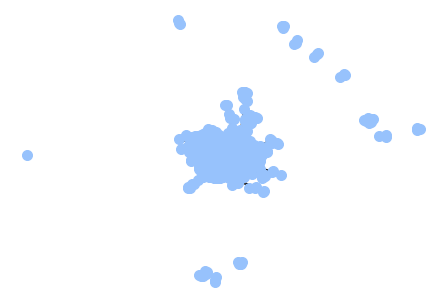

In [19]:
G_prova = nx.Graph()
G_prova.add_edges_from(prova)
nx.draw(G_prova, node_color='#97C2FC', node_size=100, edge_color='black', node_shape='o')

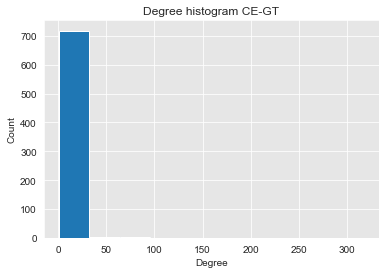

In [20]:
plot_degree_dist(G_prova)
plt.title("Degree histogram CE-GT")
plt.savefig("histC4G3ris.png")

In [21]:
ba_net_cc = nx.average_clustering(G_prova)
print('Grafo 3 network average cluster coefficient: ' + str(ba_net_cc) + '\n')

ba_net_cc = nx.density(G_prova)
print("Grafo 3: "+str(ba_net_cc))

Grafo 3 network average cluster coefficient: 0.48019010202480145

Grafo 3: 0.006003609765365251


## Rete 3 inversa

In [29]:
m3 = multicoll(G3, motif)
m3

[{(0, '0'): (1, '0'),
  (0, '1'): (1, '0'),
  (0, '10'): (0, '10'),
  (0, '100'): (0, '100'),
  (0, '101'): (0, '101'),
  (0, '102'): (0, '102'),
  (0, '103'): (0, '103'),
  (0, '104'): (0, '104'),
  (0, '105'): (0, '105'),
  (0, '106'): (0, '106'),
  (0, '107'): (0, '107'),
  (0, '108'): (0, '108'),
  (0, '109'): (0, '109'),
  (0, '11'): (0, '11'),
  (0, '110'): (0, '110'),
  (0, '111'): (0, '111'),
  (0, '112'): (0, '112'),
  (0, '113'): (0, '113'),
  (0, '114'): (0, '114'),
  (0, '115'): (0, '115'),
  (0, '116'): (0, '116'),
  (0, '117'): (0, '117'),
  (0, '118'): (0, '118'),
  (0, '119'): (0, '119'),
  (0, '12'): (0, '12'),
  (0, '120'): (0, '120'),
  (0, '121'): (0, '121'),
  (0, '122'): (0, '122'),
  (0, '123'): (0, '123'),
  (0, '124'): (0, '124'),
  (0, '125'): (0, '125'),
  (0, '126'): (0, '126'),
  (0, '127'): (0, '127'),
  (0, '128'): (0, '128'),
  (0, '129'): (0, '129'),
  (0, '13'): (0, '13'),
  (0, '130'): (0, '130'),
  (0, '131'): (0, '131'),
  (0, '132'): (0, '132'),
  

In [30]:


mapping3 = memo(m3, 3)



In [31]:
G3_finale = [(1, '0'), (10, '10'), (2, '105'), (1, '107'), (4, '110'), (2, '111'), (2, '114'), (6, '116'), (1, '123'), (0, '125'), (2, '126'), (0, '131'), (0, '133'), (0, '134'), (0, '135'), (4, '136'), (0, '137'), (1, '139'), (1, '141'), (0, '146'), (0, '147'), (1, '152'), (2, '153'), (2, '155'), (1, '158'), (3, '161'), (0, '165'), (4, '166'), (0, '167'), (3, '169'), (0, '171'), (1, '172'), (0, '173'), (0, '174'), (1, '177'), (0, '181'), (2, '183'), (1, '190'), (1, '192'), (1, '196'), (0, '197'), (0, '198'), (0, '201'), (1, '202'), (0, '208'), (1, '211'), (1, '215'), (3, '225'), (0, '232'), (1, '24'), (1, '240'), (1, '242'), (1, '247'), (1, '250'), (1, '258'), (0, '264'), (0, '275'), (0, '278'), (0, '279'), (0, '280'), (0, '282'), (0, '283'), (0, '284'), (0, '285'), (0, '286'), (0, '287'), (0, '288'), (0, '291'), (0, '292'), (0, '294'), (0, '295'), (0, '296'), (0, '297'), (1, '298'), (0, '299'), (0, '3'), (0, '30'), (0, '300'), (0, '301'), (0, '302'), (0, '303'), (0, '304'), (0, '305'), (0, '307'), (0, '308'), (0, '309'), (0, '310'), (0, '311'), (0, '312'), (0, '313'), (0, '314'), (0, '315'), (0, '316'), (0, '318'), (0, '319'), (0, '32'), (0, '320'), (0, '321'), (0, '322'), (0, '323'), (0, '324'), (0, '325'), (0, '326'), (0, '327'), (0, '328'), (0, '329'), (0, '330'), (0, '331'), (0, '332'), (0, '333'), (0, '334'), (0, '335'), (0, '336'), (0, '337'), (0, '338'), (0, '339'), (0, '340'), (0, '341'), (0, '342'), (0, '343'), (0, '344'), (0, '345'), (0, '346'), (0, '347'), (0, '348'), (0, '349'), (0, '35'), (0, '350'), (0, '351'), (0, '352'), (0, '353'), (0, '355'), (0, '356'), (0, '357'), (0, '358'), (0, '360'), (0, '361'), (0, '362'), (0, '363'), (0, '364'), (0, '365'), (0, '366'), (0, '367'), (0, '368'), (0, '369'), (0, '370'), (0, '371'), (0, '372'), (0, '373'), (0, '374'), (0, '375'), (0, '376'), (0, '377'), (0, '378'), (0, '379'), (0, '38'), (0, '380'), (0, '381'), (0, '382'), (0, '383'), (0, '384'), (0, '385'), (0, '386'), (0, '387'), (0, '388'), (0, '389'), (0, '390'), (0, '391'), (0, '392'), (0, '393'), (0, '394'), (0, '395'), (0, '396'), (0, '397'), (0, '398'), (0, '399'), (0, '4'), (0, '400'), (0, '401'), (0, '402'), (0, '404'), (0, '405'), (0, '406'), (0, '407'), (0, '408'), (0, '410'), (0, '411'), (0, '412'), (0, '413'), (0, '414'), (0, '415'), (0, '416'), (0, '417'), (0, '419'), (0, '42'), (0, '420'), (0, '421'), (0, '422'), (0, '423'), (0, '424'), (0, '425'), (0, '426'), (0, '427'), (0, '428'), (0, '429'), (0, '430'), (0, '431'), (0, '432'), (0, '433'), (0, '435'), (0, '436'), (0, '438'), (0, '439'), (0, '440'), (0, '441'), (0, '442'), (0, '443'), (0, '444'), (0, '445'), (0, '446'), (0, '447'), (0, '448'), (0, '449'), (0, '45'), (0, '450'), (0, '451'), (0, '452'), (0, '453'), (0, '454'), (0, '455'), (0, '457'), (0, '458'), (0, '459'), (0, '460'), (0, '461'), (0, '462'), (0, '464'), (0, '465'), (0, '466'), (0, '467'), (0, '468'), (0, '469'), (0, '470'), (0, '471'), (0, '472'), (0, '473'), (0, '474'), (0, '475'), (0, '476'), (0, '477'), (0, '478'), (0, '479'), (0, '480'), (0, '481'), (0, '482'), (0, '483'), (0, '484'), (0, '485'), (0, '486'), (0, '487'), (0, '488'), (0, '489'), (0, '49'), (0, '490'), (0, '491'), (0, '492'), (0, '493'), (0, '494'), (0, '495'), (0, '496'), (0, '497'), (0, '498'), (0, '499'), (0, '500'), (0, '502'), (0, '503'), (0, '504'), (0, '505'), (0, '506'), (0, '507'), (0, '508'), (0, '509'), (0, '510'), (0, '511'), (0, '512'), (0, '513'), (0, '514'), (0, '515'), (0, '516'), (0, '517'), (0, '518'), (0, '519'), (0, '52'), (0, '520'), (0, '521'), (0, '522'), (0, '523'), (0, '524'), (0, '525'), (0, '526'), (0, '527'), (0, '528'), (0, '529'), (0, '530'), (0, '531'), (0, '532'), (0, '533'), (0, '534'), (0, '535'), (0, '536'), (0, '537'), (0, '538'), (0, '539'), (0, '540'), (0, '541'), (0, '542'), (0, '543'), (0, '544'), (0, '545'), (0, '548'), (0, '549'), (0, '55'), (0, '550'), (0, '551'), (0, '552'), (0, '553'), (0, '554'), (0, '555'), (0, '556'), (0, '557'), (0, '558'), (0, '559'), (0, '56'), (0, '560'), (0, '561'), (0, '562'), (0, '563'), (0, '564'), (0, '565'), (0, '566'), (0, '567'), (0, '568'), (0, '57'), (0, '570'), (0, '571'), (0, '572'), (0, '573'), (0, '574'), (0, '575'), (0, '576'), (0, '577'), (0, '578'), (0, '579'), (0, '58'), (0, '580'), (0, '581'), (0, '582'), (0, '583'), (0, '584'), (0, '585'), (0, '586'), (0, '587'), (0, '588'), (0, '589'), (0, '59'), (0, '590'), (0, '591'), (0, '592'), (0, '593'), (0, '594'), (0, '595'), (0, '596'), (0, '597'), (0, '599'), (0, '6'), (0, '60'), (0, '600'), (0, '601'), (0, '602'), (0, '603'), (0, '604'), (0, '605'), (0, '606'), (0, '607'), (0, '608'), (0, '609'), (0, '61'), (0, '610'), (0, '611'), (0, '612'), (0, '613'), (0, '614'), (0, '615'), (0, '616'), (0, '617'), (0, '618'), (0, '619'), (0, '62'), (0, '620'), (0, '621'), (0, '622'), (0, '624'), (0, '625'), (0, '626'), (0, '629'), (0, '63'), (0, '630'), (0, '631'), (0, '633'), (0, '634'), (0, '635'), (0, '636'), (0, '637'), (0, '638'), (0, '639'), (0, '64'), (0, '640'), (0, '641'), (0, '642'), (0, '643'), (0, '644'), (0, '645'), (0, '646'), (0, '648'), (0, '649'), (0, '650'), (0, '651'), (0, '652'), (0, '653'), (0, '654'), (0, '655'), (0, '656'), (0, '657'), (0, '658'), (0, '659'), (0, '66'), (0, '660'), (0, '661'), (0, '662'), (0, '663'), (0, '664'), (0, '665'), (0, '666'), (0, '667'), (0, '668'), (0, '669'), (0, '67'), (0, '670'), (0, '671'), (0, '672'), (0, '673'), (0, '674'), (0, '675'), (0, '676'), (0, '677'), (0, '678'), (0, '679'), (0, '68'), (0, '680'), (0, '682'), (0, '683'), (0, '684'), (0, '685'), (0, '686'), (0, '687'), (0, '688'), (0, '689'), (0, '69'), (0, '690'), (0, '691'), (0, '692'), (0, '693'), (0, '694'), (0, '695'), (0, '696'), (0, '697'), (0, '698'), (0, '699'), (0, '700'), (0, '701'), (0, '702'), (0, '703'), (0, '704'), (0, '705'), (0, '706'), (0, '707'), (0, '708'), (0, '709'), (0, '71'), (0, '710'), (0, '711'), (0, '712'), (0, '713'), (0, '714'), (0, '715'), (0, '716'), (0, '717'), (0, '718'), (0, '719'), (0, '72'), (0, '720'), (0, '721'), (0, '722'), (0, '723'), (0, '724'), (0, '725'), (0, '726'), (0, '727'), (0, '728'), (0, '729'), (0, '73'), (0, '730'), (0, '731'), (0, '732'), (0, '733'), (0, '734'), (0, '735'), (0, '736'), (0, '737'), (0, '738'), (0, '739'), (0, '740'), (0, '741'), (0, '742'), (0, '743'), (0, '744'), (0, '745'), (0, '746'), (0, '747'), (0, '748'), (0, '749'), (0, '75'), (0, '750'), (0, '751'), (0, '752'), (0, '753'), (0, '754'), (0, '755'), (0, '756'), (0, '757'), (0, '758'), (0, '759'), (0, '76'), (0, '760'), (0, '761'), (0, '762'), (0, '763'), (0, '764'), (0, '765'), (0, '766'), (0, '767'), (0, '768'), (0, '769'), (0, '77'), (0, '770'), (0, '771'), (0, '772'), (0, '773'), (0, '774'), (0, '775'), (0, '776'), (0, '777'), (0, '778'), (0, '779'), (0, '780'), (0, '781'), (0, '782'), (0, '783'), (0, '784'), (0, '785'), (0, '786'), (0, '787'), (0, '788'), (0, '789'), (0, '790'), (0, '791'), (0, '792'), (0, '793'), (0, '794'), (0, '795'), (0, '796'), (0, '797'), (0, '798'), (0, '799'), (0, '80'), (0, '800'), (0, '801'), (0, '802'), (0, '803'), (0, '804'), (0, '805'), (0, '806'), (0, '807'), (0, '808'), (0, '809'), (0, '81'), (0, '810'), (0, '811'), (0, '812'), (0, '813'), (0, '814'), (0, '815'), (0, '816'), (0, '817'), (0, '818'), (0, '819'), (0, '82'), (0, '820'), (0, '821'), (0, '822'), (0, '823'), (0, '824'), (0, '825'), (0, '826'), (0, '827'), (0, '828'), (0, '829'), (0, '83'), (0, '830'), (0, '831'), (0, '832'), (0, '833'), (0, '834'), (0, '835'), (0, '836'), (0, '837'), (0, '838'), (0, '839'), (0, '84'), (0, '840'), (0, '841'), (0, '842'), (0, '843'), (0, '844'), (0, '845'), (0, '846'), (0, '847'), (0, '848'), (0, '849'), (0, '85'), (0, '850'), (0, '851'), (0, '852'), (0, '853'), (0, '854'), (0, '855'), (0, '856'), (0, '857'), (0, '858'), (0, '859'), (0, '86'), (0, '860'), (0, '861'), (0, '862'), (0, '863'), (0, '864'), (0, '865'), (0, '866'), (0, '867'), (0, '868'), (0, '869'), (0, '870'), (0, '871'), (0, '872'), (0, '873'), (0, '874'), (0, '875'), (0, '876'), (0, '877'), (0, '878'), (0, '879'), (0, '88'), (0, '880'), (0, '881'), (0, '882'), (0, '883'), (0, '884'), (0, '885'), (0, '886'), (0, '887'), (0, '888'), (0, '889'), (0, '89'), (0, '890'), (0, '891'), (0, '892'), (0, '893'), (0, '894'), (0, '895'), (0, '896'), (0, '897'), (0, '898'), (0, '899'), (0, '9'), (0, '90'), (0, '900'), (0, '901'), (0, '902'), (0, '903'), (0, '904'), (0, '905'), (0, '906'), (0, '907'), (0, '908'), (0, '909'), (0, '91'), (0, '910'), (0, '911'), (0, '912'), (0, '913'), (0, '914'), (0, '915'), (0, '916'), (0, '917'), (0, '918'), (0, '919'), (0, '92'), (0, '920'), (0, '921'), (0, '922'), (0, '923'), (0, '93'), (0, '94'), (0, '96'), (0, '97'), (0, '98')]

In [32]:
G3_INV = inverti(G3_finale, mapping3)

KeyError: (7, '10')

In [ ]:
nx.draw(G3_INV, node_color='#97C2FC', node_size=150, edge_color='black', node_shape='o')

### Procedura frattale

[torna su](#Indice)

Comprimi **solo se** il livello è uguale all'interno del motif

si potrebbe trovare una legge di multipli per sapere già i nodi comprimibili (?)

compressione di strutture di nodi indipendenti

all'iterazione successiva comprimo su ciò che è già stato compresso

In [ ]:
motif = nx.Graph()
motif.add_edges_from([(1, 2), (2, 3), (3, 1)])
# nx.draw(motif)

In [ ]:
filename = 'bn-mouse_visual-cortex_2.edges'
G = nx.read_edgelist(filename)

nx.draw_networkx(G, with_labels=False)
plt.axis('off')
plt.show()

In [ ]:
G = rinomina(G0)

In [ ]:
G0 = nx.Graph()
G0.add_edges_from([(1, 2), (2, 3), (1, 3), (2, 4), (4, 5), (5, 6), (4, 6),
                   (6, 8), (7, 8), (7, 9), (8, 9), (3, 7), (5, 14), (14, 10),
                   (14, 13), (10, 11), (11, 12), (10, 12), (12, 13)])
nx.draw(G0)

G = rinomina(G0)

In [ ]:
def all_equal(iterator):
    iterator = [x[0] for x in iterator]
    return len(set(iterator)) <= 1

In [ ]:
def frattale(G, motif):
    n, a = [], []
    # nodi G
    nodi = list(G.nodes())
    nodi.sort(key=lambda x:x[1])
    archi = list(G.edges())
    n.append(nodi)
    a.append(archi)
    #ris = identify(motif, G)
    liv = 0
    while liv < 100:
        ris = identify(motif, G)
        if ris == []:
            break
            
        ris = identify(motif, G)
        print(nodi, "\n\n", ris, "\n\n")
        for i in ris:
            print(i, all_equal(i))
            if all_equal(i) == True:
                mapping = zippa(ris, nodi)
                G = nx.relabel_nodes(G, mapping)
                print(mapping)
            ris = ris[1:]
            nodi = list(G.nodes())
            nodi.sort(key=lambda x:x[1])
            archi = list(G.edges())
            n.append(nodi)
            a.append(archi)
            liv+=1
            print(n)
            
    tot = list(zip(n, a))
    tup = ()
    lista = []
    for x in tot:
        max_liv = max(x[0], key=itemgetter(0))[0]
        l = len(x[0])
        tup = (max_liv, l, x[0], x[1])
        lista.append(tup)

    d = defaultdict(list)
    for name, num, nod, arc in lista:
        d[name].append((num, nod, arc))
            
    res = list(zip(d, map(min, d.values())))
    
    return res



In [ ]:
risultato = frattale(G2, motif)

In [ ]:
risultato = frattale(G, motif)

In [ ]:
res = frattale(G2, motif)
livello, num_nodi, nodi, archi = [], [], [], []
for i in res:
    livello.append(i[0])
    num_nodi.append(i[1][0])
    nodi.append(i[1][1])
    archi.append(i[1][2])

print("Livello: ", livello, "\n# nodi: ", num_nodi,
      "\nNodi: ", nodi, "\nArchi: ", archi, "\n\n")

In [ ]:
nodi

In [ ]:
for i in archi:
    print(i)
    GG = nx.Graph()
    GG.add_edges_from(i)
    plt.clf()
    nx.draw(GG)
    plt.pause(1)
    plt.show()

In [ ]:
risultato

In [ ]:
    if ris == []:
            print("fine")
            return
    while all_equal(ris[0]) == True:
        
        if all_equal(ris[0]) == False:
            #print("AOOOOO")
            ris = ris[1:]
            
        else: #if all_equal(ris[0]) == True:
            print(ris[0], all_equal(ris[0]))
            #if all_equal(ris[0]) == True:
                
            
            G = nx.relabel_nodes(G, mapping)
            # togli triangolo usato
            # la lista ris diminuisce
            ris = ris[1:]                
            # i nodi cambiano, sono il risultato della compressione
            nodi = list(G.nodes())
            nodi.sort(key=lambda x:x[1])
            archi = list(G.edges())
            n.append(nodi)
            a.append(archi)
            liv += 1
            #print(liv)
            
            """
    ris = identify(motif, G)
    print("\n\n", nodi, "\n\n", ris, "\n\n")
    for i in ris:
        print(i, all_equal(i))
        if all_equal(i) == True:
            print("yee")
            mapping = zippa(ris, nodi)
            G = nx.relabel_nodes(G, mapping)
            print(mapping)
        ris = ris[1:]
        nodi = list(G.nodes())
        nodi.sort(key=lambda x:x[1])
        archi = list(G.edges())
        n.append(nodi)
        a.append(archi)
        print(n)"""
    
    #return ris
            
    tot = list(zip(n, a))
    tup = ()
    lista = []
    for x in tot:
        max_liv = max(x[0], key=itemgetter(0))[0]
        l = len(x[0])
        tup = (max_liv, l, x[0], x[1])
        lista.append(tup)

    d = defaultdict(list)
    for name, num, nod, arc in lista:
        d[name].append((num, nod, arc))
            
    res = list(zip(d, map(min, d.values())))
    
    return res
risultato = frattale(G, motif)

In [ ]:
res = risultato

In [ ]:
res = frattale(G, motif)
livello, num_nodi, nodi, archi = [], [], [], []
for i in res:
    livello.append(i[0])
    num_nodi.append(i[1][0])
    nodi.append(i[1][1])
    archi.append(i[1][2])

print("Livello: ", livello, "\n# nodi: ", num_nodi,
      "\nNodi: ", nodi, "\nArchi: ", archi, "\n\n")

In [ ]:
nodi

In [ ]:
for i in archi:
    print(i)
    GG = nx.Graph()
    GG.add_edges_from(i)
    plt.clf()
    nx.draw(GG)
    plt.pause(1)
    plt.show()

---
### Memorizza merge
[torna su](#Indice)

Memorizza merge, per poter ricostruire inversamente

Ora funziona con il primo mapping, da rendere iterabile

In [ ]:
nodi = list(G.nodes())
nodi.sort(key=lambda x:x[1])
ris = identify(motif, G)
mapping = zippa(ris, nodi)
m = zippa(ris, nodi)

In [ ]:
# Memorizza [(0, 1), (0, 7), (0, 8)] = (1, 1)
m

In [ ]:
def memo(mapping, n):
    value_occurrences = collections.Counter(mapping.values())
    filtered_dict = {key: value for key, value in mapping.items()
                     if value_occurrences[value] == n}
    new_list = []
    for i, j in filtered_dict.items():
        j = list(j)
        j = i
        j = tuple(j)
        new_list.append(j)
    a = [i for i in new_list[0]]
    a[0] = a[0]+1
    a = tuple(a)
    thisdict = {a: new_list}
    return thisdict

# n fisso a 3 perché graphlet di 3 nodi
memo(m, 3)

***

### Indici
[torna su](#Indice)

**Nodi compressi e nodi mantenuti, count e %**

In [ ]:
def nodes_decrease(num_nodi):
    decrease = num_nodi[0] - num_nodi[-1]
    # % decrease = decrease ÷ grafo_0 × 100
    decrease_perc = decrease / num_nodi[0] * 100
    # remain = grafo_fin
    remain = num_nodi[-1]
    # remain_perc inverso di decrease_perc
    remain_perc = 100 - decrease_perc
    #remain_perc2 = len(grafo_fin) / len(grafo_0) * 100

    return (decrease, decrease_perc, remain, remain_perc)

nodes_decrease(num_nodi)

#### Statistiche per livello

In [ ]:
for i in res:
    print("Livello: ", i[0], "\n# nodi: ", i[1][0], "\nNodi: ",
          i[1][1], "\nArchi: ", i[1][2], "\n\n")